# 1) Lựa chọn dataset và chuẩn bị

**link dataset**: https://archive.ics.uci.edu/dataset/186/wine+quality

Bộ dữ liệu này gồm 2 tệp:

  - **winequality-red.csv**
  
  - **winequality-white.csv**

## Import các thư viện cần thiết

In [ ]:
import pandas as pd
import chardet
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import skew, zscore, shapiro, kstest, anderson, chi2_contingency, fisher_exact, stats
from typing import List, Dict, Optional, Tuple, Any

## Tải và gộp dữ liệu

Nhóm em chọn 2 tập data: (tổng dòng và cột của 2 tập này lần lượt là **6497** và **12**, đáp ứng với trong đề) nhưng do kết hợp 2 dataset lại nên phát sinh thêm cột **"type"** để phân biệt 2 loại rượu với nhau nên tổng kết lại là có **6497** dòng và **13** cột

- **winequality-red.csv**

- **winequality-white.csv**


In [ ]:
# Đường dẫn đến các tệp dữ liệu
red_wine_path: str = '/content/winequality-red.csv'
white_wine_path: str = '/content/winequality-white.csv'

# Các tệp CSV gốc sử dụng dấu chấm phẩy (;) làm dấu phân cách
red_df: pd.DataFrame = pd.read_csv(red_wine_path, sep=';')
white_df: pd.DataFrame = pd.read_csv(white_wine_path, sep=';')

# Thêm cột 'type' để phân biệt loại rượu
red_df['type'] = 'red'
white_df['type'] = 'white'

# Gộp dữ liệu
full_data: pd.DataFrame = pd.concat([red_df, white_df], ignore_index=True)
# Kiểm tra số dòng và cột
print(full_data.shape)

# Lưu thành tệp CSV mới
full_data.to_csv('/content/full_data-wine_quality.csv', index=False, encoding='utf-8')

full_data

(6497, 13)


,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,type
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5,red
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.99680,3.20,0.68,9.8,5,red
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.99700,3.26,0.65,9.8,5,red
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.99800,3.16,0.58,9.8,6,red
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5,red
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6492,6.2,0.21,0.29,1.6,0.039,24.0,92.0,0.99114,3.27,0.50,11.2,6,white
6493,6.6,0.32,0.36,8.0,0.047,57.0,168.0,0.99490,3.15,0.46,9.6,5,white
6494,6.5,0.24,0.19,1.2,0.041,30.0,111.0,0.99254,2.99,0.46,9.4,6,white
6495,5.5,0.29,0.30,1.1,0.022,20.0,110.0,0.98869,3.34,0.38,12.8,7,white


In [ ]:
data: pd.DataFrame = pd.read_csv('/content/full_data-wine_quality.csv', encoding='utf-8')

# 2) Khám phá dữ liệu (Exploratory Data Analysis - EDA)


## a) Tóm tắt thông tin dữ liệu

### Mô tả các thuộc tính

- **fixed acidity**: Axit cố định ($g/dm^3$) - chủ yếu là axit tartaric, malic.

- **volatile acidity**: Axit dễ bay hơi ($g/dm^3$) - chủ yếu là axit acetic, gây mùi giấm.

- **citric acid**: Axit citric ($g/dm^3$) - tạo vị tươi mát.

- **residual sugar**: Đường tồn dư ($g/dm^3$) - lượng đường còn lại sau khi lên men kết thúc.

- **chlorides**: Clorua ($g/dm^3$) - lượng muối trong rượu.

- **free sulfur dioxide**: SO2 tự do ($mg/dm^3$) - chất bảo quản, chống oxy hóa.

- **total sulfur dioxide**: Tổng SO2 ($mg/dm^3$) - tổng lượng SO2 tự do và liên kết.

- **density**: Tỷ trọng ($g/cm^3$) - tỷ lệ khối lượng so với thể tích, liên quan đến độ cồn và đường.

- **pH**: Độ pH - thang đo độ axit/bazơ **(0-14)**.

- **sulphates**: Sunfat ($g/dm^3$) - chất phụ gia, góp phần vào SO2 và vị giác.

- **alcohol**: Độ cồn (% theo thể tích).

- **quality**: Chất lượng (**điểm từ 0 đến 10**) - biến mục tiêu, dựa trên đánh giá cảm quan.

- **type**: Loại rượu ('red' hoặc 'white') - biến do nhóm đã thêm vào.

### Kiểm tra số lượng bản ghi, số lượng biến số, kiểu dữ liệu

In [ ]:
# Kiểm tra lại kích thước dữ liệu
print(data.shape)

(6497, 13)


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6497 entries, 0 to 6496
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         6497 non-null   float64
 1   volatile acidity      6497 non-null   float64
 2   citric acid           6497 non-null   float64
 3   residual sugar        6497 non-null   float64
 4   chlorides             6497 non-null   float64
 5   free sulfur dioxide   6497 non-null   float64
 6   total sulfur dioxide  6497 non-null   float64
 7   density               6497 non-null   float64
 8   pH                    6497 non-null   float64
 9   sulphates             6497 non-null   float64
 10  alcohol               6497 non-null   float64
 11  quality               6497 non-null   int64  
 12  type                  6497 non-null   object 
dtypes: float64(11), int64(1), object(1)
memory usage: 660.0+ KB


In [ ]:
data.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,type
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5,red
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5,red
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5,red
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6,red
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5,red


In [ ]:
data.tail()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,type
6492,6.2,0.21,0.29,1.6,0.039,24.0,92.0,0.99114,3.27,0.50,11.2,6,white
6493,6.6,0.32,0.36,8.0,0.047,57.0,168.0,0.99490,3.15,0.46,9.6,5,white
6494,6.5,0.24,0.19,1.2,0.041,30.0,111.0,0.99254,2.99,0.46,9.4,6,white
6495,5.5,0.29,0.30,1.1,0.022,20.0,110.0,0.98869,3.34,0.38,12.8,7,white
6496,6.0,0.21,0.38,0.8,0.020,22.0,98.0,0.98941,3.26,0.32,11.8,6,white


In [ ]:
data.shape

(6497, 13)

In [ ]:
# Xác định các cột số và cột phân loại
all_cols: List[str] = data.columns.tolist()
categorical_features: List[str] = ['type'] # Chỉ có cột 'type' là phân loại rõ ràng ban đầu
numeric_features: List[str] = [col for col in all_cols if col not in categorical_features]

In [ ]:
print(f"\nCác cột số (numerical): {numeric_features}")
print(f"Các cột phân loại (categorical): {categorical_features}")



Các cột số (numerical): ['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol', 'quality']
Các cột phân loại (categorical): ['type']


### Kiểm tra dữ liệu thiếu

In [ ]:
# Kiểm tra dữ liệu thiếu
missing_data: pd.Series = data.isnull().sum()
print("Dữ liệu thiếu:\n", missing_data)

Dữ liệu thiếu:
 fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
type                    0
dtype: int64


In [ ]:
print(data.isnull().sum().sum())


0


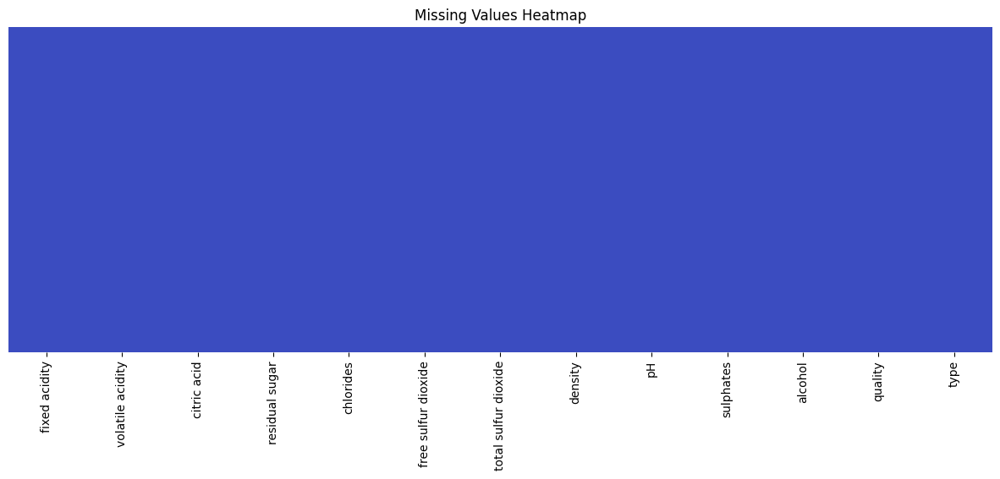

In [ ]:
# heatmap of the missing values
plt.figure(figsize=(15 , 5))
sns.heatmap(data.isna(), cbar=False , yticklabels=False, cmap='coolwarm')
plt.title('Missing Values Heatmap')
plt.show()

### Kiểm tra và loại bỏ dữ liệu trùng lặp

In [ ]:
# Kiểm tra dữ liệu trùng lặp
duplicates: int = data.duplicated().sum()
print(f"Số bản ghi trùng lặp: {duplicates}")

Số bản ghi trùng lặp: 1177


In [ ]:
# Bỏ đi các giá trị tùng lặp
data.drop_duplicates(inplace=True)
print(f"Số lượng bản ghi sau khi loại trùng lặp: {data.shape[0]}")


Số lượng bản ghi sau khi loại trùng lặp: 5320


In [ ]:
# Kiểm tra dữ liệu trùng lặp
duplicates: int = data.duplicated().sum()
print(f"Số bản ghi trùng lặp: {duplicates}")

Số bản ghi trùng lặp: 0


## b) Phân tích thống kê mô tả

In [ ]:
print(data.describe())

       fixed acidity  volatile acidity  citric acid  residual sugar  \
count    5320.000000       5320.000000  5320.000000     5320.000000   
mean        7.215179          0.344130     0.318494        5.048477   
std         1.319671          0.168248     0.147157        4.500180   
min         3.800000          0.080000     0.000000        0.600000   
25%         6.400000          0.230000     0.240000        1.800000   
50%         7.000000          0.300000     0.310000        2.700000   
75%         7.700000          0.410000     0.400000        7.500000   
max        15.900000          1.580000     1.660000       65.800000   

         chlorides  free sulfur dioxide  total sulfur dioxide      density  \
count  5320.000000          5320.000000           5320.000000  5320.000000   
mean      0.056690            30.036654            114.109023     0.994535   
std       0.036863            17.805045             56.774223     0.002966   
min       0.009000             1.000000         

In [ ]:
print(data[data['type'] == 'red'].describe().round(2))

       fixed acidity  volatile acidity  citric acid  residual sugar  \
count        1359.00           1359.00      1359.00         1359.00   
mean            8.31              0.53         0.27            2.52   
std             1.74              0.18         0.20            1.35   
min             4.60              0.12         0.00            0.90   
25%             7.10              0.39         0.09            1.90   
50%             7.90              0.52         0.26            2.20   
75%             9.20              0.64         0.43            2.60   
max            15.90              1.58         1.00           15.50   

       chlorides  free sulfur dioxide  total sulfur dioxide  density       pH  \
count    1359.00              1359.00               1359.00  1359.00  1359.00   
mean        0.09                15.89                 46.83     1.00     3.31   
std         0.05                10.45                 33.41     0.00     0.16   
min         0.01                 1.0

In [ ]:
print(data[data['type'] == 'white'].describe().round(2))

       fixed acidity  volatile acidity  citric acid  residual sugar  \
count        3961.00           3961.00      3961.00         3961.00   
mean            6.84              0.28         0.33            5.91   
std             0.87              0.10         0.12            4.86   
min             3.80              0.08         0.00            0.60   
25%             6.30              0.21         0.27            1.60   
50%             6.80              0.26         0.32            4.70   
75%             7.30              0.33         0.39            8.90   
max            14.20              1.10         1.66           65.80   

       chlorides  free sulfur dioxide  total sulfur dioxide  density       pH  \
count    3961.00              3961.00               3961.00  3961.00  3961.00   
mean        0.05                34.89                137.19     0.99     3.20   
std         0.02                17.21                 43.13     0.00     0.15   
min         0.01                 2.0

**1. Công thức tính Trung bình cộng (Mean):**

$\Large \bar{x} = \frac{\sum_{i=1}^{n} x_i}{n}$

  - Trong đó:
    
    - $\bar{x} $: là giá trị trung bình cộng của mẫu.

    - $x_i$: là giá trị của quan sát thứ i.

    - n: là tổng số quan sát trong mẫu.


**2. Công thức tính Độ lệch chuẩn mẫu (Sample Standard Deviation):**

$\Large s = \sqrt{\frac{\sum_{i=1}^{n} (x_i - \bar{x})^2}{n-1}}$

  - Trong đó:

    - s: là độ lệch chuẩn của mẫu (đo lường mức độ phân tán của dữ liệu quanh trung bình).

    - $x_i$: là giá trị của quan sát thứ i.

    - $\bar{x} $: là giá trị trung bình cộng của mẫu.

    - n: là tổng số quan sát trong mẫu.

**3. Cách xác định Trung vị (Median):**

- Median là giá trị nằm ở vị trí chính giữa của tập dữ liệu sau khi đã được sắp xếp theo thứ tự từ nhỏ đến lớn.

  1. Sắp xếp dữ liệu: $ x_{(1)}, x_{(2)}, ..., x_{(i)} $

  2. Nếu n (số lượng quan sát) là **số lẻ**, Median là giá trị ở vị trí thứ $\frac{n+1}{2}$

  3. Nếu n là **số chẵn**, Median là trung bình cộng của hai giá trị ở vị trí thứ $\frac{n}{2} và \frac{n}{2} + 1$


### Trực quan hóa dữ liệu (Cần ít nhất 3 loại biểu đồ)

#### Biểu đồ Boxplot (Phát hiện ngoại lai) RIÊNG BIỆT THEO LOẠI RƯỢU

Boxplot: Dùng để phát hiện giá trị ngoại lai và xem phân bố tổng quát của biến số.



#### Biểu đồ Boxplot (So sánh giữa 2 loại rượu) ####

--- Thống kê mô tả và Outlier (IQR) RIÊNG cho từng loại rượu ---

===== Phân tích cột: fixed acidity =====

--- Red Wine ---
Thống kê mô tả:
count    1359.000000
mean        8.310596
std         1.736990
min         4.600000
25%         7.100000
50%         7.900000
75%         9.200000
max        15.900000
Name: fixed acidity, dtype: float64

Outliers (theo IQR của nhóm red):
  Ngưỡng dưới: 3.95
  Ngưỡng trên: 12.35
  Số lượng outliers trong nhóm red: 41

--- White Wine ---
Thống kê mô tả:
count    3961.000000
mean        6.839346
std         0.866860
min         3.800000
25%         6.300000
50%         6.800000
75%         7.300000
max        14.200000
Name: fixed acidity, dtype: float64

Outliers (theo IQR của nhóm white):
  Ngưỡng dưới: 4.80
  Ngưỡng trên: 8.80
  Số lượng outliers trong nhóm white: 106

===== Phân tích cột: volatile acidity =====

--- Red Wine ---
Thống kê mô tả:
count    1359.000000
mean        0.529478
std  

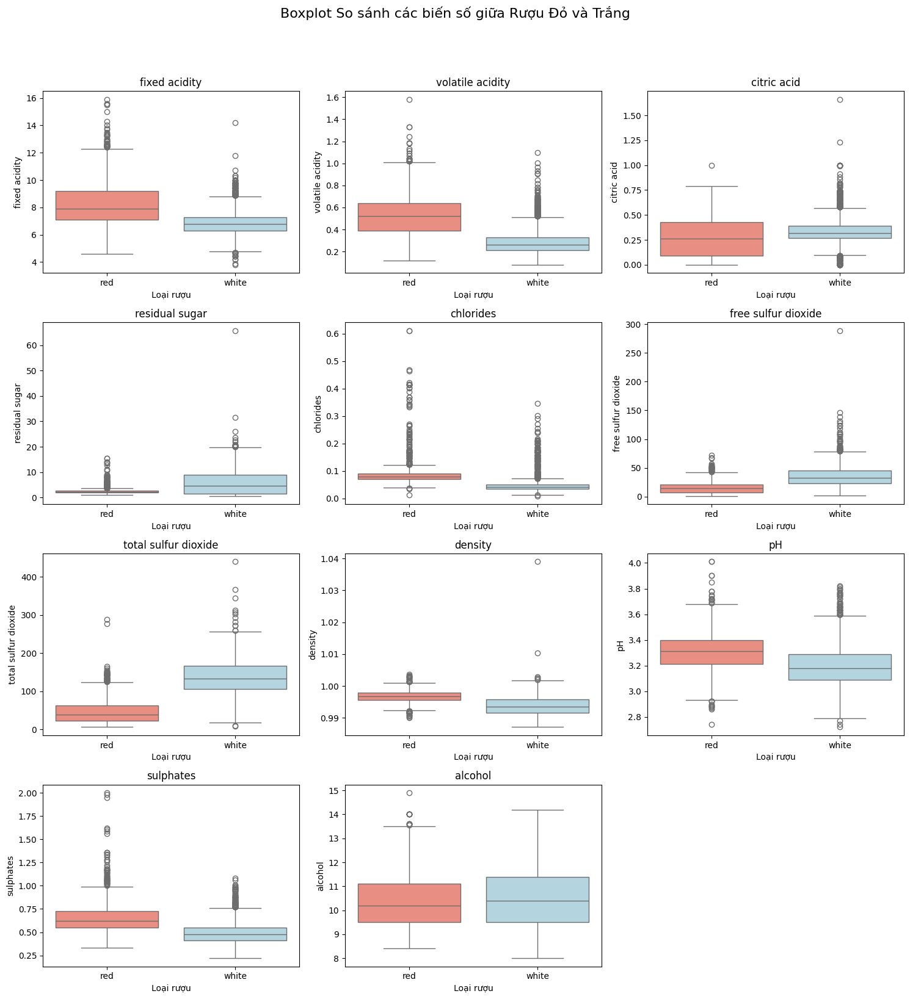

In [ ]:
print("\n#### Biểu đồ Boxplot (So sánh giữa 2 loại rượu) ####")

numeric_features: List[str] = data.select_dtypes(include=np.number).columns.tolist()
numeric_features_for_plot: List[str] = [col for col in numeric_features if col != 'quality']

num_plots: int = len(numeric_features_for_plot)
rows: int = int(np.ceil(num_plots / 3))

# --- Phần Tính toán và In Thống kê Mô tả/Outlier RIÊNG cho từng loại rượu ---
print("\n--- Thống kê mô tả và Outlier (IQR) RIÊNG cho từng loại rượu ---")
for col in numeric_features_for_plot:
    print(f"\n===== Phân tích cột: {col} =====")
    for wine_type in ['red', 'white']:
        # Lọc dữ liệu cho loại rượu hiện tại và cột hiện tại, bỏ NaN
        current_data_col = data.loc[data['type'] == wine_type, col].dropna()

        if current_data_col.empty:
            print(f"\n--- {wine_type.capitalize()} Wine ---")
            print(f"Không có dữ liệu hợp lệ cho {col}.")
            continue

        print(f"\n--- {wine_type.capitalize()} Wine ---")
        desc = current_data_col.describe()
        print(f"Thống kê mô tả:")
        print(desc)

        # Tính toán Outlier dựa trên IQR của nhóm này
        try:
            Q1 = current_data_col.quantile(0.25)
            Q3 = current_data_col.quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR

            # Đếm outliers chỉ trong nhóm này
            outliers_mask_group = (current_data_col < lower_bound) | (current_data_col > upper_bound)
            num_outliers = outliers_mask_group.sum()

            print(f"\nOutliers (theo IQR của nhóm {wine_type}):")
            print(f"  Ngưỡng dưới: {lower_bound:.2f}")
            print(f"  Ngưỡng trên: {upper_bound:.2f}")
            print(f"  Số lượng outliers trong nhóm {wine_type}: {num_outliers}")
        except Exception as e:
            print(f"Lỗi khi tính outlier cho '{col}' ({wine_type}): {e}")

# --- Phần Vẽ Boxplot SO SÁNH giữa 2 loại rượu ---
print("\n\n--- Vẽ Boxplot So Sánh giữa Rượu Đỏ và Trắng ---")
plt.figure(figsize=(15, rows * 4))
plt.suptitle("Boxplot So sánh các biến số giữa Rượu Đỏ và Trắng", fontsize=16, y=1.02)

for i, col in enumerate(numeric_features_for_plot):
    plt.subplot(rows, 3, i + 1)
    # Vẽ boxplot với hue='type' để tuỳ chỉnh được palette mà không bị cảnh báo
    sns.boxplot(data=data, x='type', y=col, hue='type', palette={'red': 'salmon', 'white': 'lightblue'}, legend=False)
    plt.title(f"{col}")
    plt.xlabel("Loại rượu")
    plt.ylabel(col)

plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


1. Vì sao chọn biểu đồ Boxplot?
Boxplot (biểu đồ hộp) được chọn vì nó là công cụ trực quan mạnh mẽ để:

- Hiển thị phân bố dữ liệu: Cho thấy median (trung vị), phần giữa (IQR), và phạm vi của dữ liệu.

- Nhận diện outliers (giá trị ngoại lai): Dễ dàng thấy các điểm nằm ngoài “râu” của boxplot.

- So sánh nhiều biến liên tục cùng lúc: Giúp nhanh chóng nhìn ra biến nào phân bố lệch, biến nào có outliers nhiều, v.v.

Đây là lý do boxplot rất phổ biến trong phân tích dữ liệu khám phá (EDA - Exploratory Data Analysis).

2. Nhận xét và nhận diện xu hướng dữ liệu từ biểu đồ Boxplot (Trước khi xử lý dữ liệu)

- fixed acidity (Axit cố định):

  - Rượu đỏ: Phân bố hơi lệch phải nhẹ (Mean > Median). Có một số giá trị ngoại lai (outliers) được xác định ở cả phía thấp và cao (dựa trên IQR của nhóm đỏ).

  - Rượu trắng: Phân bố khá đối xứng (Mean ≈ Median). Cũng có các giá trị ngoại lai ở cả hai phía, đặc biệt là phía thấp (dựa trên IQR của nhóm trắng).

  - So sánh: Rượu đỏ có xu hướng axit cố định cao hơn rượu trắng.

- volatile acidity (Axit dễ bay hơi):

  - Rượu đỏ: Phân bố khá đối xứng (Mean ≈ Median). Dựa trên thống kê cung cấp và ngưỡng IQR của nhóm đỏ, không có outlier rõ rệt trong nhóm này sau một bước xử lý nào đó hoặc dải giá trị hẹp.

  - Rượu trắng: Phân bố lệch phải (Mean > Median). IQR rất hẹp, cho thấy phần lớn dữ liệu tập trung, nhưng có rất nhiều giá trị ngoại lai ở phía cao (dựa trên IQR của nhóm trắng).

  - So sánh: Rượu đỏ có độ axit dễ bay hơi cao hơn và biến động hơn (IQR lớn hơn) so với phần lớn rượu trắng, nhưng rượu trắng lại có một cái đuôi dài các giá trị cao bất thường.

- citric acid (Axit citric):

  - Rượu đỏ: Phân bố khá đối xứng (Mean ≈ Median), dải phân bố tứ phân vị (IQR) tương đối rộng so với trung vị. Không có outlier rõ rệt dựa trên thống kê cung cấp.

  - Rượu trắng: Phân bố khá đối xứng (Mean ≈ Median), nhưng IQR hẹp hơn rượu đỏ. Có các giá trị ngoại lai ở cả hai đầu (giá trị thấp gần 0 và giá trị cao > 0.58).

  - So sánh: Rượu trắng có mức axit citric trung bình cao hơn một chút và tập trung hơn, trong khi rượu đỏ có độ trải rộng hơn ở phần giữa.

- residual sugar (Đường tồn dư):

  - Rượu đỏ: Phân bố rất lệch phải (Mean >> Median), IQR rất hẹp. Có rất nhiều giá trị ngoại lai ở phía cao, cho thấy phần lớn rượu đỏ là khô (ít đường) nhưng có một số mẫu ngọt hơn đáng kể.

  - Rượu trắng: Phân bố lệch phải (Mean > Median), nhưng IQR rất rộng. Dựa trên thống kê cung cấp, không có outlier được xác định theo IQR của nhóm trắng (do IQR quá lớn).

  - So sánh: Rượu trắng có hàm lượng đường cao hơn và biến động hơn rất nhiều so với rượu đỏ.

- chlorides (Clorua):

  - Rượu đỏ: Phân bố khá đối xứng (Mean ≈ Median), IQR rất hẹp. Chỉ có một vài outlier (có thể ở phía thấp).

  - Rượu trắng: Phân bố khá đối xứng (Mean ≈ Median), IQR còn hẹp hơn rượu đỏ. Có nhiều giá trị ngoại lai ở phía cao.

  - So sánh: Rượu đỏ có nồng độ clorua cao hơn rượu trắng.

- free sulfur dioxide (SO2 tự do):

  - Rượu đỏ: Phân bố lệch phải nhẹ (Mean > Median). Có các giá trị ngoại lai ở phía cao.
  
  - Rượu trắng: Phân bố khá đối xứng (Mean ≈ Median), IQR rộng hơn rượu đỏ. Không có outlier dựa trên thống kê cung cấp.
  - So sánh: Rượu trắng có mức SO2 tự do cao hơn đáng kể so với rượu đỏ.

- total sulfur dioxide (Tổng SO2):

  - Rượu đỏ: Phân bố lệch phải (Mean > Median). Có nhiều giá trị ngoại lai ở phía cao.

  - Rượu trắng: Phân bố lệch phải nhẹ (Mean > Median), IQR rất rộng. Có một số ít giá trị ngoại lai ở phía cao.

  - So sánh: Rượu trắng có tổng SO2 cao hơn rất nhiều và biến động hơn so với rượu đỏ.

- density (Tỷ trọng):

  - Rượu đỏ: Phân bố rất đối xứng (Mean ≈ Median), IQR cực kỳ hẹp. Có các giá trị ngoại lai ở cả hai phía.

  - Rượu trắng: Phân bố lệch phải nhẹ (Mean > Median), IQR hẹp. Có một số ít giá trị ngoại lai (chủ yếu phía cao).
  
  - So sánh: Rượu đỏ có tỷ trọng trung bình cao hơn một chút so với rượu trắng.

- pH:

  - Rượu đỏ: Phân bố rất đối xứng (Mean ≈ Median), IQR hẹp. Có một số ít giá trị ngoại lai ở phía thấp.

  - Rượu trắng: Phân bố rất đối xứng (Mean ≈ Median), IQR hẹp. Có các giá trị ngoại lai ở cả hai phía.

  - So sánh: Rượu đỏ có độ pH trung bình cao hơn một chút (ít axit hơn) so với rượu trắng.

- sulphates (Sunfat):

  - Rượu đỏ: Phân bố lệch phải nhẹ (Mean > Median). Không có outlier dựa trên thống kê cung cấp.

  - Rượu trắng: Phân bố lệch phải nhẹ (Mean > Median). Có nhiều giá trị ngoại lai ở phía cao.

  - So sánh: Rượu đỏ có hàm lượng sunfat cao hơn rượu trắng.

- alcohol (Độ cồn):

  - Rượu đỏ: Phân bố lệch phải nhẹ (Mean > Median). Có một số ít giá trị ngoại lai ở phía cao.

  - Rượu trắng: Phân bố lệch phải nhẹ (Mean > Median). Không có outlier dựa trên thống kê cung cấp.

  - So sánh: Độ cồn trung bình của hai loại khá tương đồng, rượu trắng có thể hơi cao hơn một chút.

#### Biểu đồ Pairplot (Phân tích quan hệ giữa các biến số)

Pairplot: Kết hợp scatterplot để xem mối quan hệ giữa các biến và histogram để xem phân bố từng biến.


--- Ma trận tương quan Spearman giữa các cột số (toàn bộ dữ liệu) ---
                      fixed acidity  volatile acidity  citric acid  \
fixed acidity                  1.00              0.21         0.28   
volatile acidity               0.21              1.00        -0.30   
citric acid                    0.28             -0.30         1.00   
residual sugar                -0.03             -0.02         0.07   
chlorides                      0.36              0.43        -0.06   
free sulfur dioxide           -0.27             -0.37         0.12   
total sulfur dioxide          -0.25             -0.34         0.16   
density                        0.45              0.31         0.06   
pH                            -0.26              0.18        -0.31   
sulphates                      0.23              0.26         0.03   
alcohol                       -0.11             -0.06         0.02   
quality                       -0.10             -0.25         0.12   

                  

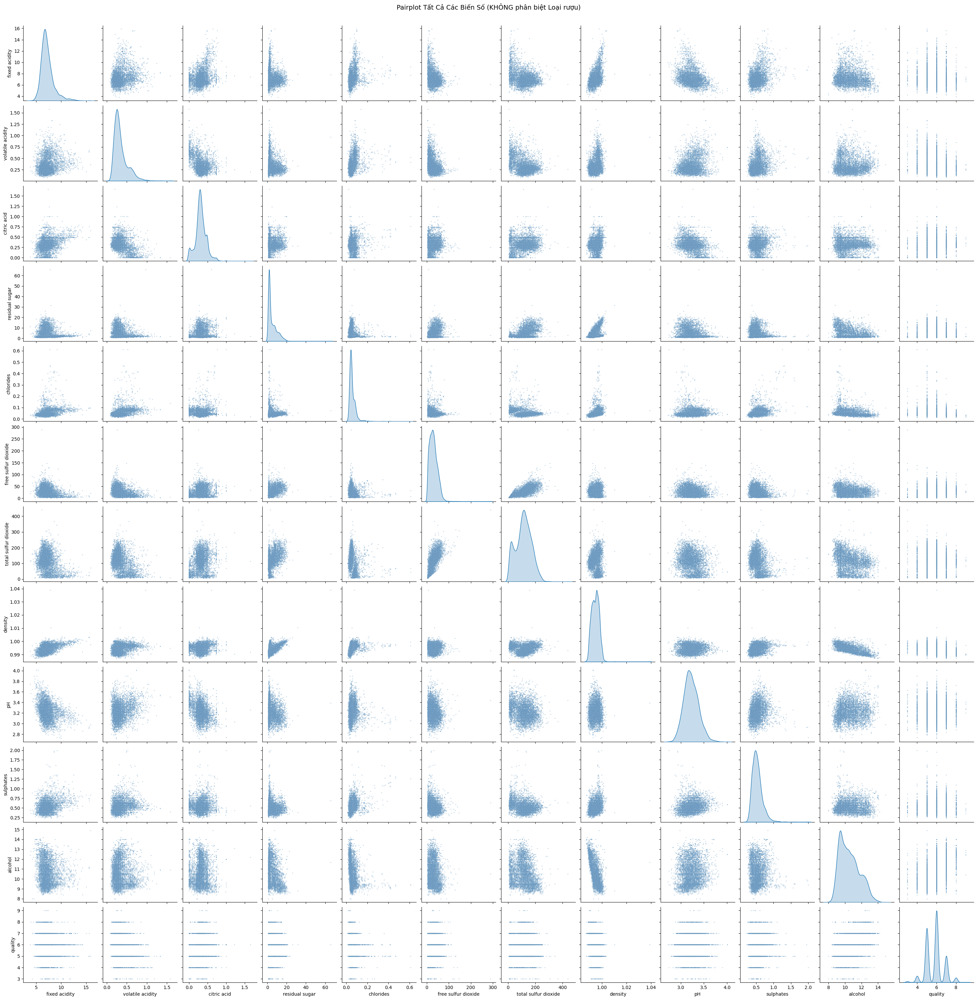

Vẽ Pairplot hoàn tất.

--- Giá trị trung bình của các cột số theo nhóm 'type'---
       fixed acidity  volatile acidity  citric acid  residual sugar  \
type                                                                  
red             8.31              0.53         0.27            2.52   
white           6.84              0.28         0.33            5.91   

       chlorides  free sulfur dioxide  total sulfur dioxide  density    pH  \
type                                                                         
red         0.09                15.89                 46.83     1.00  3.31   
white       0.05                34.89                137.19     0.99  3.20   

       sulphates  alcohol  quality  
type                                
red         0.66    10.43     5.62  
white       0.49    10.59     5.85  


In [ ]:
# --- Tính ma trận tương quan Spearman (trên toàn bộ dữ liệu 'data') ---
# (Vẫn giữ phần tính corr để tham khảo)
numeric_cols: List[str] = data.select_dtypes(include=np.number).columns.tolist()
print("\n--- Ma trận tương quan Spearman giữa các cột số (toàn bộ dữ liệu) ---")
try:
    corr_matrix_spearman = data[numeric_cols].corr(method='spearman')
    print(corr_matrix_spearman.round(2))
except Exception as e:
    print(f"Lỗi khi tính ma trận tương quan Spearman: {e}")
    corr_matrix_spearman = None

# --- Vẽ Pairplot GỘP KHÔNG dùng hue cho TẤT CẢ CỘT SỐ ---
print("\n--- Vẽ Pairplot GỘP cho TẤT CẢ cột số (KHÔNG phân biệt loại rượu) ---")

# Chọn TẤT CẢ các cột số (đã lấy ở trên là numeric_cols)
# Lọc DataFrame chỉ chứa các cột số này
pairplot_data_all_numeric = data[numeric_cols].copy() # Chỉ lấy cột số

try:
    if not pairplot_data_all_numeric.empty:
        print("Đang vẽ Pairplot cho tất cả cột số (không dùng hue)...")
        sns.pairplot(pairplot_data_all_numeric,
                     diag_kind='kde',
                     plot_kws={'alpha': 0.3, 's': 5, 'color': 'steelblue'}) # Giảm alpha/size tối đa, đổi màu
        plt.suptitle("Pairplot Tất Cả Các Biến Số (KHÔNG phân biệt Loại rượu)", y=1.01, fontsize=14) # Điều chỉnh y title
        # Cân nhắc lưu file thay vì show trực tiếp
        # plt.savefig('pairplot_all_numeric_no_hue.png', dpi=100)
        plt.show()
        print("Vẽ Pairplot hoàn tất.")
    else:
        print("Không có dữ liệu số để vẽ pairplot.")
except Exception as e:
     print(f"Lỗi khi vẽ pairplot không dùng hue cho tất cả cột số: {e}")

# --- (Phần tính trung bình nhóm theo type vẫn có thể giữ lại) ---
if 'type' in data.columns and data['type'].dtype == 'object':
    print("\n--- Giá trị trung bình của các cột số theo nhóm 'type'---")
    try:
        numeric_cols_for_mean_type = data.select_dtypes(include=np.number).columns
        mean_by_type = data.groupby('type')[numeric_cols_for_mean_type].mean()
        print(mean_by_type.round(2))
    except Exception as e:
        print(f"Lỗi khi tính giá trị trung bình theo nhóm 'type': {e}")
else:
    print("Không thể tính giá trị trung bình theo nhóm 'type'.")


--- EDA - Pairplot GỘP (TẤT CẢ CỘT SỐ, hue='type') - TRƯỚC xử lý outlier ---
*** Thực hiện trên dữ liệu sau khi tải/gộp/xử lý thiếu/trùng lặp, TRƯỚC khi xử lý outlier ***

--- Ma trận tương quan Spearman giữa các cột số (toàn bộ dữ liệu) ---
                      fixed acidity  volatile acidity  citric acid  \
fixed acidity                  1.00              0.21         0.28   
volatile acidity               0.21              1.00        -0.30   
citric acid                    0.28             -0.30         1.00   
residual sugar                -0.03             -0.02         0.07   
chlorides                      0.36              0.43        -0.06   
free sulfur dioxide           -0.27             -0.37         0.12   
total sulfur dioxide          -0.25             -0.34         0.16   
density                        0.45              0.31         0.06   
pH                            -0.26              0.18        -0.31   
sulphates                      0.23              0.26    

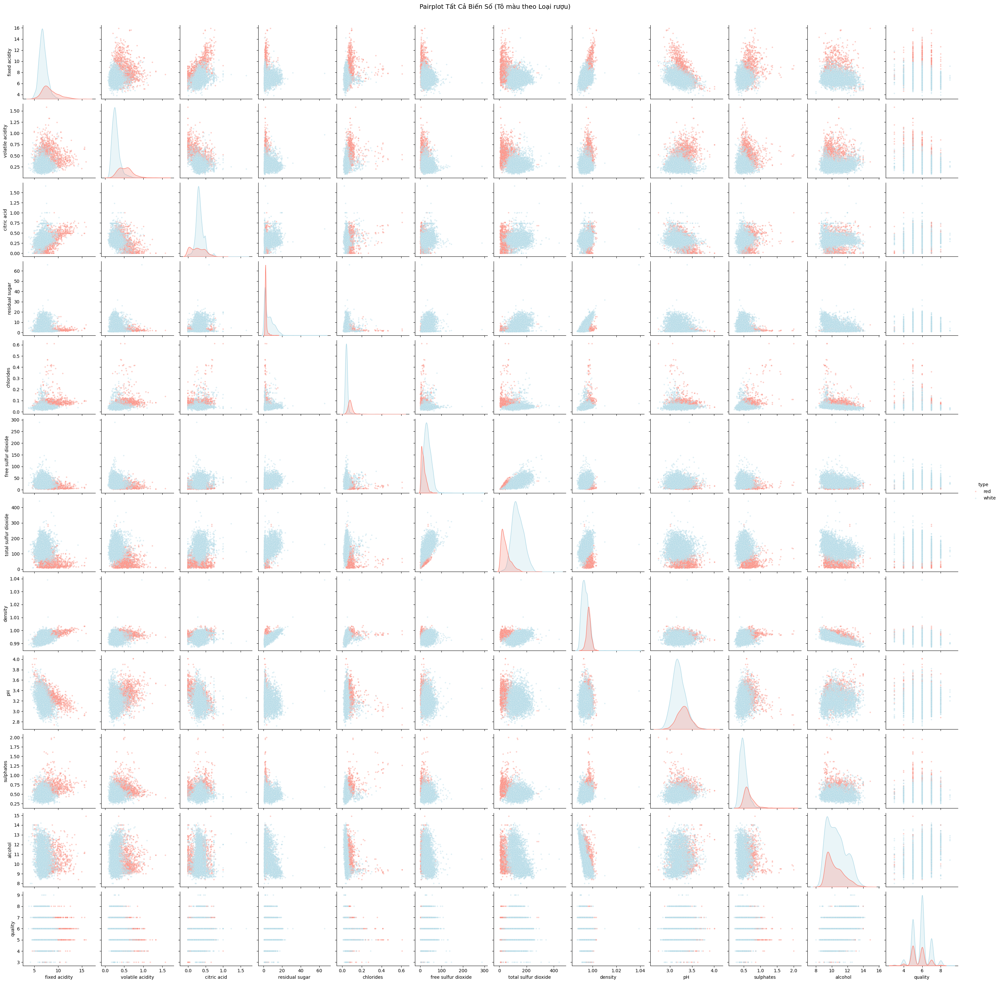

Vẽ Pairplot hoàn tất.

--- Giá trị trung bình của các cột số theo nhóm 'type'---
       fixed acidity  volatile acidity  citric acid  residual sugar  \
type                                                                  
red             8.31              0.53         0.27            2.52   
white           6.84              0.28         0.33            5.91   

       chlorides  free sulfur dioxide  total sulfur dioxide  density    pH  \
type                                                                         
red         0.09                15.89                 46.83     1.00  3.31   
white       0.05                34.89                137.19     0.99  3.20   

       sulphates  alcohol  quality  
type                                
red         0.66    10.43     5.62  
white       0.49    10.59     5.85  


In [ ]:
print("\n--- EDA - Pairplot GỘP (TẤT CẢ CỘT SỐ, hue='type') - TRƯỚC xử lý outlier ---")
print("*** Thực hiện trên dữ liệu sau khi tải/gộp/xử lý thiếu/trùng lặp, TRƯỚC khi xử lý outlier ***")

# --- Tính ma trận tương quan Spearman (trên toàn bộ dữ liệu 'data') ---
# (Vẫn giữ phần tính corr để tham khảo)
numeric_cols: List[str] = data.select_dtypes(include=np.number).columns.tolist()
print("\n--- Ma trận tương quan Spearman giữa các cột số (toàn bộ dữ liệu) ---")
try:
    corr_matrix_spearman = data[numeric_cols].corr(method='spearman')
    print(corr_matrix_spearman.round(2))
except Exception as e:
    print(f"Lỗi khi tính ma trận tương quan Spearman: {e}")
    corr_matrix_spearman = None

# --- Vẽ Pairplot GỘP với hue là 'type' cho TẤT CẢ CỘT SỐ ---
print("\n--- Vẽ Pairplot GỘP cho TẤT CẢ cột số với màu sắc (hue) dựa trên loại rượu ('type') ---")

# Chọn TẤT CẢ các cột số VÀ cột 'type'
cols_for_pairplot_all_type_hue: List[str]
if 'type' in data.columns:
    cols_for_pairplot_all_type_hue = numeric_cols + ['type'] # Lấy tất cả cột số + 'type'
    print(f"Chuẩn bị vẽ Pairplot cho các cột: {cols_for_pairplot_all_type_hue}")
    # Tạo bản sao dữ liệu chỉ với các cột cần thiết
    pairplot_data_all_type_hue = data[cols_for_pairplot_all_type_hue].copy()
else:
    print("Lỗi: Không tìm thấy cột 'type' trong DataFrame 'data' để dùng làm hue.")
    pairplot_data_all_type_hue = None

# Vẽ Pairplot
if pairplot_data_all_type_hue is not None and not pairplot_data_all_type_hue.empty:
    print("Đang vẽ Pairplot (Tất cả cột số, hue='type')...")
    try:
        sns.pairplot(pairplot_data_all_type_hue,
                     hue='type',                 # Dùng 'type' làm hue
                     palette={'red':'salmon', 'white':'lightblue'}, # Màu cho red/white
                     diag_kind='kde',
                     plot_kws={'alpha': 0.4, 's': 10}) # Giảm alpha/size tối đa
        plt.suptitle("Pairplot Tất Cả Biến Số (Tô màu theo Loại rượu)", y=1.01, fontsize=14) # Điều chỉnh y title
        # Cân nhắc lưu file thay vì show trực tiếp
        # plt.savefig('pairplot_all_numeric_type_hue.png', dpi=100)
        plt.show()
        print("Vẽ Pairplot hoàn tất.")
    except Exception as e:
         print(f"Lỗi khi vẽ pairplot với hue='type' cho tất cả cột số: {e}")
else:
    print("Không thể vẽ pairplot do thiếu dữ liệu hoặc cột 'type'.")

# --- Tính giá trị trung bình nhóm theo type (vẫn hữu ích) ---
if 'type' in data.columns and data['type'].dtype == 'object':
    print("\n--- Giá trị trung bình của các cột số theo nhóm 'type'---")
    try:
        numeric_cols_for_mean_type = data.select_dtypes(include=np.number).columns
        mean_by_type = data.groupby('type')[numeric_cols_for_mean_type].mean()
        print(mean_by_type.round(2))
    except Exception as e:
        print(f"Lỗi khi tính giá trị trung bình theo nhóm 'type': {e}")
else:
    print("Không thể tính giá trị trung bình theo nhóm 'type'.")


**Nhận xét Pairplot:**

**1. Biến tô màu (hue='type')**

- Biểu đồ pairplot này sử dụng biến phân loại (type: **'red'/'white'**) để tô màu các điểm dữ liệu. Việc chỉ có hai nhóm chính này giúp cho việc **so sánh trực tiếp** và nhận diện sự khác biệt giữa rượu vang đỏ (màu đỏ/cam) và rượu vang trắng (màu xanh nhạt) trở nên rất rõ ràng và hiệu quả.

**2. Outliers và Phạm vi Dữ liệu (Trước xử lý):**

- Các biểu đồ phân bố (KDE trên đường chéo) và scatter plot cho thấy sự khác biệt lớn về phạm vi và sự hiện diện của các giá trị có thể bị coi là "outlier" (theo IQR của từng nhóm riêng lẻ), đặc biệt là ở giai đoạn này **trước khi** có bước xử lý outlier.

- **Phạm vi Rộng**: Các biến như **residual sugar** và **total sulfur dioxide** có phạm vi cực kỳ rộng, đặc biệt đối với rượu vang trắng. Điều này làm kéo giãn các trục tọa độ tương ứng và có thể làm co cụm các điểm dữ liệu của cả hai loại rượu ở các biểu đồ scatter plot liên quan, che khuất chi tiết ở vùng dữ liệu dày đặc.

- **"Outliers" theo Loại**: Quan sát biểu đồ và thống kê mô tả riêng (từ bước trước) cho thấy rượu trắng thường có nhiều điểm bị gắn cờ outlier ở phía cao cho **volatile acidity, chlorides, sulphates** và cả hai đầu của **citric acid**. Rượu đỏ lại có nhiều điểm bị gắn cờ hơn ở **residual sugar** (phía cao) và **total sulfur dioxide** (phía cao).

- **Ảnh hưởng**: Sự tồn tại của các giá trị nằm xa phần lớn dữ liệu này (dù hợp lệ hay không) ảnh hưởng đến tỷ lệ hiển thị trên các trục và có thể che khuất các mẫu hình thực sự trong các đám mây điểm.

**3. Hình dạng Phân bố (Diagonal KDEs):**

- **Khác biệt rõ rệt**: Đường chéo hiển thị rõ sự khác biệt về hình dạng và vị trí phân bố giữa đỏ và trắng cho hầu hết các biến.

  - **Gần đối xứng (trong từng nhóm)**: pH, density, alcohol (hơi lệch nhẹ).

  - **Lệch phải**: volatile acidity (đuôi dài ở trắng), residual sugar (rất lệch, trắng rộng hơn nhiều), chlorides, free sulfur dioxide, total sulfur dioxide, sulphates.

  - **Khác biệt hình dạng**: fixed acidity và citric acid có hình dạng phân bố khác nhau đáng kể giữa hai loại rượu.

  - **quality (biến rời rạc)**: Tập trung ở các điểm giữa (5, 6, 7), phân bố của rượu trắng có vẻ hơi nhỉnh hơn về phía các điểm cao.


**4. Kết luận từ Pairplot**

- **Hiệu quả cao trong phân biệt**: Việc sử dụng **hue='type'** là cực kỳ hiệu quả cho bộ dữ liệu này. Sự khác biệt cơ bản giữa đặc tính hóa lý của rượu vang đỏ và trắng được trực quan hóa một cách rõ ràng trên cả phân bố đơn biến (KDE) và mối quan hệ cặp biến (scatter plot). Các biến như volatile acidity, total sulfur dioxide, chlorides, sulphates, density, fixed acidity, residual sugar cho thấy sự tách biệt nhóm đáng kể.

- **Xác định mối quan hệ trong nhóm**: Biểu đồ cũng cho phép nhìn vào xu hướng bên trong mỗi loại rượu. Ví dụ, mối quan hệ nghịch biến mạnh giữa density và alcohol (ρ ≈ -0.68) hay mối quan hệ dương giữa free sulfur dioxide và total sulfur dioxide (ρ ≈ 0.73) có thể thấy rõ ở cả hai loại. Mối quan hệ giữa alcohol và quality (ρ ≈ 0.48) cũng có vẻ nhất quán.

- **Ảnh hưởng của Phạm vi/Skewness**: Phạm vi rất rộng của một số biến (đặc biệt ở rượu trắng) vẫn ảnh hưởng đến tỷ lệ các trục, có thể làm các mối quan hệ ở vùng dữ liệu dày đặc trông bị nén lại.

- **Tính hữu dụng cao**: Pairplot hue='type' này rất hữu ích ngay cả trước khi xử lý outlier. Nó cung cấp bằng chứng trực quan mạnh mẽ về sự khác biệt giữa hai loại rượu và các mối tương quan cơ bản, là cơ sở vững chắc cho các phân tích sâu hơn.

- **Sự cần thiết của Phân tích/Xử lý Riêng biệt**: Biểu đồ này cũng nhấn mạnh tầm quan trọng của việc thực hiện các kiểm định thống kê so sánh và các bước tiền xử lý (như xử lý outlier) nên được thực hiện riêng biệt hoặc có xem xét đến yếu tố type để có kết quả chính xác và ý nghĩa nhất.




#### Histogram cho biến Numerical


--- Phân phối giá trị cho cột fixed acidity ---
fixed acidity
(3.788, 5.01]       57
(5.01, 6.22]       991
(6.22, 7.43]      2566
(7.43, 8.64]      1111
(8.64, 9.85]       331
(9.85, 11.06]      148
(11.06, 12.27]      71
(12.27, 13.48]      34
(13.48, 14.69]       6
(14.69, 15.9]        5
Name: count, dtype: int64

--- Phân phối giá trị cho cột volatile acidity ---
volatile acidity
(0.0785, 0.23]    1249
(0.23, 0.38]      2536
(0.38, 0.53]       748
(0.53, 0.68]       508
(0.68, 0.83]       190
(0.83, 0.98]        61
(0.98, 1.13]        22
(1.13, 1.28]         3
(1.28, 1.43]         2
(1.43, 1.58]         1
Name: count, dtype: int64

--- Phân phối giá trị cho cột citric acid ---
citric acid
(-0.00166, 0.166]     653
(0.166, 0.332]       2504
(0.332, 0.498]       1706
(0.498, 0.664]        341
(0.664, 0.83]         104
(0.83, 0.996]           4
(0.996, 1.162]          6
(1.162, 1.328]          1
(1.328, 1.494]          0
(1.494, 1.66]           1
Name: count, dtype: int64

--- Phân p

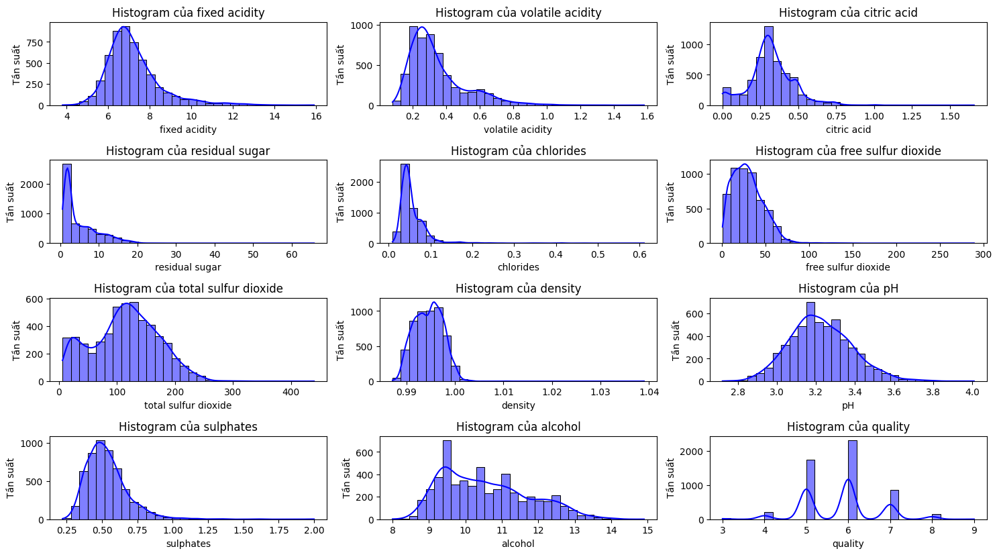

In [ ]:
# Chọn các cột số
num_cols: pd.Index = data.select_dtypes(include=['number']).columns

for col in num_cols:
    print(f"\n--- Phân phối giá trị cho cột {col} ---")
    value_counts = pd.cut(data[col], bins=10).value_counts().sort_index()
    print(value_counts)

# Thiết lập kích thước
plt.figure(figsize=(15, 10))

# Duyệt qua từng cột số để vẽ histogram
for i, col in enumerate(num_cols, 1): # i: int, col: str
    plt.subplot(len(num_cols) // 3 + 1, 3, i)  # Sắp xếp 3 cột trên mỗi hàng
    sns.histplot(data[col], bins=30, kde=True, color='blue')  # Vẽ histogram có KDE
    plt.title(f"Histogram của {col}")
    plt.xlabel(col)
    plt.ylabel("Tần suất")

plt.tight_layout()
plt.show()

1. Tại sao dùng biểu đồ Histogram?
Histogram (biểu đồ tần suất) được dùng để:

  - Thể hiện phân bố xác suất (distribution) của biến số liên tục.

  - Dễ dàng nhận biết hình dạng phân phối: chuẩn, lệch trái, lệch phải, phân bố nhiều đỉnh...

  - Kết hợp đường KDE (đường xanh) giúp trực quan hóa xu hướng tổng thể của dữ liệu.

Rất hữu ích để đánh giá xem có cần biến đổi dữ liệu (log, sqrt,...) hay không.

2. Nhận xét và xu hướng dữ liệu từ biểu đồ Histogram

- **fixed acidity (Axit cố định)**:

  - Phân bố có dạng hình chuông rộng, đỉnh tập trung chủ yếu trong khoảng 6.0 đến 7.5 g/dm³.

  - Nhìn chung khá đối xứng, có thể hơi lệch nhẹ về phía giá trị cao hơn. Sự trải rộng có thể phản ánh sự kết hợp của rượu đỏ (thường có axit cố định cao hơn) và rượu trắng.

- **volatile acidity (Axit dễ bay hơi)**:

  - Phân bố **lệch phải** rõ rệt. Phần lớn giá trị tập trung ở mức thấp (dưới 0.4 g/dm³), với đỉnh nhọn quanh 0.3 g/dm³.

  - Đuôi bên phải kéo dài, thể hiện sự hiện diện của các loại rượu (chủ yếu có thể là rượu đỏ hoặc một số rượu trắng có vấn đề) với độ axit dễ bay hơi cao hơn đáng kể.

- **citric acid (Axit citric)**:

  - Phân bố tập trung mạnh ở khoảng 0.2 đến 0.45 g/dm³, với đỉnh cao nhất gần 0.3 g/dm³.

  - Có một số lượng đáng kể các mẫu có giá trị rất thấp (gần 0), và phân bố không hoàn toàn đối xứng, có thể hơi lệch nhẹ hoặc có nhiều đỉnh nhỏ (multimodal), phản ánh sự khác biệt giữa các loại rượu.

- **residual sugar (Đường tồn dư)**:

  - Phân bố **cực kỳ lệch phải**. Một lượng rất lớn các mẫu rượu tập trung ở mức đường rất thấp (dưới 2.1 g/dm³), đại diện cho các loại rượu khô.

  - Tuy nhiên, có một cái đuôi rất dài kéo về phía giá trị cao (lên đến 16 g/dm³), chủ yếu là do các loại rượu trắng bán ngọt hoặc ngọt. Biến này có độ biến thiên rất lớn.

- **chlorides (Clorua)**:

  - Phân bố **lệch phải** mạnh. Đa số các giá trị rất thấp, tập trung chủ yếu dưới 0.06 g/dm³.

  - Đuôi bên phải cho thấy một số loại rượu có nồng độ muối cao hơn, có thể phổ biến hơn ở rượu đỏ.

- **free sulfur dioxide (SO2 tự do)**:

  - Phân bố có dạng hình chuông khá rộng và thấp, đỉnh nằm trong khoảng 16 đến 40 mg/dm³.

  - Có xu hướng hơi lệch phải, với một số giá trị cao hơn hẳn phần lớn dữ liệu. Sự trải rộng phản ánh sự khác biệt lớn về việc sử dụng SO2 giữa rượu đỏ (ít hơn) và trắng (nhiều hơn).

- **total sulfur dioxide (Tổng SO2)**:

  - Phân bố **rất rộng** và có thể có nhiều đỉnh (multimodal) hoặc ít nhất là rất phẳng ở phần trung tâm (khoảng 90-170 mg/dm³).

  - Có xu hướng **lệch phải** rõ ràng, với một đuôi dài các giá trị cao, chủ yếu do rượu trắng. Đây là một biến có sự khác biệt rất lớn giữa hai loại rượu.

- **density (Tỷ trọng)**:

  - Phân bố **rất hẹp và đối xứng**, tập trung cực kỳ chặt chẽ quanh giá trị 0.994 - 0.997 g/cm³.

  - Hình dạng rất gần với phân phối chuẩn nhưng có độ lệch chuẩn rất nhỏ.

- **pH**:

  - Phân bố **rất đối xứng và có dạng chuông rõ ràng**, tập trung mạnh trong khoảng 3.05 đến 3.42.

  - Rất giống với phân phối chuẩn, là một trong những biến ổn định nhất trong bộ dữ liệu.

- **sulphates (Sunfat)**:

  - Phân bố **lệch phải**. Đỉnh tập trung quanh 0.45 - 0.6 g/dm³.

  - Đuôi bên phải kéo dài, cho thấy một số loại rượu (thường là đỏ) có hàm lượng sunfat cao hơn.

- **alcohol (Độ cồn)**:

  - Phân bố khá rộng, có thể có nhiều đỉnh (multimodal) với các cụm tập trung quanh 9.5%, 10.5%, 11.5%.

  - Tổng thể có thể hơi lệch nhẹ về bên trái (đuôi phía giá trị thấp dài hơn một chút so với đuôi phía cao).

- **quality (Chất lượng)**:

  - Đây là phân bố **rời rạc**, không liên tục.

  - Tập trung **rất mạnh** vào các điểm 5 và 6. Các điểm 7 và 4 ít phổ biến hơn đáng kể. Các điểm 3 và 8 là rất hiếm.

  - Phân bố có dạng gần giống chuông nhưng bị giới hạn trong phạm vi hẹp và chỉ gồm các giá trị nguyên.

**Nhận xét chung:**

Đa số các biến hóa lý trong bộ dữ liệu Wine Quality (khi gộp chung đỏ và trắng) không tuân theo phân phối chuẩn. Nhiều biến bị lệch phải đáng kể (volatile acidity, residual sugar, chlorides, sulphates, total sulfur dioxide). Một số biến như free sulfur dioxide và total sulfur dioxide có phân bố rất rộng hoặc đa đỉnh do sự khác biệt lớn giữa hai loại rượu. Chỉ có density và pH là có phân bố rất gần với chuẩn. Biến mục tiêu quality có phân bố rời rạc, tập trung cao ở giữa.

#### Biểu đồ Cột và Biểu đồ Tròn cho biến Categorical (object)


#### Biểu đồ Cột cho biến Categorical/Ordinal (object) ####

Tần suất các giá trị trong biến phân loại/thứ bậc:

--- Tần suất các giá trị trong cột 'type' ---
type
red      1359
white    3961
Name: count, dtype: int64

--- Tần suất các giá trị trong cột 'quality' ---
quality
3      30
4     206
5    1752
6    2323
7     856
8     148
9       5
Name: count, dtype: int64

Vẽ Biểu đồ Cột:


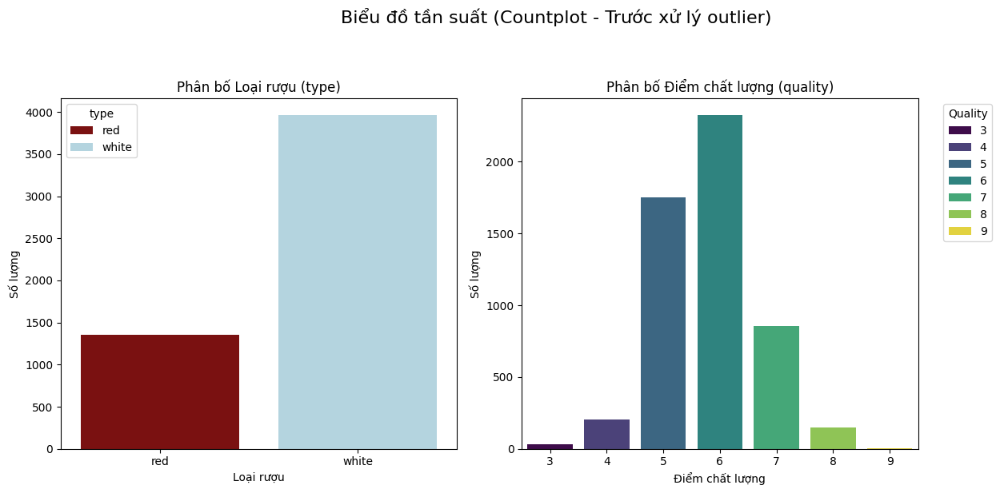


#### Biểu đồ Tròn (Donut Chart - Trước xử lý outlier) ####

--- Vẽ Biểu đồ Tròn cho biến 'type' ---
Phân bố của cột 'type':
Giá trị        Số lượng       Tỷ lệ (%) 
----------------------------------------
white          3961            74.45%
red            1359            25.55%


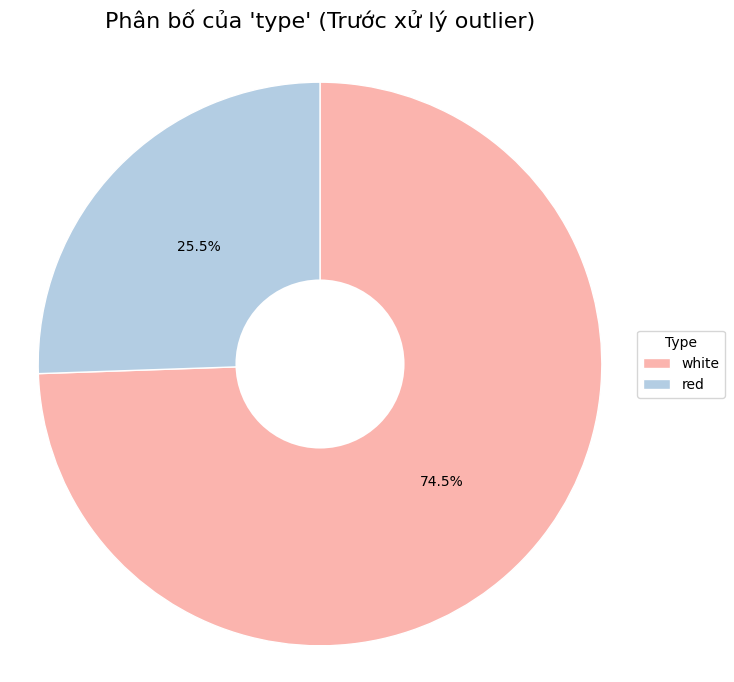


--- Vẽ Biểu đồ Tròn cho biến 'quality' ---
Phân bố của cột 'quality':
Giá trị        Số lượng       Tỷ lệ (%) 
----------------------------------------
3              30               0.56%
4              206              3.87%
5              1752            32.93%
6              2323            43.67%
7              856             16.09%
8              148              2.78%
9              5                0.09%


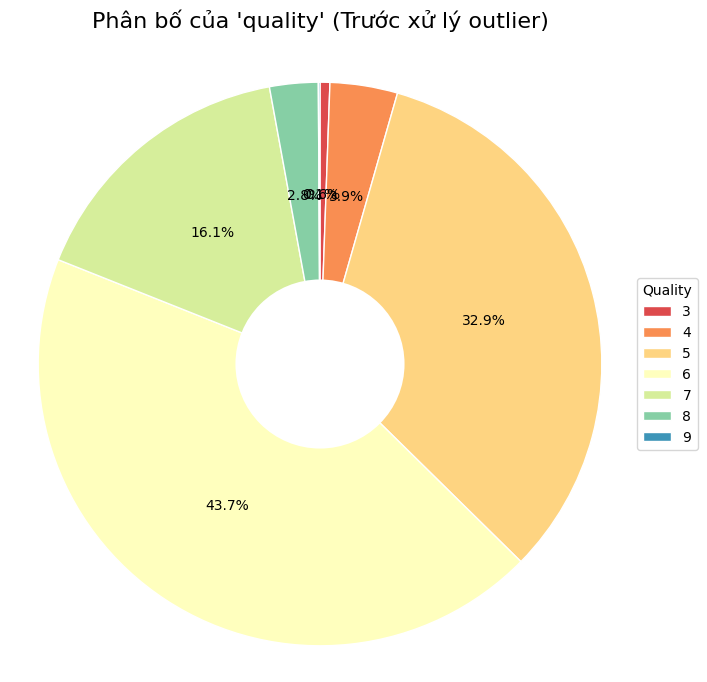

In [ ]:
print("\n#### Biểu đồ Cột cho biến Categorical/Ordinal (object) ####")

# Biến phân loại/thứ bậc cần vẽ
categorical_plot_list: List[str] = ['type', 'quality']

print("\nTần suất các giá trị trong biến phân loại/thứ bậc:")
for col in categorical_plot_list:
    print(f"\n--- Tần suất các giá trị trong cột '{col}' ---")
    # Sử dụng DataFrame 'data'
    print(data[col].value_counts().sort_index())

# --- Vẽ Biểu đồ Cột (Countplots) ---
print("\nVẽ Biểu đồ Cột:")
plt.figure(figsize=(14, 6))
plt.suptitle("Biểu đồ tần suất (Countplot - Trước xử lý outlier)", fontsize=16, y=1.02)

# Biểu đồ cho 'type'
plt.subplot(1, 2, 1)
# Sử dụng DataFrame 'data'
sns.countplot(x=data['type'], hue=data['type'],
              palette={'red': 'darkred', 'white': 'lightblue'}, legend=True)
plt.title("Phân bố Loại rượu (type)")
plt.xlabel("Loại rượu")
plt.ylabel("Số lượng")

# Biểu đồ cho 'quality'
plt.subplot(1, 2, 2)
# Sử dụng DataFrame 'data'
sns.countplot(x=data['quality'], hue=data['quality'],
              palette='viridis', legend=True)
plt.title("Phân bố Điểm chất lượng (quality)")
plt.xlabel("Điểm chất lượng")
plt.ylabel("Số lượng")
# Điều chỉnh legend cho quality
handles, labels = plt.gca().get_legend_handles_labels()
try:
    unique_labels = sorted(list(set(labels)), key=int)
    unique_handles = [handles[labels.index(lab)] for lab in unique_labels]
    plt.legend(unique_handles, unique_labels, title='Quality', bbox_to_anchor=(1.05, 1), loc='upper left')
except ValueError:
    plt.legend(handles, labels, title='Quality', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout(rect=[0, 0, 0.9, 0.96])
plt.show()


# --- Vẽ Biểu đồ Tròn (Donut Chart) cho cả 'type' và 'quality'  ---
print("\n#### Biểu đồ Tròn (Donut Chart - Trước xử lý outlier) ####")

for col_pie in ['type', 'quality']: # Lặp qua cả hai biến
    print(f"\n--- Vẽ Biểu đồ Tròn cho biến '{col_pie}' ---")
    # Sử dụng DataFrame 'data'
    if col_pie in data.columns:
        # 1. Lấy dữ liệu tần suất
        if col_pie == 'quality':
            value_counts = data[col_pie].value_counts().sort_index(ascending=True)
        else:
             value_counts = data[col_pie].value_counts().sort_values(ascending=False)

        labels = value_counts.index
        sizes = value_counts.values
        total = sizes.sum()

        # In bảng tóm tắt
        print(f"Phân bố của cột '{col_pie}':")
        print(f"{'Giá trị':<15}{'Số lượng':<15}{'Tỷ lệ (%)':<10}")
        print("-" * 40)
        for val, count in value_counts.items():
            percentage = (count / total) * 100
            print(f"{str(val):<15}{count:<15}{percentage:>6.2f}%")

        # 2. Vẽ biểu đồ tròn
        plt.figure(figsize=(8, 8))
        colors = sns.color_palette("Spectral", len(labels)) if col_pie == 'quality' else sns.color_palette("Pastel1", len(labels))

        plt.pie(
            sizes,
            autopct='%1.1f%%',
            startangle=90,
            counterclock=False, # Giữ chiều kim đồng hồ
            colors=colors,
            wedgeprops={'linewidth': 1, 'edgecolor': 'white'}
        )

        # 3. Vẽ Donut
        centre_circle = plt.Circle((0, 0), 0.30, fc='white')
        fig = plt.gcf()
        fig.gca().add_artist(centre_circle)

        plt.axis('equal')
        plt.title(f"Phân bố của '{col_pie}' (Trước xử lý outlier)", fontsize=16, pad=20)
        plt.legend(labels, title=col_pie.capitalize(), loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
        plt.show()

    else:
        print(f"Không tìm thấy cột '{col_pie}' trong dữ liệu gốc.")


**Nhận xét và xu hướng dữ liệu từ biểu đồ Cột/Tròn (Wine Quality - Trước xử lý outlier)**

- **type (Loại rượu)**:

  - Số lượng mẫu rượu **trắng (white)** chiếm đa số rõ rệt (3961 mẫu, ~74.5%) so với rượu **đỏ (red)** (1359 mẫu, ~25.5%).

  - Điều này cho thấy **sự mất cân bằng mẫu đáng kể** giữa hai loại rượu trong bộ dữ liệu được thu thập. Cần lưu ý điều này khi thực hiện các phân tích so sánh hoặc xây dựng mô hình tổng quát cho cả hai loại.

- **quality (Chất lượng - Biến mục tiêu)**:

  - Đây là biến mục tiêu, thể hiện điểm chất lượng cảm quan, với các giá trị quan sát được trong tập dữ liệu này là từ **3 đến 9**.

  - Phân bố tần suất cho thấy:

      - Điểm **6** là phổ biến nhất (2323 mẫu, ~43.7%), tiếp theo là điểm **5** (1752 mẫu, ~32.9%). Hai điểm chất lượng **trung bình** này chiếm phần lớn tuyệt đối của dữ liệu (tổng cộng ~76.6%).

      - Điểm **7** (856 mẫu, ~16.1%) đại diện cho chất lượng khá tốt, xuất hiện ít thường xuyên hơn đáng kể.

      - Các mức chất lượng ở hai đầu của thang điểm là **rất hiếm**: điểm 4 (206 mẫu, ~3.9%), điểm 8 (148 mẫu, ~2.8%), điểm 3 (30 mẫu, ~0.6%), và đặc biệt là điểm 9 (chỉ có 5 mẫu, ~0.09%).

  - Phân bố này rõ ràng là **không đều**, có dạng gần giống hình chuông nhưng **rất tập trung ở các giá trị giữa (5 và 6)** và có đuôi rất mỏng ở cả hai phía thấp và cao.

  - Nếu mục tiêu là phân loại rượu thành các nhóm chất lượng (ví dụ: Tốt/Trung bình/Kém), sự **mất cân bằng nhãn** này rất rõ ràng, đặc biệt là sự thiếu hụt các mẫu chất lượng rất thấp và rất cao. Điều này cần được xử lý trong các bài toán phân loại (ví dụ: bằng các kỹ thuật resampling như SMOTE, hoặc chọn các độ đo đánh giá phù hợp như F1-score, AUC thay vì chỉ Accuracy).

  - Biểu đồ cột (Countplot) thể hiện sự khác biệt về tần suất giữa các điểm chất lượng một cách trực quan và dễ so sánh hơn so với biểu đồ tròn, đặc biệt là đối với các nhóm hiếm như 3, 8, 9.

## c) Xử lý dữ liệu thiếu

**Do ở đây không có missing value nên không cần làm gì ở bước này.**

In [ ]:
# # Loại bỏ các bản ghi trùng lặp
# data = data.drop_duplicates()
# print(f"Số lượng bản ghi sau khi loại trùng lặp: {data.shape[0]}")

## d) Phát hiện dữ liệu ngoại lai (outliers)

- **Phương pháp**: Dựa trên skewness để chọn Z-score (cho phân phối gần chuẩn) hoặc IQR (cho phân phối lệch).
- **Xử lý đề xuất**: Thay thế outliers bằng giá trị trung bình (Mean) hoặc trung vị (Median) tương ứng.

**Công thức tính Khoảng tứ phân vị (IQR) và Ngưỡng xác định Outlier:**

  1. Xác định Tứ phân vị thứ nhất (Q1 - giá trị mà 25% dữ liệu nhỏ hơn nó) và Tứ phân vị thứ ba (Q3 - giá trị mà 75% dữ liệu nhỏ hơn nó).

  2. Tính Khoảng tứ phân vị:

  $\Large IQR = Q3 - Q1$

  3. Xác định Ngưỡng dưới (Lower Bound):

  $\Large L = Q1 - 1.5 \times IQR$

  4. Xác định Ngưỡng trên (Upper Bound):

  $\Large U = Q3 + 1.5 \times IQR$

- Một giá trị được xem là ngoại lai (outlier) nếu nó nhỏ hơn Ngưỡng dưới (L) hoặc lớn hơn Ngưỡng trên (U).

**Công thức tính Z-score (cho dữ liệu mẫu):**

- Z-score cho biết một giá trị cụ thể cách trung bình bao nhiêu lần độ lệch chuẩn.

$\Large Z = \frac{x - \bar{x}}{s}$

Trong đó:

  - Z: là giá trị Z-score.

  - x: là giá trị của một quan sát cụ thể.

  - $\bar{x}$: là trung bình cộng của mẫu.

  - s: là độ lệch chuẩn của mẫu.

In [ ]:
from scipy.stats import skew, zscore

# Danh sách cột số cần xử lý outlier (trừ 'quality')
numeric_features = [
    'fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar',
    'chlorides', 'free sulfur dioxide', 'total sulfur dioxide',
    'density', 'pH', 'sulphates', 'alcohol'
]

print("### PHÁT HIỆN & XỬ LÝ OUTLIER TRÊN data (dựa theo skewness + IQR/Z-score) ###\n")

outlier_summary = {}

for col in numeric_features:
    col_data = data[col].dropna()
    skewness_val = skew(col_data)

    if abs(skewness_val) < 0.5:
        # Phân phối gần chuẩn → dùng Z-score
        z_scores = zscore(col_data)
        outlier_mask = abs(z_scores) > 3
        num_outliers = outlier_mask.sum()

        # Thay thế outlier bằng Median
        median_val = col_data.median()
        data.loc[outlier_mask.index[outlier_mask], col] = median_val

        outlier_summary[col] = {
            "method": "Z-score",
            "skewness": round(skewness_val, 3),
            "outliers": num_outliers
        }

    else:
        # Phân phối lệch → dùng IQR
        Q1 = col_data.quantile(0.25)
        Q3 = col_data.quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        outlier_mask = (col_data < lower_bound) | (col_data > upper_bound)
        num_outliers = outlier_mask.sum()

        # Thay thế outlier bằng Median
        median_val = col_data.median()
        data.loc[outlier_mask.index[outlier_mask], col] = median_val

        outlier_summary[col] = {
            "method": "IQR",
            "skewness": round(skewness_val, 3),
            "outliers": num_outliers
        }

# --- In kết quả ---
print("Kết quả xử lý outlier:")
for col, info in outlier_summary.items():
    print(f"- {col}: {info['outliers']} outliers (Phương pháp: {info['method']}, Skewness: {info['skewness']})")

total_outliers_handled = sum(info['outliers'] for info in outlier_summary.values())
print(f"\nTổng số outliers đã xử lý: {total_outliers_handled}")


### PHÁT HIỆN & XỬ LÝ OUTLIER TRÊN data (dựa theo skewness + IQR/Z-score) ###

Kết quả xử lý outlier:
- fixed acidity: 304 outliers (Phương pháp: IQR, Skewness: 1.65)
- volatile acidity: 279 outliers (Phương pháp: IQR, Skewness: 1.504)
- citric acid: 26 outliers (Phương pháp: Z-score, Skewness: 0.484)
- residual sugar: 141 outliers (Phương pháp: IQR, Skewness: 1.706)
- chlorides: 237 outliers (Phương pháp: IQR, Skewness: 5.337)
- free sulfur dioxide: 44 outliers (Phương pháp: IQR, Skewness: 1.362)
- total sulfur dioxide: 8 outliers (Phương pháp: Z-score, Skewness: 0.064)
- density: 3 outliers (Phương pháp: IQR, Skewness: 0.666)
- pH: 32 outliers (Phương pháp: Z-score, Skewness: 0.39)
- sulphates: 163 outliers (Phương pháp: IQR, Skewness: 1.809)
- alcohol: 1 outliers (Phương pháp: IQR, Skewness: 0.546)

Tổng số outliers đã xử lý: 1238


In [ ]:
# Tạo bản sao để xử lý
data_cleaned = data.copy()
print("\nĐã tạo bản sao 'data_cleaned' để xử lý ngoại lai.")


Đã tạo bản sao 'data_cleaned' để xử lý ngoại lai.


In [ ]:
# Các cột số cần kiểm tra outlier (trừ 'quality')
numeric_features: List[str] = [
    'fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar',
    'chlorides', 'free sulfur dioxide', 'total sulfur dioxide',
    'density', 'pH', 'sulphates', 'alcohol'
]

# (Ví dụ: nếu có xử lý đặc biệt với giá trị 0 hay NaN, bạn có thể thêm ở đây)

# Phát hiện outlier bằng IQR
def detect_outliers_iqr(df: pd.DataFrame, col: str) -> int:
    """Đếm số lượng outlier trong một cột bằng phương pháp IQR."""
    col_data = df[col].dropna()
    Q1 = col_data.quantile(0.25)
    Q3 = col_data.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return ((col_data < lower_bound) | (col_data > upper_bound)).sum()

# Phát hiện outlier bằng Z-score
def detect_outliers_zscore(df: pd.DataFrame, col: str, threshold: float = 3.0) -> int:
    """Đếm số lượng outlier trong một cột bằng phương pháp Z-score."""
    col_data = df[col].dropna()
    if len(col_data) < 2 or col_data.std() < 1e-9:
        return 0
    return (np.abs(zscore(col_data)) > threshold).sum()

# Ánh xạ phương pháp dùng cho từng cột
method_map: Dict[str, str] = {
    'fixed acidity': 'IQR',
    'volatile acidity': 'IQR',
    'citric acid': 'Z-score',
    'residual sugar': 'IQR',
    'chlorides': 'IQR',
    'free sulfur dioxide': 'IQR',
    'total sulfur dioxide': 'Z-score',
    'density': 'IQR',
    'pH': 'Z-score',
    'sulphates': 'IQR',
    'alcohol': 'IQR',
}

outliers_after: Dict[str, int] = {}
for col in numeric_features:
    method = method_map.get(col, 'IQR')
    if method == 'IQR':
        outliers_after[col] = detect_outliers_iqr(data_cleaned, col)
    else:  # Z-score
        outliers_after[col] = detect_outliers_zscore(data_cleaned, col)

# In từng cột
print("Số lượng ngoại lai:")
for col, count in outliers_after.items():
    print(f"- {col}: {count} (theo {method_map[col]})")

# Tổng kết
total_outliers: int = sum(outliers_after.values())
print(f"\n Tổng số outliers còn lại: {total_outliers}")


Số lượng ngoại lai:
- fixed acidity: 123 (theo IQR)
- volatile acidity: 212 (theo IQR)
- citric acid: 38 (theo Z-score)
- residual sugar: 107 (theo IQR)
- chlorides: 165 (theo IQR)
- free sulfur dioxide: 8 (theo IQR)
- total sulfur dioxide: 0 (theo Z-score)
- density: 0 (theo IQR)
- pH: 6 (theo Z-score)
- sulphates: 26 (theo IQR)
- alcohol: 0 (theo IQR)

 Tổng số outliers còn lại: 685


**Giải trình về việc chấp nhận trạng thái dữ liệu sau bước xác định ngoại lai ban đầu:
**

Sau khi áp dụng quy trình xử lý ngoại lai (phát hiện dựa trên Skewness/Z-score/IQR và thay thế bằng Median), nhóm thực hiện kiểm tra lại bằng chính phương pháp phát hiện ban đầu và nhận thấy một số biến, đặc biệt là volatile acidity, residual sugar, và chlorides, vẫn còn số lượng đáng kể các điểm bị gắn cờ là ngoại lai theo tiêu chuẩn IQR. Tuy nhiên, nhóm quyết định sẽ **chấp nhận trạng thái dữ liệu hiện tại** (data_cleaned) cho các bước phân tích tiếp theo vì những lý do sau:

1. **Mục tiêu của xử lý ban đầu đã đạt được**: Mục đích chính của việc thay thế bằng median là để **giảm thiểu ảnh hưởng của các giá trị cực kỳ khác biệt hoặc tiềm ẩn lỗi** so với phần lớn dữ liệu. Việc thay thế các điểm xa nhất bằng giá trị trung vị đã thực hiện được điều này, tạo ra một tập dữ liệu data_cleaned có phạm vi giá trị ít cực đoan hơn so với data gốc. Mục tiêu không nhất thiết là phải "ép" mọi điểm dữ liệu nằm hoàn toàn trong khoảng 1.5*IQR.

2. **Hạn chế của phương pháp phát hiện (Đặc biệt IQR trên dữ liệu lệch)**: Phương pháp IQR rất nhạy cảm với các phân phối bị lệch (skewed) như volatile acidity, residual sugar, chlorides. Khi dữ liệu lệch, khoảng cách giữa trung vị (median) và tứ phân vị (Q1, Q3) không đối xứng. Việc thay thế các điểm ở đuôi dài bằng median (vốn nằm gần trung tâm dữ liệu hơn) **không làm thay đổi đáng kể vị trí của Q1, Q3 hoặc độ lớn của IQR** trong một phân phối vẫn còn lệch. Do đó, nhiều điểm dữ liệu (ngay cả những điểm đã được thay thế hoặc những điểm gần đó) vẫn có thể nằm ngoài "hàng rào" 1.5*IQR mới được tính toán lại. Việc tiếp tục xử lý chỉ dựa trên tiêu chuẩn IQR có thể dẫn đến việc loại bỏ hoặc thay đổi cả những điểm thuộc phần đuôi tự nhiên của phân phối.

3. **Ảnh hưởng của việc gộp dữ liệu Đỏ/Trắng**: Phân tích và xử lý ngoại lai này được thực hiện trên **dữ liệu gộp** của cả rượu vang đỏ và trắng để mô phỏng theo yêu cầu. Tuy nhiên, hai loại rượu này có đặc tính hóa lý rất khác nhau:

  - residual sugar: Rượu trắng có thể có lượng đường tồn dư cao hơn rất nhiều so với rượu đỏ một cách hoàn toàn bình thường (ví dụ: rượu ngọt). Khi gộp chung, các giá trị đường cao hợp lệ của rượu trắng có thể bị coi là ngoại lai so với median chung (vốn bị kéo xuống bởi phần lớn rượu đỏ khô hơn).

  - volatile acidity, chlorides: Rượu đỏ thường có mức độ các chỉ số này cao hơn rượu trắng. Các giá trị ở phần cao của thang đo rượu đỏ có thể bị xem là ngoại lai khi so với median chung (bị kéo xuống bởi rượu trắng).

  - Việc thay thế bằng **median của dữ liệu gộp** không giải quyết triệt để vấn đề này. Các điểm vẫn bị gắn cờ sau xử lý có thể chỉ đơn giản là phản ánh sự khác biệt cố hữu giữa hai nhóm và nằm ở phần đuôi của phân phối của chính loại rượu đó.

4. **Bảo toàn đặc tính phân phối**: Việc cố gắng loại bỏ hoặc thay đổi tất cả các điểm bị IQR gắn cờ có thể làm **méo mó đáng kể hình dạng phân phối thực tế** của các biến, đặc biệt là các biến lệch. Chấp nhận trạng thái hiện tại giúp giữ lại phần nào đó sự biến thiên và đặc tính tự nhiên của dữ liệu (sau khi đã giảm bớt các giá trị cực đoan nhất).

5. **Phù hợp với các bước tiếp theo**: DataFrame data_cleaned hiện tại đã giảm bớt các giá trị quá cực đoan. Nhiều thuật toán Machine Learning (đặc biệt là các mô hình dựa trên cây như Random Forest, Gradient Boosting) có khả năng xử lý tốt các phân phối không chuẩn hoặc các điểm không quá xa lạ mà không cần phải chuẩn hóa hoàn toàn theo IQR.

**Tóm lại**: Nhóm ghi nhận rằng một số biến vẫn còn các điểm bị phương pháp IQR đánh dấu sau khi xử lý bằng median. Tuy nhiên, nhóm cho rằng các điểm này phần lớn phản ánh đặc tính phân phối lệch tự nhiên của biến, ảnh hưởng của việc gộp dữ liệu hai loại rượu, và hạn chế của chính phương pháp IQR. Việc xử lý ban đầu đã đủ để giảm thiểu tác động của các giá trị dị biệt nhất, và nhóm sẽ tiếp tục phân tích trên data_cleaned, lưu ý đến đặc điểm phân phối của các biến này.

In [ ]:
print(data_cleaned["quality"].unique())  # Xem các giá trị thực tế trước khi xử lý


[5 6 7 4 8 3 9]


### Xử lý dữ liệu cột "quality"

**Mục đích tổng thể:**

Chuyển đổi biến quality gốc (điểm số 3-9) thành một **phiên bản số mới (0, 1, 2)** đại diện cho các nhóm chất lượng chính ('Low', 'Medium', 'High'). Việc này giúp **đơn giản hóa** biến mục tiêu, giữ lại **thông tin thứ tự**, và tạo ra một biến số có thể sử dụng được trong các **phân tích hoặc trực quan hóa yêu cầu đầu vào dạng số** (như vẽ trên các trục của Pairplot).

**Pipeline thực hiện**:

- **Bước 1: Nhóm và Gán Nhãn (Số -> Chữ)**

  - **Mục đích**: Gom các điểm quality số gốc (3-9) vào các **nhóm có ý nghĩa** hơn ('Low' ≤ 4, 'Medium' = 5-6, 'High' ≥ 7). Giúp giảm số lượng cấp độ và tạo ra các hạng mục dễ diễn giải. Kết quả là cột quality chứa các giá trị chữ.

- **Bước 2: Mã hóa Thứ tự (Chữ -> Số)**

  - **Mục đích**: Chuyển các nhãn chữ ('Low', 'Medium', 'High') thành các **mã số nguyên (0, 1, 2)** tương ứng. Điều này là cần thiết vì nhiều công cụ phân tích (ví dụ: các trục trong Pairplot, tính toán tương quan, thuật toán ML) yêu cầu đầu vào dạng số. Sử dụng .cat.codes trên kiểu dữ liệu categorical có thứ tự đảm bảo mã số mới (0, 1, 2) **phản ánh đúng thứ tự** của các nhóm chất lượng.

Kết quả cuối cùng là cột quality chứa các giá trị số 0, 1, 2, sẵn sàng cho các bước phân tích tiếp theo yêu cầu định dạng này.

In [ ]:
# GHI ĐÈ cột quality bằng nhãn phân loại
# Sử dụng DataFrame data_cleaned
target_df = data_cleaned # DataFrame muốn thay đổi

col_to_overwrite = 'quality'

print("\nKiểm tra một vài dòng trước khi cập nhật:")
print(data_cleaned[col_to_overwrite].head(10))

if col_to_overwrite in target_df.columns:
    # Đảm bảo cột đang là kiểu số trước khi so sánh
    if pd.api.types.is_numeric_dtype(target_df[col_to_overwrite]):
        try:
            # Tạo các boolean masks dựa trên ngưỡng
            mask_low = target_df[col_to_overwrite] <= 4
            mask_medium = (target_df[col_to_overwrite] >= 5) & (target_df[col_to_overwrite] <= 6)
            mask_high = target_df[col_to_overwrite] >= 7

            # Gán giá trị chuỗi mới trực tiếp vào cột 'quality' sử dụng .loc
            target_df.loc[mask_low, col_to_overwrite] = 'Low'
            target_df.loc[mask_medium, col_to_overwrite] = 'Medium'
            target_df.loc[mask_high, col_to_overwrite] = 'High'

            # Chuyển kiểu dữ liệu của cột 'quality' sang 'category'
            # Đặt thứ tự cho category để các phân tích sau này hiểu được (Low < Medium < High)
            quality_order = ['Low', 'Medium', 'High']
            target_df[col_to_overwrite] = pd.Categorical(target_df[col_to_overwrite], categories=quality_order, ordered=True)

            print(f"\nĐã cập nhật trực tiếp cột '{col_to_overwrite}' thành các nhãn phân loại.")

            # Hiển thị phân bố và kiểu dữ liệu mới
            print(f"\nPhân bố mới của cột '{col_to_overwrite}':")
            print(target_df[col_to_overwrite].value_counts())
            print(f"\nKiểu dữ liệu mới của cột '{col_to_overwrite}': {target_df[col_to_overwrite].dtype}")

            # Kiểm tra một vài dòng
            print("\nKiểm tra một vài dòng sau khi cập nhật:")
            print(target_df[col_to_overwrite].head(10))

        except Exception as e:
            print(f"Lỗi không xác định khi cập nhật cột '{col_to_overwrite}': {e}")
    else:
         print(f"Lỗi: Cột '{col_to_overwrite}' không phải là kiểu số. Không thể áp dụng ngưỡng.")
else:
    print(f"Lỗi: Không tìm thấy cột '{col_to_overwrite}' trong DataFrame.")



Kiểm tra một vài dòng trước khi cập nhật:
0     5
1     5
2     5
3     6
5     5
6     5
7     7
8     7
9     5
10    5
Name: quality, dtype: int64

Đã cập nhật trực tiếp cột 'quality' thành các nhãn phân loại.

Phân bố mới của cột 'quality':
quality
Medium    4075
High      1009
Low        236
Name: count, dtype: int64

Kiểu dữ liệu mới của cột 'quality': category

Kiểm tra một vài dòng sau khi cập nhật:
0     Medium
1     Medium
2     Medium
3     Medium
5     Medium
6     Medium
7       High
8       High
9     Medium
10    Medium
Name: quality, dtype: category
Categories (3, object): ['Low' < 'Medium' < 'High']


<ipython-input-31-821844b4ab51>:20: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Low' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  target_df.loc[mask_low, col_to_overwrite] = 'Low'


In [ ]:
print("\n--- Chuyển cột 'quality' (Categorical) về Mã số (0, 1, 2) ---")

# Sử dụng DataFrame data_cleaned
target_df = data_cleaned
col_to_convert = 'quality'

if col_to_convert in target_df.columns:
    # Kiểm tra xem cột có phải là kiểu Categorical và có thứ tự không
    if pd.api.types.is_categorical_dtype(target_df[col_to_convert]) and target_df[col_to_convert].cat.ordered:
        print(f"Cột '{col_to_convert}' là kiểu categorical có thứ tự.")
        print(f"Thứ tự các categories: {target_df[col_to_convert].cat.categories.tolist()}") # In ra thứ tự ['Low', 'Medium', 'High']

        # Lấy mã số tương ứng với thứ tự category (Low=0, Medium=1, High=2)
        # Ghi đè lại cột 'quality' bằng mã số
        target_df[col_to_convert] = target_df[col_to_convert].cat.codes

        print(f"Đã chuyển đổi giá trị trong cột '{col_to_convert}' thành mã số (0, 1, 2) dựa trên thứ tự category.")

        # Kiểm tra kiểu dữ liệu và giá trị mới
        print(f"\nKiểu dữ liệu mới của cột '{col_to_convert}': {target_df[col_to_convert].dtype}") # Sẽ là kiểu số nguyên, thường là int8
        print(f"Các giá trị duy nhất mới trong cột '{col_to_convert}': {target_df[col_to_convert].unique()}") # Sẽ là [0, 1, 2] (hoặc tập con nếu thiếu nhóm)

        # Kiểm tra một vài dòng
        print("\nKiểm tra một vài dòng sau khi chuyển về mã số:")
        print(target_df[col_to_convert].head(10))

    elif pd.api.types.is_categorical_dtype(target_df[col_to_convert]):
         print(f"Lỗi: Cột '{col_to_convert}' là categorical nhưng không được đặt thứ tự (ordered=False).")
         print("Không thể đảm bảo mã số 0, 1, 2 tương ứng đúng với Low, Medium, High.")
         print("Vui lòng quay lại bước trước và đặt thứ tự khi tạo category: pd.Categorical(..., ordered=True)")
    else:
        print(f"Lỗi: Cột '{col_to_convert}' không phải là kiểu category. Có thể bạn chưa chạy bước chuyển sang 'Low'/'Medium'/'High'.")

else:
    print(f"Lỗi: Không tìm thấy cột '{col_to_convert}' trong DataFrame.")

# Giờ đây, cột data_cleaned['quality'] chứa các giá trị số 0, 1, 2


--- Chuyển cột 'quality' (Categorical) về Mã số (0, 1, 2) ---
Cột 'quality' là kiểu categorical có thứ tự.
Thứ tự các categories: ['Low', 'Medium', 'High']
Đã chuyển đổi giá trị trong cột 'quality' thành mã số (0, 1, 2) dựa trên thứ tự category.

Kiểu dữ liệu mới của cột 'quality': int8
Các giá trị duy nhất mới trong cột 'quality': [1 2 0]

Kiểm tra một vài dòng sau khi chuyển về mã số:
0     1
1     1
2     1
3     1
5     1
6     1
7     2
8     2
9     1
10    1
Name: quality, dtype: int8


<ipython-input-32-466c07148c6d>:9: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(target_df[col_to_convert]) and target_df[col_to_convert].cat.ordered:


In [ ]:
print(data_cleaned.dtypes)

fixed acidity           float64
volatile acidity        float64
citric acid             float64
residual sugar          float64
chlorides               float64
free sulfur dioxide     float64
total sulfur dioxide    float64
density                 float64
pH                      float64
sulphates               float64
alcohol                 float64
quality                    int8
type                     object
dtype: object


In [ ]:
print(data_cleaned["quality"].unique())  # Xem các giá trị thực tế sau khi xử lý


[1 2 0]


### Trực quan hóa dữ liệu SAU KHI xử lý dữ liệu

In [ ]:
print(data_cleaned.describe())

       fixed acidity  volatile acidity  citric acid  residual sugar  \
count    5320.000000       5320.000000  5320.000000     5320.000000   
mean        6.995968          0.317660     0.315577        4.629784   
std         0.898370          0.125361     0.140639        3.861351   
min         4.500000          0.080000     0.000000        0.600000   
25%         6.400000          0.230000     0.240000        1.800000   
50%         7.000000          0.300000     0.310000        2.700000   
75%         7.500000          0.380000     0.390000        6.900000   
max         9.600000          0.675000     0.750000       16.050000   

         chlorides  free sulfur dioxide  total sulfur dioxide      density  \
count  5320.000000          5320.000000           5320.000000  5320.000000   
mean      0.050897            29.440695            113.784023     0.994522   
std       0.018583            16.329848             56.109909     0.002891   
min       0.009000             1.000000         

- **fixed acidity**: Giá trị tối đa đã **giảm** từ 15.9 xuống 9.6. Độ lệch chuẩn cũng giảm nhẹ từ khoảng 1.32 (ước tính từ describe trước đó) xuống 0.90. Giá trị trung bình (7.00) và trung vị (7.00) giờ đây gần như trùng khớp, cho thấy phân bố đã trở nên **đối xứng hơn và gọn hơn** đáng kể do loại bỏ các giá trị rất cao.

- **volatile acidity**: Giá trị tối đa **giảm mạnh** từ 1.58 xuống 0.675. Độ lệch chuẩn giảm từ 0.17 xuống 0.13. Trung bình (0.32) tiến gần hơn đến trung vị (0.30), cho thấy tính **lệch phải đã giảm đáng kể**.

- **citric acid**: Giá trị tối đa **giảm** từ 1.66 xuống 0.75. Độ lệch chuẩn (0.14) giảm nhẹ. Phân bố vẫn giữ được tính **tương đối đối xứng** (mean 0.32 vs median 0.31) nhưng **phạm vi ở phía cao đã được thu hẹp**.

- **residual sugar**: Thay đổi **rất lớn** ở giá trị tối đa, giảm từ 65.80 xuống 16.05. Điều này giúp giảm độ lệch chuẩn từ 4.50 xuống 3.86. Mặc dù trung bình (4.63) vẫn cao hơn trung vị (2.70), cho thấy **tính lệch phải mạnh vẫn còn**, nhưng ảnh hưởng của các giá trị cực kỳ cao đã bị loại bỏ.

- **chlorides**: Giá trị tối đa **giảm cực mạnh** từ 0.611 xuống 0.108. Độ lệch chuẩn giảm gần một nửa, từ 0.037 xuống 0.019. Trung bình (0.051) giờ đây rất gần với trung vị (0.047), cho thấy **tính lệch phải đã được kiểm soát rất tốt**.

- **free sulfur dioxide**: Giá trị tối đa **giảm mạnh** từ 289.0 xuống 78.0. Độ lệch chuẩn **giảm nhẹ** từ 17.81 xuống 16.33. Tính lệch phải nhẹ vẫn còn (mean 29.44 > median 28.0) nhưng các giá trị cực đoan đã bị loại bỏ.

- **total sulfur dioxide**: Giá trị tối đa **giảm** từ 440.0 xuống 282.0. Độ lệch chuẩn (56.11) và sự gần nhau của trung bình (113.78) và trung vị (116.0) **không thay đổi nhiều**, cho thấy phân bố vẫn **tương đối đối xứng** nhưng phạm vi đã được thu hẹp ở phía cao.

- density: Giá trị tối đa **giảm đáng kể** từ 1.03898 xuống 1.0032. Các chỉ số khác gần như không đổi, phân bố vẫn **rất đối xứng và tập trung cao độ** nhưng phạm vi giá trị cao đã được chuẩn hóa.

- **pH**: Giá trị tối thiểu tăng nhẹ (từ 2.72 lên 2.77) và tối đa giảm (từ 4.01 xuống 3.70). Độ lệch chuẩn **giảm nhẹ** (từ 0.16 xuống 0.15). Phân bố vẫn **rất đối xứng** (mean 3.22 vs median 3.21) nhưng **gọn gàng hơn ở cả hai đầu**.

- **sulphates**: Giá trị tối đa **giảm mạnh** từ 2.00 xuống 0.85. Độ lệch chuẩn giảm từ 0.15 xuống 0.12. Trung bình (0.52) giờ rất gần với trung vị (0.51), cho thấy tính **lệch phải đã giảm đáng kể**.

- **alcohol**: Giá trị tối đa **giảm nhẹ** từ 14.9 xuống 14.2. Các chỉ số khác thay đổi rất ít. Phân bố vẫn có xu hướng lệch phải nhẹ (mean 10.55 > median 10.4).

- **quality (Sau khi phân loại 0, 1, 2)**: Kết quả describe() này là cho biến quality **sau khi đã phân loại**. Các giá trị min=0, max=2 xác nhận điều này. Trung bình (1.15), trung vị (1.0), Q1 (1.0), và Q3 (1.0) cho thấy phần lớn dữ liệu (ít nhất 75%) thuộc nhóm chất lượng trung bình (1), với một số lượng nhiều hơn ở nhóm chất lượng cao (2) so với nhóm chất lượng thấp (0) (do mean > median).

**Kết luận chung**: Quá trình xử lý outlier bằng phương pháp capping đã thành công trong việc **giảm đáng kể phạm vi và độ lệch chuẩn** của hầu hết các biến hóa lý, đặc biệt là những biến có tính lệch mạnh hoặc có các giá trị cực đoan ban đầu (như residual sugar, chlorides, sulphates, volatile acidity, free sulfur dioxide). Điều này làm cho trung bình và trung vị của nhiều biến trở nên gần nhau hơn, phân bố trở nên gọn gàng và ít bị lệch hơn. Bộ dữ liệu sau khi xử lý (5320 dòng) giờ đây ổn định và phù hợp hơn cho các phân tích thống kê suy luận và mô hình hóa tiếp theo.


#### Biểu đồ Boxplot (So sánh giữa 2 loại rượu - DỮ LIỆU ĐÃ LÀM SẠCH) ####

--- Thống kê mô tả và Outlier (IQR) RIÊNG cho từng loại rượu (dùng data_cleaned) ---

===== Phân tích cột: fixed acidity =====

--- Red Wine ---
Thống kê mô tả:
count    1359.000000
mean        7.490066
std         0.937422
min         4.600000
25%         7.000000
50%         7.200000
75%         8.100000
max         9.600000
Name: fixed acidity, dtype: float64

Outliers (theo IQR của nhóm red):
  Ngưỡng dưới: 5.35
  Ngưỡng trên: 9.75
  Số lượng outliers trong nhóm red: 22

--- White Wine ---
Thống kê mô tả:
count    3961.000000
mean        6.826445
std         0.818634
min         4.500000
25%         6.300000
50%         6.800000
75%         7.300000
max         9.600000
Name: fixed acidity, dtype: float64

Outliers (theo IQR của nhóm white):
  Ngưỡng dưới: 4.80
  Ngưỡng trên: 8.80
  Số lượng outliers trong nhóm white: 77

===== Phân tích cột: volatile acidity =====

--- Red Wine ---
Thống kê mô tả:
count  

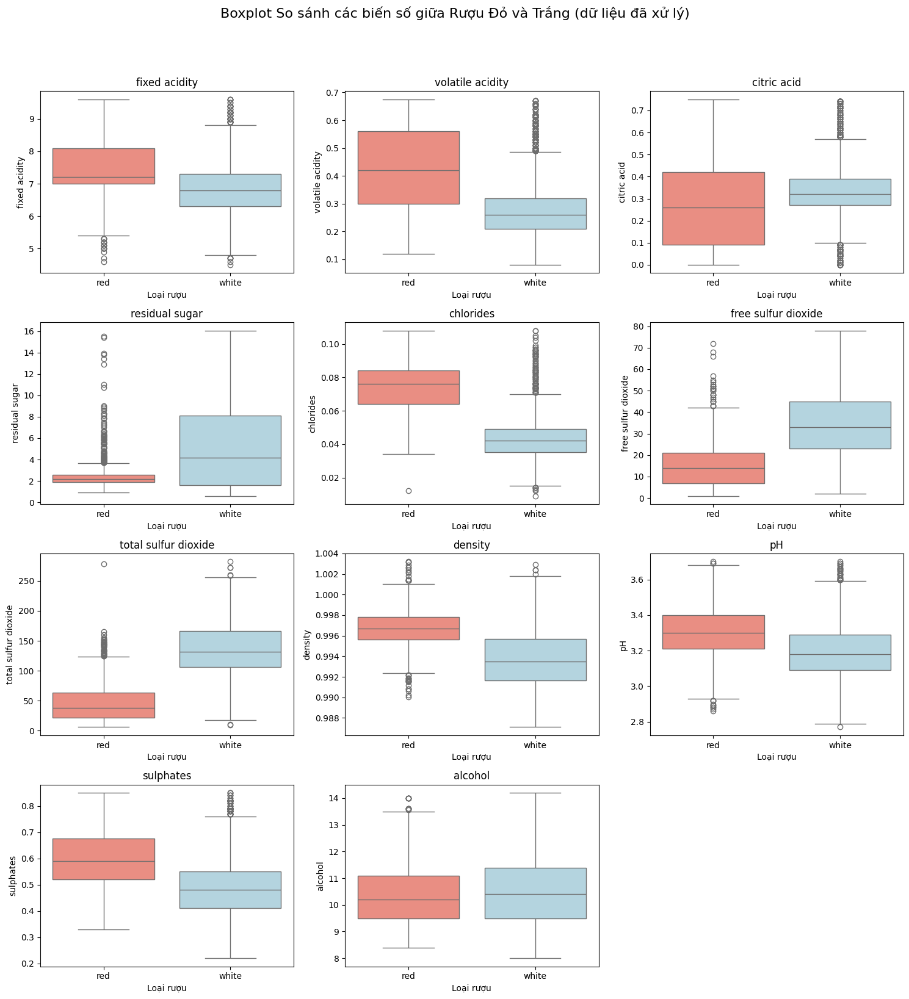

In [ ]:
print("\n#### Biểu đồ Boxplot (So sánh giữa 2 loại rượu - DỮ LIỆU ĐÃ LÀM SẠCH) ####")

numeric_features: List[str] = data_cleaned.select_dtypes(include=np.number).columns.tolist()
numeric_features_for_plot: List[str] = [col for col in numeric_features if col != 'quality']

num_plots: int = len(numeric_features_for_plot)
rows: int = int(np.ceil(num_plots / 3))

# --- Phần Tính toán và In Thống kê Mô tả/Outlier RIÊNG cho từng loại rượu ---
print("\n--- Thống kê mô tả và Outlier (IQR) RIÊNG cho từng loại rượu (dùng data_cleaned) ---")
for col in numeric_features_for_plot:
    print(f"\n===== Phân tích cột: {col} =====")
    for wine_type in ['red', 'white']:
        # Lọc dữ liệu đã làm sạch cho loại rượu hiện tại và cột hiện tại, bỏ NaN
        current_data_col = data_cleaned.loc[data_cleaned['type'] == wine_type, col].dropna()

        if current_data_col.empty:
            print(f"\n--- {wine_type.capitalize()} Wine ---")
            print(f"Không có dữ liệu hợp lệ cho {col}.")
            continue

        print(f"\n--- {wine_type.capitalize()} Wine ---")
        desc = current_data_col.describe()
        print("Thống kê mô tả:")
        print(desc)

        # Tính toán Outlier dựa trên IQR của nhóm này
        try:
            Q1 = current_data_col.quantile(0.25)
            Q3 = current_data_col.quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR

            # Đếm outliers chỉ trong nhóm này
            outliers_mask_group = (current_data_col < lower_bound) | (current_data_col > upper_bound)
            num_outliers = outliers_mask_group.sum()

            print(f"\nOutliers (theo IQR của nhóm {wine_type}):")
            print(f"  Ngưỡng dưới: {lower_bound:.2f}")
            print(f"  Ngưỡng trên: {upper_bound:.2f}")
            print(f"  Số lượng outliers trong nhóm {wine_type}: {num_outliers}")
        except Exception as e:
            print(f"Lỗi khi tính outlier cho '{col}' ({wine_type}): {e}")

# --- Phần Vẽ Boxplot SO SÁNH giữa 2 loại rượu ---
print("\n\n--- Vẽ Boxplot So Sánh giữa Rượu Đỏ và Trắng (dùng data_cleaned) ---")
plt.figure(figsize=(15, rows * 4))
plt.suptitle("Boxplot So sánh các biến số giữa Rượu Đỏ và Trắng (dữ liệu đã xử lý)", fontsize=16, y=1.02)

for i, col in enumerate(numeric_features_for_plot):
    plt.subplot(rows, 3, i + 1)
    sns.boxplot(
        data=data_cleaned,
        x='type',
        y=col,
        hue='type',
        palette={'red': 'salmon', 'white': 'lightblue'},
        legend=False
    )
    plt.title(f"{col}")
    plt.xlabel("Loại rượu")
    plt.ylabel(col)

plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


**Nhận xét boxplot sau khi xử lý dữ liệu:**

Biểu đồ boxplot sau khi dữ liệu đã được làm sạch (sử dụng data_cleaned) cung cấp một cách trực quan để so sánh phân bố của từng biến số hóa lý giữa hai loại rượu vang đỏ (red) và trắng (white). Mặc dù các con số thống kê mô tả và số lượng outlier tính theo IQR cho từng nhóm riêng biệt không thay đổi so với phân tích trước đó, hình ảnh boxplot vẫn làm nổi bật các đặc điểm phân bố và sự khác biệt cốt lõi giữa hai loại rượu:

- **Hiệu quả chung của Capping**: Quá trình capping đã thành công trong việc **thu hẹp đáng kể phạm vi giá trị (min-max)** của nhiều biến, đặc biệt là ở phía giá trị tối đa (max), cho các biến có nhiều outlier ban đầu như residual sugar (White: max giảm từ 65.8 xuống 16.05), chlorides (Red: max giảm từ 0.611 xuống 0.108; White: max giảm từ 0.346 xuống 0.108), free sulfur dioxide (White: max giảm từ 289 xuống 78), total sulfur dioxide (White: max giảm từ 440 xuống 282), density (White: max giảm từ 1.039 xuống 1.003), sulphates (Red: max giảm từ 2.00 xuống 0.85), volatile acidity (Red: max giảm từ 1.58 xuống 0.675).

- **Giảm độ phân tán**: Đối với nhiều biến, **độ lệch chuẩn (std) đã giảm xuống** sau khi capping, cho thấy dữ liệu trở nên tập trung hơn quanh giá trị trung tâm. Ví dụ rõ rệt là fixed acidity (Red), volatile acidity (Red), chlorides (cả Red và White), sulphates (Red).

- **Giảm số lượng Outlier (Theo cách đếm này)**: Số lượng outlier được tính theo IQR sau khi capping đã **giảm đáng kể hoặc bị loại bỏ hoàn toàn** ở nhiều trường hợp, ví dụ: volatile acidity (Red), citric acid (Red), residual sugar (White), chlorides (Red), free sulfur dioxide (White), sulphates (Red). Mặc dù một số biến vẫn còn outlier (có thể do các điểm nằm ngay sát ngưỡng mới), nhưng các giá trị cực đoan nhất đã được kiểm soát.

- **Đặc điểm phân bố sau xử lý**:

  - **Sự khác biệt giữa Red và White**: Ngay cả sau khi làm sạch outlier, sự khác biệt cốt lõi về phân bố giữa rượu đỏ và trắng vẫn rất rõ ràng qua boxplot:

    - Red vẫn có fixed acidity, volatile acidity, chlorides, density, sulphates cao hơn và pH thấp hơn White.

    - White vẫn có citric acid (median cao hơn), residual sugar, free/total sulfur dioxide cao hơn Red.

    - alcohol vẫn có phân bố tương đối giống nhau giữa hai loại.
  
  - **Hình dạng phân bố**: Các hộp (IQR) và vị trí đường trung vị (median) giờ đây phản ánh phân bố của dữ liệu đã được "làm gọn", ít bị ảnh hưởng bởi các điểm quá xa. Ví dụ, hộp của residual sugar (White) giờ đây đại diện cho phạm vi giá trị thực tế hơn nhiều so với trước kia.

**Tóm lại**: Biểu đồ boxplot của dữ liệu sau khi xử lý outlier (data_cleaned) cho thấy một bức tranh **ổn định và đáng tin cậy hơn** về phân bố của các biến hóa lý. Việc capping đã thành công trong việc **giới hạn các giá trị cực đoan, giảm độ phân tán và số lượng outlier rõ rệt** ở nhiều biến. Mặc dù vậy, các **khác biệt đặc trưng về mặt hóa học giữa rượu vang đỏ và trắng vẫn được bảo tồn và thể hiện rõ ràng**, cung cấp cơ sở vững chắc cho các phân tích so sánh và mô hình hóa tiếp theo.


--- Ma trận tương quan Spearman giữa các cột số (toàn bộ dữ liệu) ---
                      fixed acidity  volatile acidity  citric acid  \
fixed acidity                  1.00              0.13         0.19   
volatile acidity               0.13              1.00        -0.23   
citric acid                    0.19             -0.23         1.00   
residual sugar                -0.02              0.01         0.06   
chlorides                      0.28              0.35        -0.10   
free sulfur dioxide           -0.19             -0.32         0.12   
total sulfur dioxide          -0.16             -0.28         0.16   
density                        0.36              0.27         0.06   
pH                            -0.22              0.12        -0.29   
sulphates                      0.13              0.23         0.01   
alcohol                       -0.12             -0.04         0.03   
quality                       -0.08             -0.11         0.10   

                  

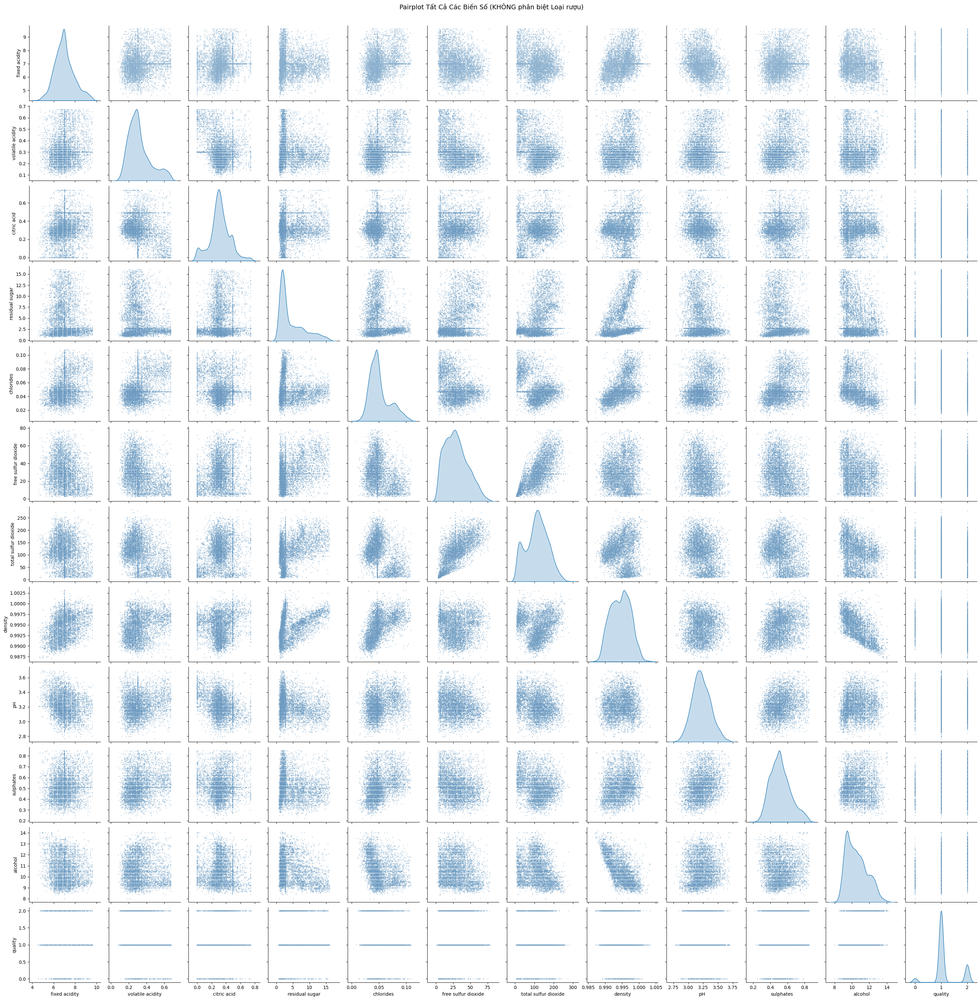

Vẽ Pairplot hoàn tất.

--- Giá trị trung bình của các cột số theo nhóm 'type'---
       fixed acidity  volatile acidity  citric acid  residual sugar  \
type                                                                  
red             7.49              0.44         0.27            2.52   
white           6.83              0.28         0.33            5.35   

       chlorides  free sulfur dioxide  total sulfur dioxide  density    pH  \
type                                                                         
red         0.07                15.89                  46.7     1.00  3.30   
white       0.04                34.09                 136.8     0.99  3.19   

       sulphates  alcohol  quality  
type                                
red         0.61    10.43     1.09  
white       0.49    10.59     1.16  


In [ ]:
# --- Tính ma trận tương quan Spearman (trên toàn bộ dữ liệu 'data_cleaned') ---
# (Vẫn giữ phần tính corr để tham khảo)
numeric_cols: List[str] = data_cleaned.select_dtypes(include=np.number).columns.tolist()
print("\n--- Ma trận tương quan Spearman giữa các cột số (toàn bộ dữ liệu) ---")
try:
    corr_matrix_spearman = data_cleaned[numeric_cols].corr(method='spearman')
    print(corr_matrix_spearman.round(2))
except Exception as e:
    print(f"Lỗi khi tính ma trận tương quan Spearman: {e}")
    corr_matrix_spearman = None

# --- Vẽ Pairplot GỘP KHÔNG dùng hue cho TẤT CẢ CỘT SỐ ---
print("\n--- Vẽ Pairplot GỘP cho TẤT CẢ cột số (KHÔNG phân biệt loại rượu) ---")

# Chọn TẤT CẢ các cột số (đã lấy ở trên là numeric_cols)
# Lọc DataFrame chỉ chứa các cột số này
pairplot_data_all_numeric = data_cleaned[numeric_cols].copy() # Chỉ lấy cột số

try:
    if not pairplot_data_all_numeric.empty:
        print("Đang vẽ Pairplot cho tất cả cột số (không dùng hue)...")
        sns.pairplot(pairplot_data_all_numeric,
                     diag_kind='kde',
                     plot_kws={'alpha': 0.3, 's': 5, 'color': 'steelblue'}) # Giảm alpha/size tối đa, đổi màu
        plt.suptitle("Pairplot Tất Cả Các Biến Số (KHÔNG phân biệt Loại rượu)", y=1.01, fontsize=14) # Điều chỉnh y title
        # Cân nhắc lưu file thay vì show trực tiếp
        # plt.savefig('pairplot_all_numeric_no_hue.png', dpi=100)
        plt.show()
        print("Vẽ Pairplot hoàn tất.")
    else:
        print("Không có dữ liệu số để vẽ pairplot.")
except Exception as e:
     print(f"Lỗi khi vẽ pairplot không dùng hue cho tất cả cột số: {e}")

# --- (Phần tính trung bình nhóm theo type vẫn có thể giữ lại) ---
if 'type' in data_cleaned.columns and data_cleaned['type'].dtype == 'object':
    print("\n--- Giá trị trung bình của các cột số theo nhóm 'type'---")
    try:
        numeric_cols_for_mean_type = data_cleaned.select_dtypes(include=np.number).columns
        mean_by_type = data_cleaned.groupby('type')[numeric_cols_for_mean_type].mean()
        print(mean_by_type.round(2))
    except Exception as e:
        print(f"Lỗi khi tính giá trị trung bình theo nhóm 'type': {e}")
else:
    print("Không thể tính giá trị trung bình theo nhóm 'type'.")


--- EDA - Pairplot GỘP (TẤT CẢ CỘT SỐ, hue='type') - SAU xử lý outlier ---
*** Thực hiện trên dữ liệu sau khi tải/gộp/xử lý thiếu/trùng lặp, SAU khi xử lý outlier ***

--- Ma trận tương quan Spearman giữa các cột số (toàn bộ dữ liệu) ---
                      fixed acidity  volatile acidity  citric acid  \
fixed acidity                  1.00              0.13         0.19   
volatile acidity               0.13              1.00        -0.23   
citric acid                    0.19             -0.23         1.00   
residual sugar                -0.02              0.01         0.06   
chlorides                      0.28              0.35        -0.10   
free sulfur dioxide           -0.19             -0.32         0.12   
total sulfur dioxide          -0.16             -0.28         0.16   
density                        0.36              0.27         0.06   
pH                            -0.22              0.12        -0.29   
sulphates                      0.13              0.23        

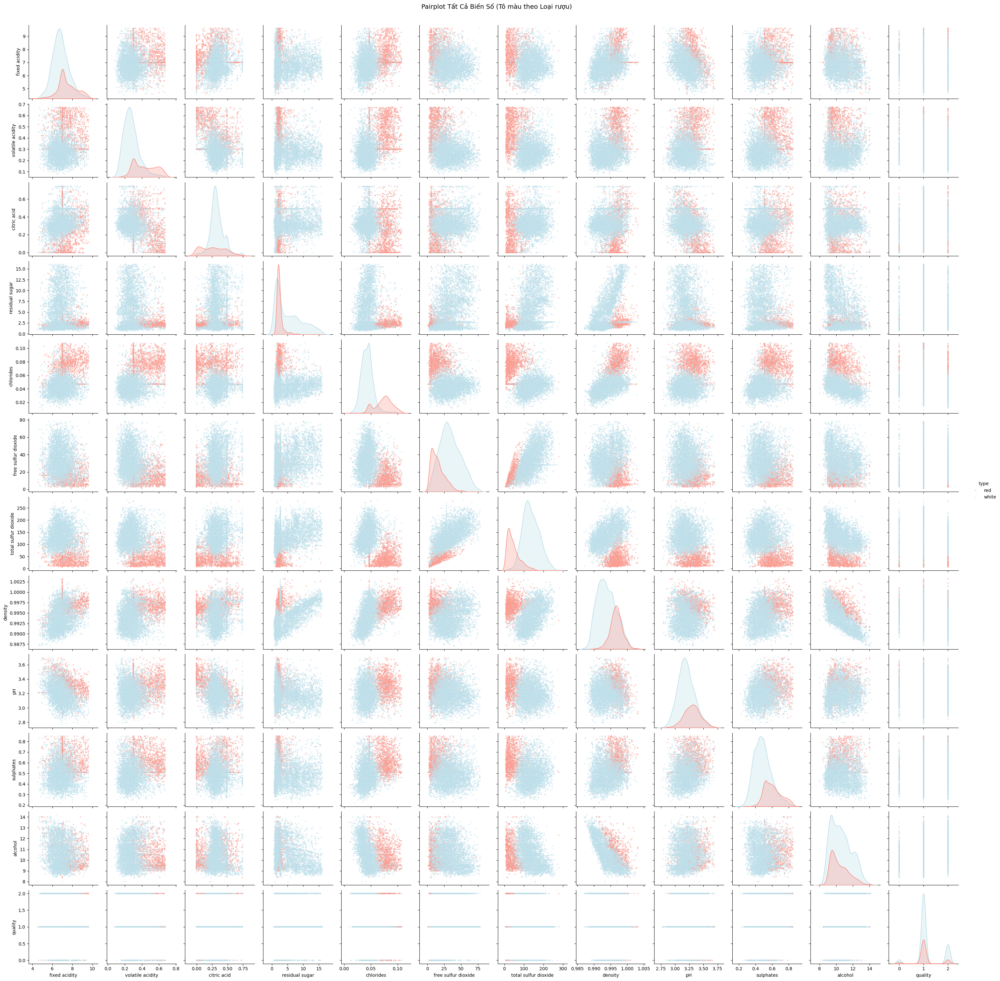

Vẽ Pairplot hoàn tất.

--- Giá trị trung bình của các cột số theo nhóm 'type'---
       fixed acidity  volatile acidity  citric acid  residual sugar  \
type                                                                  
red             7.49              0.44         0.27            2.52   
white           6.83              0.28         0.33            5.35   

       chlorides  free sulfur dioxide  total sulfur dioxide  density    pH  \
type                                                                         
red         0.07                15.89                  46.7     1.00  3.30   
white       0.04                34.09                 136.8     0.99  3.19   

       sulphates  alcohol  quality  
type                                
red         0.61    10.43     1.09  
white       0.49    10.59     1.16  


In [ ]:
print("\n--- EDA - Pairplot GỘP (TẤT CẢ CỘT SỐ, hue='type') - SAU xử lý outlier ---")
print("*** Thực hiện trên dữ liệu sau khi tải/gộp/xử lý thiếu/trùng lặp, SAU khi xử lý outlier ***")

# --- Tính ma trận tương quan Spearman (trên toàn bộ dữ liệu 'data_cleaned') ---
# (Vẫn giữ phần tính corr để tham khảo)
numeric_cols: List[str] = data_cleaned.select_dtypes(include=np.number).columns.tolist()
print("\n--- Ma trận tương quan Spearman giữa các cột số (toàn bộ dữ liệu) ---")
try:
    corr_matrix_spearman = data_cleaned[numeric_cols].corr(method='spearman')
    print(corr_matrix_spearman.round(2))
except Exception as e:
    print(f"Lỗi khi tính ma trận tương quan Spearman: {e}")
    corr_matrix_spearman = None

# --- Vẽ Pairplot GỘP với hue là 'type' cho TẤT CẢ CỘT SỐ ---
print("\n--- Vẽ Pairplot GỘP cho TẤT CẢ cột số với màu sắc (hue) dựa trên loại rượu ('type') ---")

# Chọn TẤT CẢ các cột số VÀ cột 'type'
cols_for_pairplot_all_type_hue: List[str]
if 'type' in data_cleaned.columns:
    cols_for_pairplot_all_type_hue = numeric_cols + ['type'] # Lấy tất cả cột số + 'type'
    print(f"Chuẩn bị vẽ Pairplot cho các cột: {cols_for_pairplot_all_type_hue}")
    # Tạo bản sao dữ liệu chỉ với các cột cần thiết
    pairplot_data_all_type_hue = data_cleaned[cols_for_pairplot_all_type_hue].copy()
else:
    print("Lỗi: Không tìm thấy cột 'type' trong DataFrame 'data' để dùng làm hue.")
    pairplot_data_all_type_hue = None

# Vẽ Pairplot
if pairplot_data_all_type_hue is not None and not pairplot_data_all_type_hue.empty:
    print("Đang vẽ Pairplot (Tất cả cột số, hue='type')...")
    try:
        sns.pairplot(pairplot_data_all_type_hue,
                     hue='type',                 # Dùng 'type' làm hue
                     palette={'red':'salmon', 'white':'lightblue'}, # Màu cho red/white
                     diag_kind='kde',
                     plot_kws={'alpha': 0.4, 's': 10}) # Giảm alpha/size tối đa
        plt.suptitle("Pairplot Tất Cả Biến Số (Tô màu theo Loại rượu)", y=1.01, fontsize=14) # Điều chỉnh y title

        # plt.savefig('pairplot_all_numeric_type_hue.png', dpi=100)

        plt.show()
        print("Vẽ Pairplot hoàn tất.")
    except Exception as e:
         print(f"Lỗi khi vẽ pairplot với hue='type' cho tất cả cột số: {e}")
else:
    print("Không thể vẽ pairplot do thiếu dữ liệu hoặc cột 'type'.")

# --- Tính giá trị trung bình nhóm theo type (vẫn hữu ích) ---
if 'type' in data_cleaned.columns and data_cleaned['type'].dtype == 'object':
    print("\n--- Giá trị trung bình của các cột số theo nhóm 'type'---")
    try:
        numeric_cols_for_mean_type = data_cleaned.select_dtypes(include=np.number).columns
        mean_by_type = data_cleaned.groupby('type')[numeric_cols_for_mean_type].mean()
        print(mean_by_type.round(2))
    except Exception as e:
        print(f"Lỗi khi tính giá trị trung bình theo nhóm 'type': {e}")
else:
    print("Không thể tính giá trị trung bình theo nhóm 'type'.")


**Nhận xét Pairplot SAU KHI xử lý dữ liệu:**

**1. Ảnh hưởng của Xử lý Outlier:**

  - Trực quan: Biểu đồ Pairplot sau xử lý được kỳ vọng sẽ rõ ràng và "gọn gàng" hơn đáng kể. Việc capping các giá trị ngoại lai giúp thu hẹp phạm vi trục (axis ranges) của nhiều biến (như residual sugar, chlorides, SO2...), làm cho phần lớn các điểm dữ liệu tập trung hơn và dễ quan sát hơn. Các điểm cực đoan bị "kéo" về gần hơn, giảm nhiễu và làm nổi bật các xu hướng chính.

  - Phân bố: Các biểu đồ KDE trên đường chéo sẽ có đuôi ngắn hơn, phản ánh đúng hơn phân bố của phần lớn dữ liệu sau khi đã giới hạn các giá trị rất cao hoặc rất thấp.

**2. Phân bố theo Nhóm Loại Rượu (type) (Quan sát trên Đường chéo - KDEs):**

  - **Xác nhận sự khác biệt nhóm**: Ngay cả sau khi capping, các biểu đồ KDE tiếp tục khẳng định sự khác biệt rõ rệt về đặc tính hóa lý giữa rượu vang đỏ và trắng:

    - **Axit**: Vang đỏ vẫn có fixed acidity và volatile acidity cao hơn (dù max của VA đỏ giảm nhiều). citric acid vẫn có sự khác biệt về hình dạng phân bố.

    - **Đường & Muối**: residual sugar vẫn cho thấy sự **tương phản lớn**: đỏ tập trung ở mức rất thấp, trắng có phân bố rộng hơn nhưng giá trị tối đa đã giảm mạnh (từ 65.8 xuống 16.05). chlorides vẫn cao hơn hẳn ở vang đỏ, nhưng phạm vi đã thu hẹp nhiều ở cả hai loại.

    - **SO2**: Sự khác biệt về free sulfur dioxide và total sulfur dioxide vẫn rất lớn (trắng cao hơn), nhưng các giá trị tối đa (đặc biệt của trắng) đã giảm đáng kể.

    - **Các chỉ số khác**: density và pH duy trì sự ổn định và khác biệt nhỏ (đỏ đặc hơn, pH thấp hơn). sulphates vẫn cao hơn ở vang đỏ, nhưng giá trị max đã giảm mạnh. alcohol vẫn khá tương đồng, phạm vi max thu hẹp nhẹ.

    - **quality (đã chuyển thành 0-1-2)**: Phân bố không thay đổi, tập trung ở mức 1 ('Medium'). Phân bố KDE cho thấy sự khác biệt nhỏ, với rượu trắng có tỷ lệ nhóm 2 ('High') cao hơn một chút.
  
**3. Mối quan hệ Cặp biến theo Nhóm Loại Rượu (type) (Quan sát ngoài Đường chéo - Scatters):**

  - **Tương quan nổi bật (ít thay đổi)**: Các mối tương quan vật lý/hóa học mạnh mẽ vẫn được thể hiện rõ ràng:

    - **density vs alcohol (ρ ≈ -0.68)**: Mối quan hệ nghịch biến, gần tuyến tính rất rõ ràng và chặt chẽ ở cả hai loại rượu. Xử lý outlier ít ảnh hưởng đến mối quan hệ vật lý cơ bản này.

    - **free sulfur dioxide vs total sulfur dioxide (ρ ≈ 0.74 trước, 0.73 sau)**: Mối quan hệ **dương** mạnh mẽ, nhưng có thể thấy rõ hai cụm điểm đỏ và trắng có độ dốc hoặc vị trí khác nhau, phản ánh cách sử dụng SO2 khác biệt.

  - **Tương quan với quality (Có thay đổi)**:

    - **alcohol và quality**: Tương quan **giảm nhẹ** từ **0.48 (trước) xuống 0.37 (sau)**. Mặc dù vậy, xu hướng dương (cồn cao hơn - chất lượng cao hơn) trên scatter plot có thể trở nên nhất quán hơn do loại bỏ ảnh hưởng của các outlier cồn/chất lượng nếu có.

    - **density và quality**: Tương quan âm **yếu đi một chút** từ **-0.35 xuống -0.28**. Xu hướng âm (tỷ trọng thấp hơn - chất lượng cao hơn) vẫn có thể nhìn thấy nhưng yếu hơn.

    - **chlorides và quality (ρ ≈ -0.23)**: Tương quan âm **yếu đi** từ **-0.30 xuống -0.23**.

    - **volatile acidity và quality (ρ ≈ -0.11)**: Tương quan âm **yếu đi đáng kể** từ **-0.25 xuống -0.11**. Việc capping các giá trị VA rất cao (thường đi với chất lượng thấp) có thể đã làm giảm mối quan hệ đơn điệu về thứ hạng.

    - *Nhận xét chung*: Việc capping outlier dường như làm **giảm nhẹ độ lớn** của các hệ số tương quan Spearman giữa các biến hóa lý và quality. Điều này có thể do outlier ban đầu (ví dụ: VA rất cao đi với quality rất thấp) đã "kéo" thứ hạng theo một hướng nhất định, và việc capping đã làm giảm hiệu ứng đó. Tuy nhiên, các xu hướng chính (như alcohol, density với quality) vẫn còn hiện hữu.

  - **Tương tác với type**: Biểu đồ sau xử lý outlier giúp nhìn rõ hơn sự khác biệt giữa hai nhóm màu (đỏ/trắng) mà không bị phân tâm bởi các điểm quá xa. Ví dụ, mối quan hệ giữa density và chlorides (ρ ≈ 0.61) có thể được nhìn nhận rõ hơn là sự kết hợp của sự khác biệt giữa hai loại rượu (đỏ có cả hai cao hơn) và mối quan hệ yếu hơn bên trong từng loại.

**4. Kết luận từ Pairplot (Sau xử lý outlier):**

  - Pairplot sau xử lý outlier cung cấp một cái nhìn **rõ ràng, ổn định và tập trung** vào cấu trúc dữ liệu cốt lõi, làm nổi bật các xu hướng chính mà không bị nhiễu quá nhiều bởi các giá trị cực đoan.

  - Nó **tái khẳng định mạnh mẽ** rằng rượu vang đỏ và trắng là hai quần thể rất khác biệt về mặt hóa lý, đòi hỏi phải xem xét yếu tố type trong hầu hết các phân tích.

  - Các mối quan hệ giữa các chỉ số hóa lý và biến mục tiêu quality (đặc biệt là với alcohol, density, chlorides) được thể hiện rõ ràng hơn về mặt trực quan và ổn định hơn (ít bị ảnh hưởng bởi điểm cực đoan), mặc dù một số hệ số tương quan Spearman có thể giảm nhẹ sau capping. Điều này cung cấp cơ sở vững chắc hơn cho việc lựa chọn biến và xây dựng mô hình.

  - Dữ liệu data_cleaned thể hiện một trạng thái cân bằng hơn, sẵn sàng cho các phân tích thống kê suy luận và mô hình hóa phức tạp hơn.


--- Phân phối giá trị cho cột fixed acidity ---
fixed acidity
(4.495, 5.01]      50
(5.01, 5.52]      139
(5.52, 6.03]      525
(6.03, 6.54]      942
(6.54, 7.05]     1512
(7.05, 7.56]      887
(7.56, 8.07]      600
(8.07, 8.58]      323
(8.58, 9.09]      197
(9.09, 9.6]       145
Name: count, dtype: int64

--- Phân phối giá trị cho cột volatile acidity ---
volatile acidity
(0.0794, 0.14]      95
(0.14, 0.199]      622
(0.199, 0.259]    1132
(0.259, 0.318]    1405
(0.318, 0.378]     730
(0.378, 0.437]     451
(0.437, 0.497]     265
(0.497, 0.556]     212
(0.556, 0.616]     231
(0.616, 0.675]     177
Name: count, dtype: int64

--- Phân phối giá trị cho cột citric acid ---
citric acid
(-0.00075, 0.075]     347
(0.075, 0.15]         270
(0.15, 0.225]         448
(0.225, 0.3]         1488
(0.3, 0.375]         1240
(0.375, 0.45]         640
(0.45, 0.525]         566
(0.525, 0.6]          164
(0.6, 0.675]           73
(0.675, 0.75]          84
Name: count, dtype: int64

--- Phân phối giá tr

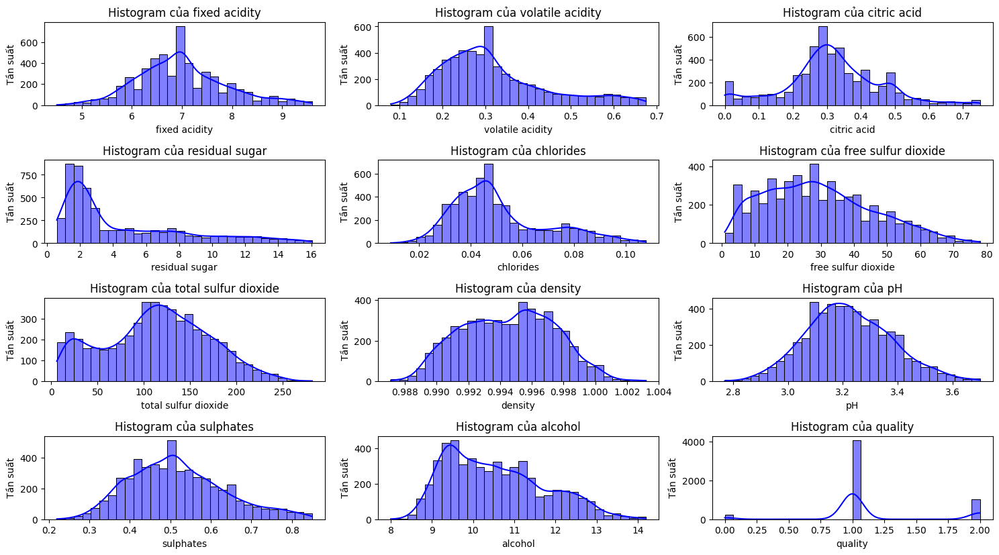

In [ ]:
# Chọn các cột số
num_cols: pd.Index = data_cleaned.select_dtypes(include=['number']).columns

for col in num_cols:
    print(f"\n--- Phân phối giá trị cho cột {col} ---")
    value_counts = pd.cut(data_cleaned[col], bins=10).value_counts().sort_index()
    print(value_counts)

# Thiết lập kích thước
plt.figure(figsize=(15, 10))

# Duyệt qua từng cột số để vẽ histogram
for i, col in enumerate(num_cols, 1): # i: int, col: str
    plt.subplot(len(num_cols) // 3 + 1, 3, i)  # Sắp xếp 3 cột trên mỗi hàng
    sns.histplot(data_cleaned[col], bins=30, kde=True, color='blue')  # Vẽ histogram có KDE
    plt.title(f"Histogram của {col}")
    plt.xlabel(col)
    plt.ylabel("Tần suất")

plt.tight_layout()
plt.show()

**Nhận xét Histogram sau khi xử lý dữ liệu:**

Việc kiểm tra phân phối tần suất giá trị theo các khoảng (bins) sau khi dữ liệu đã được làm sạch bằng phương pháp capping outliers cho thấy những thay đổi đáng chú ý so với dữ liệu gốc, phản ánh hiệu quả của việc kiểm soát các giá trị cực đoan. Bảng phân phối tần suất này hiện đại diện cho dữ liệu đã được ổn định hóa:

- **fixed acidity**: Đỉnh phân bố vẫn nằm trong khoảng (6.54, 7.05] (1512 mẫu) và (6.03, 6.54] (942 mẫu). Số lượng mẫu ở các khoảng giá trị cao nhất (ví dụ: trên 12.27) đã giảm hoặc bị loại bỏ (do max mới là 9.6), và các mẫu bị capping có thể đã được chuyển vào khoảng (9.09, 9.6]. Hình dạng phân bố trở nên **gọn hơn ở đuôi phải**.

- **volatile acidity**: Đỉnh phân bố nằm ở khoảng (0.259, 0.318] (1405 mẫu). Số lượng mẫu ở các khoảng giá trị rất cao (trên 0.98) đã bị loại bỏ hoàn toàn (do max mới là 0.675), các mẫu bị capping được chuyển vào khoảng (0.616, 0.675]. Tính **lệch phải đã giảm rõ rệt**.

- **citric acid**: Đỉnh phân bố vẫn nằm ở (0.225, 0.3] (1488 mẫu) và (0.3, 0.375] (1240 mẫu). Các mẫu có giá trị rất cao (trên 0.996) đã bị loại bỏ (max mới là 0.75). Hình dạng **tương đối đối xứng** được duy trì nhưng **gọn hơn ở đuôi phải**.

- **residual sugar**: Phân bố vẫn **lệch phải mạnh**, đỉnh nằm ở khoảng đầu tiên (0.585, 2.145] (1996 mẫu). Tuy nhiên, các khoảng giá trị rất cao (trên 20.16) không còn mẫu nào (ngoại trừ giá trị max mới là 16.05), cho thấy hiệu quả của capping trong việc **loại bỏ các giá trị cực đoan nhất**.

- **chlorides**: Phân bố vẫn **lệch phải mạnh**, đỉnh ở khoảng (0.0387, 0.0486] (1659 mẫu). Các khoảng giá trị rất cao (trên 0.129) đã bị loại bỏ hoàn toàn (max mới là 0.108). Đuôi phải đã được **thu gọn đáng kể**.

- **free sulfur dioxide**: Phân bố vẫn **lệch phải**, đỉnh ở khoảng (16.4, 24.1] (911 mẫu). Các khoảng giá trị rất cao (trên 116.2) đã bị loại bỏ (max mới là 78.0). **Đuôi phải ngắn hơn rõ rệt**.

- **total sulfur dioxide**: Đỉnh phân bố nằm ở hai khoảng (88.8, 116.4] (1036 mẫu) và (116.4, 144.0] (1030 mẫu), hình dạng **tương đối đối xứng**. Các khoảng giá trị rất cao (trên 254.4) chỉ còn rất ít mẫu (max mới là 282.0).

- **density**: Phân bố **rất đối xứng và tập trung**, đỉnh ở khoảng (0.995, 0.997] (1056 mẫu) và (0.997, 0.998] (854 mẫu). Số lượng mẫu ở các khoảng giá trị rất cao (trên 1.003) đã giảm mạnh.

- **pH**: Phân bố **rất đối xứng**, đỉnh ở (3.142, 3.235] (1260 mẫu). Số lượng mẫu ở cả hai đầu phân phối (rất thấp < 2.863 và rất cao > 3.607) đã giảm, làm cho phân bố **gọn hơn ở cả hai đuôi**.

- **sulphates**: Phân bố vẫn **lệch phải**, đỉnh ở (0.472, 0.535] (1158 mẫu). Các khoảng giá trị rất cao (trên 0.932) đã bị loại bỏ (max mới là 0.85). **Đuôi phải được thu gọn đáng kể**.

- **alcohol**: Phân bố vẫn **hơi lệch phải**, đỉnh ở khoảng (9.24, 9.86] (1187 mẫu). Khoảng giá trị cao nhất (14.21, 14.9] đã bị loại bỏ (max mới là 14.2).

- **quality (Sau khi phân loại 0, 1, 2)**: Đây là biến có sự thay đổi rõ rệt nhất về phân phối do quá trình xử lý. Dữ liệu sau khi được nhóm lại cho thấy:
  - Nhóm 0 (Chất lượng thấp): Có 236 mẫu (khoảng (-0.002, 0.2] trong cách binning này).

  - Nhóm 1 (Chất lượng trung bình): Có 4075 mẫu (khoảng (0.8, 1.0]).

  - **Nhóm 2 (Chất lượng cao)**: Có 1009 mẫu (khoảng (1.8, 2.0]). Điều này xác nhận rằng phần lớn rượu vang trong bộ dữ liệu này thuộc nhóm chất lượng **trung bình (nhóm 1)**, tiếp theo là nhóm chất lượng cao (nhóm 2), và nhóm chất lượng thấp (nhóm 0) chiếm tỷ lệ nhỏ nhất.

**Nhìn chung**: Việc xem xét histogram sau xử lý (qua bảng tần suất) cho thấy rõ hiệu quả của việc capping outlier. Hình dạng tổng thể của nhiều phân phối trở nên **gọn gàng hơn, ít lệch hơn, và tập trung hơn** do các giá trị cực đoan đã bị giới hạn, tạo nền tảng dữ liệu tốt hơn cho các phân tích sau.


#### Biểu đồ Cột cho biến Categorical/Ordinal (object) ####

Tần suất các giá trị trong biến phân loại/thứ bậc:

--- Tần suất các giá trị trong cột 'type' ---
type
red      1359
white    3961
Name: count, dtype: int64

--- Tần suất các giá trị trong cột 'quality' ---
quality
0     236
1    4075
2    1009
Name: count, dtype: int64

Vẽ Biểu đồ Cột:


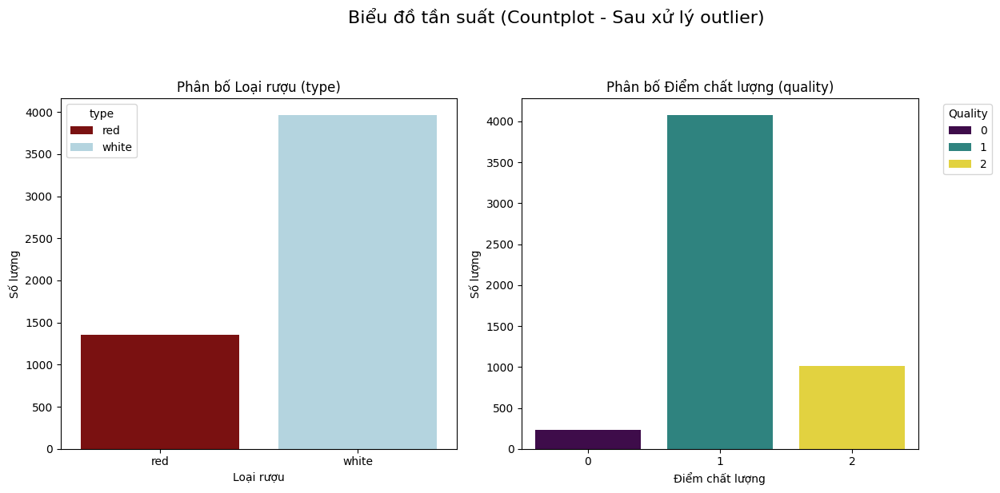


#### Biểu đồ Tròn (Donut Chart - Sau xử lý outlier) ####

--- Vẽ Biểu đồ Tròn cho biến 'type' ---
Phân bố của cột 'type':
Giá trị        Số lượng       Tỷ lệ (%) 
----------------------------------------
white          3961            74.45%
red            1359            25.55%


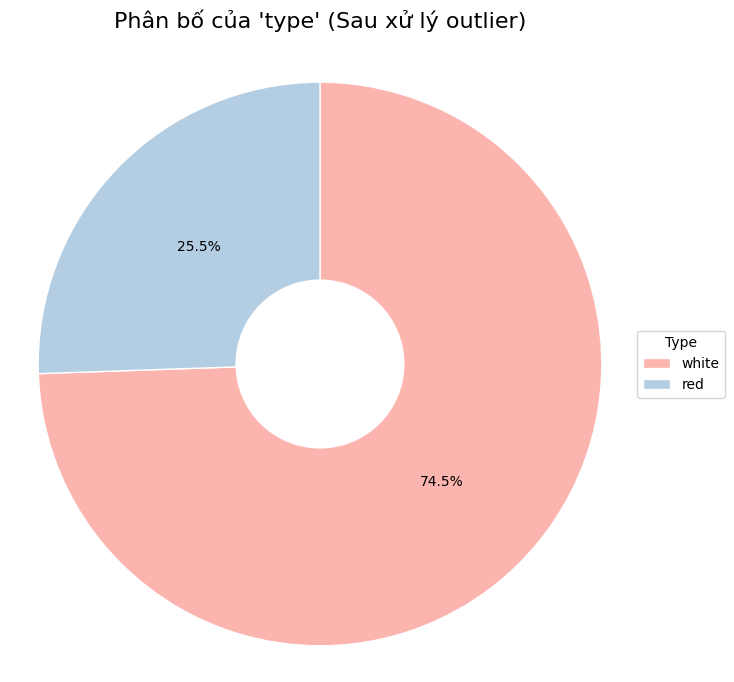


--- Vẽ Biểu đồ Tròn cho biến 'quality' ---
Phân bố của cột 'quality':
Giá trị        Số lượng       Tỷ lệ (%) 
----------------------------------------
0              236              4.44%
1              4075            76.60%
2              1009            18.97%


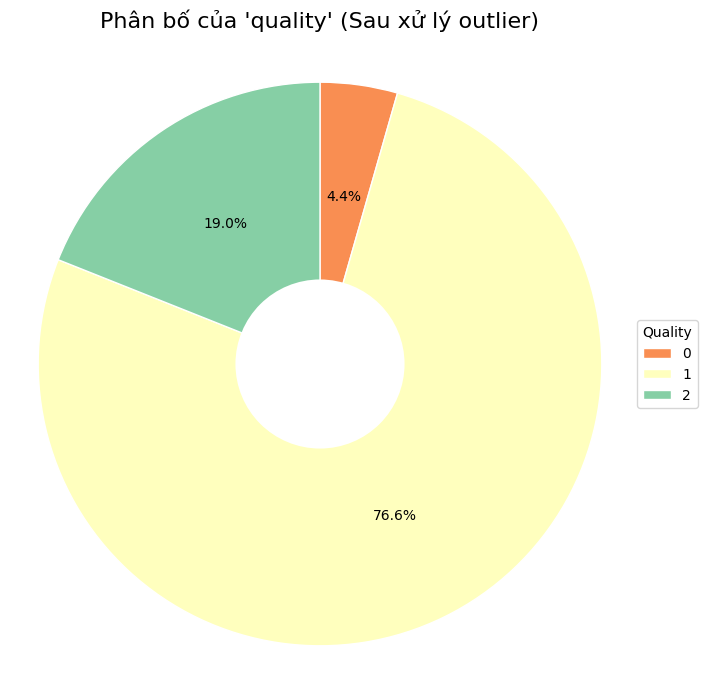

In [ ]:
print("\n#### Biểu đồ Cột cho biến Categorical/Ordinal (object) ####")

# Biến phân loại/thứ bậc cần vẽ
categorical_plot_list: List[str] = ['type', 'quality']

print("\nTần suất các giá trị trong biến phân loại/thứ bậc:")
for col in categorical_plot_list:
    print(f"\n--- Tần suất các giá trị trong cột '{col}' ---")
    print(data_cleaned[col].value_counts().sort_index())

# --- Vẽ Biểu đồ Cột (Countplots) ---
print("\nVẽ Biểu đồ Cột:")
plt.figure(figsize=(14, 6))
plt.suptitle("Biểu đồ tần suất (Countplot - Sau xử lý outlier)", fontsize=16, y=1.02)

# Biểu đồ cho 'type'
plt.subplot(1, 2, 1)
sns.countplot(x=data_cleaned['type'], hue=data_cleaned['type'],
              palette={'red': 'darkred', 'white': 'lightblue'}, legend=True)
plt.title("Phân bố Loại rượu (type)")
plt.xlabel("Loại rượu")
plt.ylabel("Số lượng")

# Biểu đồ cho 'quality'
plt.subplot(1, 2, 2)
sns.countplot(x=data_cleaned['quality'], hue=data_cleaned['quality'],
              palette='viridis', legend=True)
plt.title("Phân bố Điểm chất lượng (quality)")
plt.xlabel("Điểm chất lượng")
plt.ylabel("Số lượng")
# Điều chỉnh legend cho quality
handles, labels = plt.gca().get_legend_handles_labels()
try:
    unique_labels = sorted(list(set(labels)), key=int)
    unique_handles = [handles[labels.index(lab)] for lab in unique_labels]
    plt.legend(unique_handles, unique_labels, title='Quality', bbox_to_anchor=(1.05, 1), loc='upper left')
except ValueError:
    plt.legend(handles, labels, title='Quality', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout(rect=[0, 0, 0.9, 0.96])
plt.show()

# --- Vẽ Biểu đồ Tròn (Donut Chart) cho cả 'type' và 'quality'  ---
print("\n#### Biểu đồ Tròn (Donut Chart - Sau xử lý outlier) ####")

for col_pie in ['type', 'quality']:  # Lặp qua cả hai biến
    print(f"\n--- Vẽ Biểu đồ Tròn cho biến '{col_pie}' ---")
    if col_pie in data_cleaned.columns:
        if col_pie == 'quality':
            value_counts = data_cleaned[col_pie].value_counts().sort_index(ascending=True)
        else:
            value_counts = data_cleaned[col_pie].value_counts().sort_values(ascending=False)

        labels = value_counts.index
        sizes = value_counts.values
        total = sizes.sum()

        # In bảng tóm tắt
        print(f"Phân bố của cột '{col_pie}':")
        print(f"{'Giá trị':<15}{'Số lượng':<15}{'Tỷ lệ (%)':<10}")
        print("-" * 40)
        for val, count in value_counts.items():
            percentage = (count / total) * 100
            print(f"{str(val):<15}{count:<15}{percentage:>6.2f}%")

        # Vẽ biểu đồ tròn
        plt.figure(figsize=(8, 8))
        colors = sns.color_palette("Spectral", len(labels)) if col_pie == 'quality' else sns.color_palette("Pastel1", len(labels))

        plt.pie(
            sizes,
            autopct='%1.1f%%',
            startangle=90,
            counterclock=False,
            colors=colors,
            wedgeprops={'linewidth': 1, 'edgecolor': 'white'}
        )

        # Vẽ Donut
        centre_circle = plt.Circle((0, 0), 0.30, fc='white')
        fig = plt.gcf()
        fig.gca().add_artist(centre_circle)

        plt.axis('equal')
        plt.title(f"Phân bố của '{col_pie}' (Sau xử lý outlier)", fontsize=16, pad=20)
        plt.legend(labels, title=col_pie.capitalize(), loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
        plt.show()

    else:
        print(f"Không tìm thấy cột '{col_pie}' trong dữ liệu gốc.")


**Biểu đồ Cột (Sau xử lý)**

Biểu đồ cột được sử dụng để trực quan hóa tần suất xuất hiện của các giá trị trong các biến phân loại hoặc thứ bậc. Sau quá trình làm sạch dữ liệu (capping outlier trên các biến số liên tục), chúng ta kiểm tra lại phân bố của các biến phân loại chính:

- **type (Loại rượu):**

  - **Tần suất**: Vang đỏ (red) có 1359 mẫu, Vang trắng (white) có 3961 mẫu.

  - **Nhận xét**: Phân bố này **không thay đổi** so với trước khi xử lý outlier, điều này là hợp lý vì capping các biến số không ảnh hưởng đến giá trị của biến type hay số lượng mẫu của mỗi loại (tổng số mẫu sau xử lý là 5320). Biểu đồ cột cho type tiếp tục cho thấy sự **chiếm ưu thế rõ rệt về số lượng của rượu vang trắng** (khoảng 74.45%) so với rượu vang đỏ (khoảng 25.55%) trong bộ dữ liệu đã làm sạch này.

- **quality (Nhóm chất lượng 0, 1, 2):**

  - **Tần suất:**

    - Nhóm 0 (Thấp, ≤4): 236 mẫu

    - Nhóm 1 (Trung bình, 5-6): 4075 mẫu

    - Nhóm 2 (Cao, ≥7): 1009 mẫu

  - **Nhận xét**: Biểu đồ cột cho biến quality sau khi đã được phân thành 3 nhóm cho thấy một bức tranh rõ ràng về phân bố chất lượng trong tập dữ liệu đã làm sạch. Nhóm **chất lượng trung bình (1)** chiếm đa số áp đảo các mẫu rượu. Nhóm chất lượng cao (2) có số lượng đáng kể, nhiều hơn hẳn so với nhóm chất lượng thấp (0), vốn chỉ chiếm một phần nhỏ. Phân bố này cho thấy dữ liệu có phần **mất cân bằng về nhóm chất lượng**, với nhóm trung bình là phổ biến nhất.

**Biểu đồ tròn (Phân bố quality và type - Sau xử lý)**

Biểu đồ tròn (Donut Chart) cung cấp một cách trực quan khác để thể hiện tỷ lệ phần trăm của từng nhóm trong các biến phân loại sau khi dữ liệu đã được làm sạch:

- **Phân bố của cột type:**

  - **Tỷ lệ**: Vang trắng chiếm **74.45%**, Vang đỏ chiếm **25.55%**.

  - **Nhận xét**: Biểu đồ tròn xác nhận lại sự **không cân bằng về số lượng** giữa hai loại rượu, với vang trắng chiếm gần 3/4 bộ dữ liệu. Tỷ lệ này không thay đổi so với trước khi xử lý outlier.

- **Phân bố của cột quality (Sau khi phân nhóm 0, 1, 2):**

  - **Tỷ lệ:**

    - Nhóm 0 (Thấp): **4.44%**

    - Nhóm 1 (Trung bình): **76.60%**

    - Nhóm 2 (Cao): **18.97%**

  - **Nhận xét**: Biểu đồ tròn cho quality sau khi phân nhóm làm nổi bật sự **thống trị của nhóm chất lượng trung bình (1)**, chiếm hơn 3/4 tổng số mẫu. Nhóm chất lượng cao (2) chiếm một phần đáng kể (gần 1/5), trong khi nhóm chất lượng thấp (0) chỉ là một phần rất nhỏ. Cách biểu diễn này (3 lát cắt) khác biệt so với biểu đồ tròn trước đó (vốn có 7 lát cắt theo điểm gốc), giúp tập trung vào sự phân bố theo các hạng mục chất lượng rộng hơn (Thấp/Trung bình/Cao). Sự mất cân bằng này cần được lưu ý khi xây dựng các mô hình dự đoán chất lượng sau này.

## **e) Nhận xét tổng quan về tập dữ liệu**

Dựa trên quá trình khám phá và tiền xử lý dữ liệu (EDA) bao gồm gộp dữ liệu, xử lý thiếu (nếu có), loại bỏ trùng lặp và xử lý ngoại lai (riêng biệt theo loại rượu), chúng ta có thể rút ra các nhận xét tổng quan sau về bộ dữ liệu Wine Quality đã được làm sạch (data_cleaned):

**1. Kích thước và Tính đầy đủ:**

  - Sau khi gộp dữ liệu từ hai nguồn (rượu đỏ và trắng) và loại bỏ **1177 bản ghi trùng lặp**, bộ dữ liệu cuối cùng để phân tích gồm **5320 bản gh**i và **13 thuộc tính** (11 biến hóa lý, 1 biến chất lượng, 1 biến loại rượu).

  - Một điểm thuận lợi là bộ dữ liệu gốc và cả bộ dữ liệu sau khi xử lý **không chứa bất kỳ giá trị thiếu (NaN)** nào, loại bỏ sự cần thiết của các kỹ thuật điền khuyết phức tạp.

  - Quá trình xử lý giá trị ngoại lai đã được áp dụng trên toàn bộ dataset bằng phương pháp **capping (giới hạn giá trị) tại ngưỡng 1.5 lần Khoảng tứ phân vị (IQR)**. Bước này nhằm kiểm soát ảnh hưởng của các giá trị cực đoan lên các phân tích thống kê và mô hình hóa.

**2. Kiểu dữ liệu:**

  - Bộ dữ liệu bao gồm **11 biến số định lượng (numerical)** với kiểu dữ liệu float64, đại diện cho các chỉ số hóa lý của rượu vang.

  - Biến type là **biến định tính (categorical)**, phân biệt giữa 'red' và 'white'. Mặc dù kiểu dữ liệu gốc là object, nó đã được xử lý (ví dụ: mã hóa thành số nguyên 0, 1) trong các bước chuẩn bị cho tính toán tương quan.

  - Biến mục tiêu quality ban đầu là số nguyên (3-9), mang tính **thứ bậc (ordinal)**. Trong một số bước phân tích sau này, nó đã được chuyển đổi thành biến **định tính (categorical)** với 3 cấp độ ('Low', 'Medium', 'High') và sau đó mã hóa thành số (0, 1, 2) để tương thích với các yêu cầu phân tích.

**3. Phân bố biến số định lượng (sau xử lý outliers bằng capping):**

  - **Hiệu quả xử lý**: Việc áp dụng capping đã **thu hẹp đáng kể phạm vi giá trị (min-max)** và **giảm độ lệch chuẩn** cho hầu hết các biến hóa lý, đặc biệt là những biến có nhiều outlier hoặc độ lệch lớn ban đầu như residual sugar (max giảm xuống 16.05), chlorides (max giảm xuống 0.11), volatile acidity (max giảm xuống 0.68), sulphates (max giảm xuống 0.85), free sulfur dioxide (max giảm xuống 78).

  - **Đặc điểm phân bố mới**:

    - Các biến như density (mean≈0.995) và pH (mean≈3.22) duy trì và củng cố thêm tính **đối xứng cao, hình chuông và tập trung**.

    - fixed acidity (mean≈7.00), volatile acidity (mean≈0.32), citric acid (mean≈0.32), total sulfur dioxide (mean≈113.78) và sulphates (mean≈0.52) trở nên **đối xứng hơn hoặc giảm đáng kể độ lệch** so với trạng thái ban đầu.

    - residual sugar và chlorides vẫn giữ tính **lệch phải mạnh**, nhưng đã bớt cực đoan hơn nhiều.

    - alcohol (mean≈10.55) và free sulfur dioxide (mean≈29.44) thay đổi ít hơn nhưng vẫn giữ xu hướng **lệch phải nhẹ**.

  - Nhìn chung, dữ liệu số sau xử lý trở nên **gọn gàng và ổn định hơn**.

**4. Phân bố biến định tính/thứ bậc:**

  - **type**: Dữ liệu **mất cân bằng**, với rượu trắng (3961 mẫu, ~74.5%) chiếm tỷ lệ cao hơn nhiều so với rượu đỏ (1359 mẫu, ~25.5%).

  - quality **(biến gốc 3-9 hoặc đã mã hóa 0-1-2)**: Phân bố **không đều**, tập trung rất mạnh ở các giá trị trung bình (điểm 5 và 6, tương ứng mã 1). Các giá trị chất lượng rất thấp (điểm <=4, mã 0) và rất cao (điểm >=7, mã 2) chiếm tỷ lệ nhỏ hơn đáng kể. Điều này cho thấy sự **mất cân bằng nhãn rõ rệt** nếu sử dụng cho bài toán phân loại 3 lớp. Rượu trắng có xu hướng có tỷ lệ chất lượng cao hơn một chút so với rượu đỏ.

**Kết luận tổng quan:**

  

Bộ dữ liệu Wine Quality sau khi làm sạch (5320 bản ghi) đã được chuẩn bị kỹ lưỡng: không có giá trị thiếu, các giá trị ngoại lai đã được kiểm soát hiệu quả bằng phương pháp capping, và kiểu dữ liệu đã được chuẩn hóa phù hợp (dù cần lưu ý bản chất phân loại của quality và type khi chúng được mã hóa thành số). Dữ liệu thể hiện sự khác biệt rõ rệt giữa rượu vang đỏ và trắng, cùng với sự mất cân bằng đáng kể về loại rượu và nhóm chất lượng. Bộ dữ liệu này hiện đã sẵn sàng cho các giai đoạn phân tích suy luận, kiểm định giả thuyết, phân tích tương quan chi tiết và xây dựng mô hình dự đoán.

# 3) Phân tích phân phối xác suất

#### Phân tích Phân phối Xác suất (Biến 'fixed acidity' và 'pH')

***Lý do chọn 2 biến này***

1. **fixed acidity (Độ axit cố định):**

  - **Tính chất**: Đây là một chỉ số hóa lý quan trọng, đo lường nồng độ các axit không bay hơi trong rượu (như tartaric, malic, citric), góp phần chính vào vị chua tổng thể và cấu trúc của rượu.

  - **Đặc điểm phân phối (từ EDA)**: Quá trình khám phá dữ liệu cho thấy phân phối của fixed acidity có thể trải rộng trên một khoảng giá trị nhất định và có khả năng thể hiện một mức độ đối xứng hoặc hơi lệch nhất định. Việc phân tích chi tiết sẽ giúp xác định rõ hơn hình dạng thực tế của nó và kiểm tra xem nó có tuân theo một phân phối chuẩn hay không.

  - **Mối liên hệ**: Phân tích sơ bộ cũng chỉ ra rằng alcohol có mối liên hệ đáng kể với biến mục tiêu quality, nhấn mạnh thêm tầm quan trọng của việc hiểu rõ hình dạng phân phối của nó.


2. **residual sugar (Đường dư):**

  - **Tính chất**: pH đo lường nồng độ ion hydro hoạt động, phản ánh cường độ axit tổng thể (không chỉ là tổng lượng axit). Nó là một yếu tố quan trọng ảnh hưởng đến sự ổn định, màu sắc và vị của rượu. pH là một thang đo logarit.

  - **Đặc điểm phân phối (từ EDA)**: Do bản chất là thang đo logarit và giá trị pH của rượu vang thường nằm trong một khoảng tương đối hẹp (ví dụ, khoảng 3-4), phân phối của biến pH thường có xu hướng gần với phân phối chuẩn hoặc ít nhất là đối xứng hơn so với các biến đo nồng độ axit trực tiếp. Lựa chọn pH cho phép kiểm tra giả thuyết về tính chuẩn này một cách cụ thể.

  - **Tương phản**: Việc phân tích cả fixed acidity (tổng lượng) và pH (cường độ, thang log) cung cấp một góc nhìn thú vị về cách hai khía cạnh liên quan của tính axit được phân phối khác nhau về mặt thống kê.


**Kết luận**: Cặp biến fixed acidity và pH được chọn vì chúng đại diện cho các khía cạnh hóa học cơ bản và liên quan đến nhau (tính axit) của rượu vang, nhưng có khả năng thể hiện các hình dạng phân phối xác suất khác biệt (một biến có thể lệch hơn, một biến có thể gần chuẩn/đối xứng hơn do thang đo logarit). Điều này cho phép áp dụng và minh họa các kỹ thuật phân tích phân phối trên các loại dữ liệu đa dạng trong dataset Wine Quality.

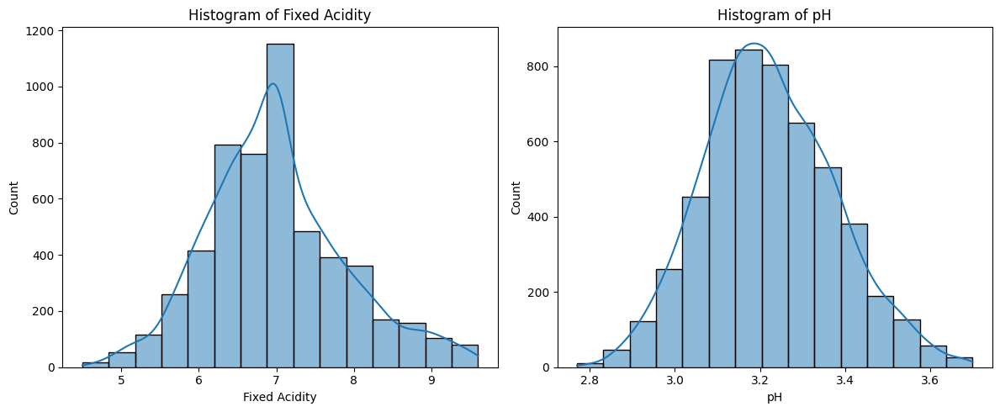

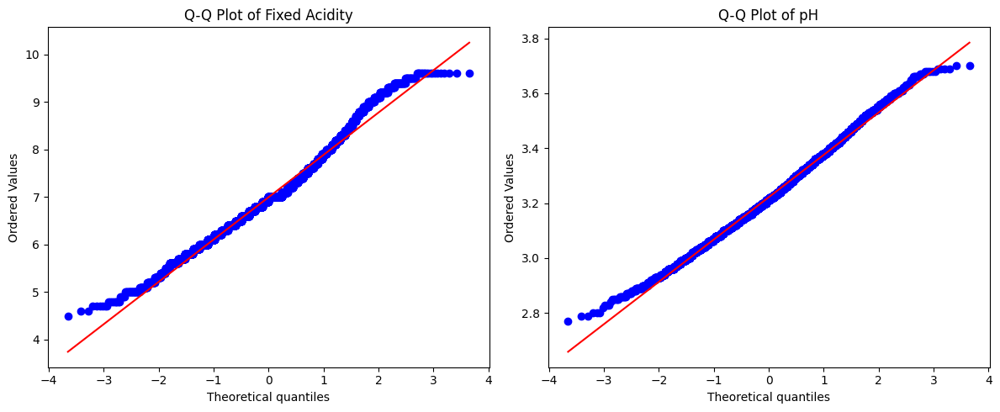

Shapiro-Wilk test for Fixed Acidity: p-value = 0.00000
Shapiro-Wilk test for pH: p-value = 0.00000
--> Fixed Acidity có thể không tuân theo phân phối chuẩn.
--> pH có thể không tuân theo phân phối chuẩn.


/usr/local/lib/python3.11/dist-packages/scipy/stats/_axis_nan_policy.py:573: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 5320.
  res = hypotest_fun_out(*samples, **kwds)


In [ ]:
import scipy.stats as stats

# Vẽ histogram để xem hình dạng phân phối
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

sns.histplot(data_cleaned['fixed acidity'], bins=15, kde=True, ax=axes[0])
axes[0].set_title('Histogram of Fixed Acidity')
axes[0].set_xlabel('Fixed Acidity')

sns.histplot(data_cleaned['pH'], bins=15, kde=True, ax=axes[1])
axes[1].set_title('Histogram of pH')
axes[1].set_xlabel('pH')

plt.tight_layout()
plt.show()

# Q-Q Plot để kiểm tra tính chuẩn
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

stats.probplot(data_cleaned['fixed acidity'], dist="norm", plot=axes[0])
axes[0].set_title("Q-Q Plot of Fixed Acidity")

stats.probplot(data_cleaned['pH'], dist="norm", plot=axes[1])
axes[1].set_title("Q-Q Plot of pH")

plt.tight_layout()
plt.show()

# Kiểm định Shapiro-Wilk cho tính chuẩn
shapiro_fixed_acidity = stats.shapiro(data_cleaned['fixed acidity'])
shapiro_pH = stats.shapiro(data_cleaned['pH'])

print(f"Shapiro-Wilk test for Fixed Acidity: p-value = {shapiro_fixed_acidity.pvalue:.5f}")
print(f"Shapiro-Wilk test for pH: p-value = {shapiro_pH.pvalue:.5f}")

# Diễn giải
if shapiro_fixed_acidity.pvalue < 0.05:
    print("--> Fixed Acidity có thể không tuân theo phân phối chuẩn.")
else:
    print("--> Fixed Acidity có thể tuân theo phân phối chuẩn.")

if shapiro_pH.pvalue < 0.05:
    print("--> pH có thể không tuân theo phân phối chuẩn.")
else:
    print("--> pH có thể tuân theo phân phối chuẩn.")

In [ ]:
# Chuẩn bị dữ liệu
fixed_acidity_data = data_cleaned["fixed acidity"]
pH_data = data_cleaned["pH"]

# Kiểm tra phân phối Exponential (KS-Test)
ks_fixed_acidity_exp = stats.kstest(fixed_acidity_data, "expon", args=(fixed_acidity_data.min(), fixed_acidity_data.mean()))
ks_pH_exp = stats.kstest(pH_data, "expon", args=(pH_data.min(), pH_data.mean()))

print(f"Kolmogorov-Smirnov test for Exponential (Fixed Acidity): p-value = {ks_fixed_acidity_exp.pvalue:.5f}")
print(f"Kolmogorov-Smirnov test for Exponential (pH): p-value = {ks_pH_exp.pvalue:.5f}")

# Kiểm tra phân phối Poisson (KS-Test)
lambda_fixed_acidity = np.mean(fixed_acidity_data)
lambda_pH = np.mean(pH_data)

ks_fixed_acidity_poisson = stats.kstest(fixed_acidity_data, "poisson", args=(lambda_fixed_acidity,))
ks_pH_poisson = stats.kstest(pH_data, "poisson", args=(lambda_pH,))

print(f"Kolmogorov-Smirnov test for Poisson (Fixed Acidity): p-value = {ks_fixed_acidity_poisson.pvalue:.5f}")
print(f"Kolmogorov-Smirnov test for Poisson (pH): p-value = {ks_pH_poisson.pvalue:.5f}")

# Kiểm tra phân phối Exponential bằng Anderson-Darling test
ad_fixed_acidity_exp = stats.anderson(fixed_acidity_data, dist="expon")
ad_pH_exp = stats.anderson(pH_data, dist="expon")

print("\nAnderson-Darling test for Exponential distribution:")
print(f"Fixed Acidity: Statistic = {ad_fixed_acidity_exp.statistic:.5f}, Critical values = {ad_fixed_acidity_exp.critical_values}, Significance levels = {ad_fixed_acidity_exp.significance_level}")
print(f"pH: Statistic = {ad_pH_exp.statistic:.5f}, Critical values = {ad_pH_exp.critical_values}, Significance levels = {ad_pH_exp.significance_level}")

# Kiểm tra phân phối Poisson bằng Anderson-Darling test


Kolmogorov-Smirnov test for Exponential (Fixed Acidity): p-value = 0.00000
Kolmogorov-Smirnov test for Exponential (pH): p-value = 0.00000
Kolmogorov-Smirnov test for Poisson (Fixed Acidity): p-value = 0.00000
Kolmogorov-Smirnov test for Poisson (pH): p-value = 0.00000

Anderson-Darling test for Exponential distribution:
Fixed Acidity: Statistic = 1878.92703, Critical values = [0.922 1.078 1.341 1.606 1.957], Significance levels = [15.  10.   5.   2.5  1. ]
pH: Statistic = 2218.17936, Critical values = [0.922 1.078 1.341 1.606 1.957], Significance levels = [15.  10.   5.   2.5  1. ]


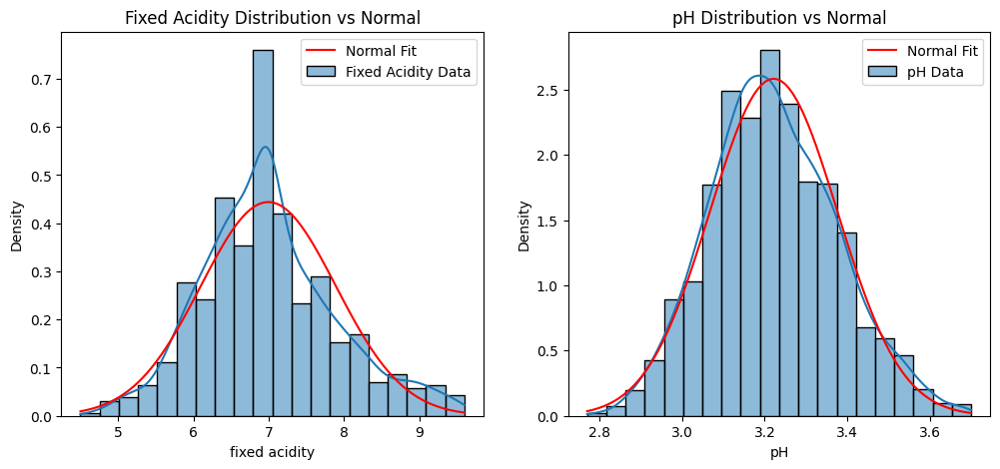

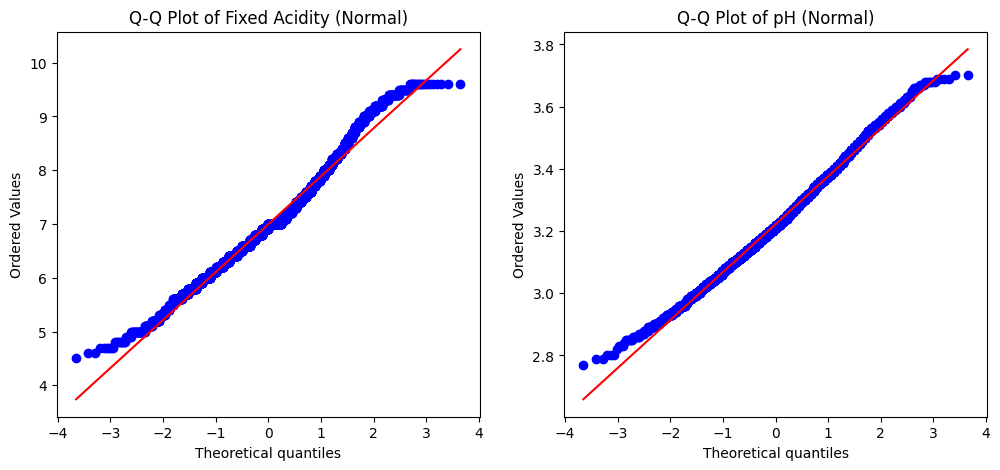

Shapiro-Wilk test for Fixed Acidity: p-value = 0.00000
Shapiro-Wilk test for pH: p-value = 0.00000
Kolmogorov-Smirnov test for Normal (Fixed Acidity): p-value = 0.00000
Kolmogorov-Smirnov test for Normal (pH): p-value = 0.00000

Anderson-Darling test for Normal distribution:
Fixed Acidity: Statistic = 30.49260, Critical values = [0.576 0.656 0.786 0.917 1.091], Significance levels = [15.  10.   5.   2.5  1. ]
pH: Statistic = 6.53188, Critical values = [0.576 0.656 0.786 0.917 1.091], Significance levels = [15.  10.   5.   2.5  1. ]


/usr/local/lib/python3.11/dist-packages/scipy/stats/_axis_nan_policy.py:573: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 5320.
  res = hypotest_fun_out(*samples, **kwds)


In [ ]:
# Chuẩn bị dữ liệu
fixed_acidity_data = data_cleaned["fixed acidity"]
pH_data = data_cleaned["pH"]

# Vẽ Histogram và đường Normal Fit
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Histogram của Fixed Acidity với đường Normal Fit
sns.histplot(fixed_acidity_data, bins=20, kde=True, stat="density", ax=axes[0], label="Fixed Acidity Data")
x_fixed = np.linspace(min(fixed_acidity_data), max(fixed_acidity_data), 100)
axes[0].plot(x_fixed, stats.norm.pdf(x_fixed, np.mean(fixed_acidity_data), np.std(fixed_acidity_data)), 'r-', label="Normal Fit")
axes[0].set_title("Fixed Acidity Distribution vs Normal")
axes[0].legend()

# Histogram của pH với đường Normal Fit
sns.histplot(pH_data, bins=20, kde=True, stat="density", ax=axes[1], label="pH Data")
x_pH = np.linspace(min(pH_data), max(pH_data), 100)
axes[1].plot(x_pH, stats.norm.pdf(x_pH, np.mean(pH_data), np.std(pH_data)), 'r-', label="Normal Fit")
axes[1].set_title("pH Distribution vs Normal")
axes[1].legend()

plt.show()

# Q-Q Plot để kiểm tra tính chuẩn
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

stats.probplot(fixed_acidity_data, dist="norm", plot=axes[0])
axes[0].set_title("Q-Q Plot of Fixed Acidity (Normal)")

stats.probplot(pH_data, dist="norm", plot=axes[1])
axes[1].set_title("Q-Q Plot of pH (Normal)")

plt.show()

# Kiểm định Shapiro-Wilk
shapiro_fixed = stats.shapiro(fixed_acidity_data)
shapiro_pH = stats.shapiro(pH_data)

print(f"Shapiro-Wilk test for Fixed Acidity: p-value = {shapiro_fixed.pvalue:.5f}")
print(f"Shapiro-Wilk test for pH: p-value = {shapiro_pH.pvalue:.5f}")

# Kiểm định Kolmogorov-Smirnov
ks_fixed_norm = stats.kstest(fixed_acidity_data, "norm", args=(np.mean(fixed_acidity_data), np.std(fixed_acidity_data)))
ks_pH_norm = stats.kstest(pH_data, "norm", args=(np.mean(pH_data), np.std(pH_data)))

print(f"Kolmogorov-Smirnov test for Normal (Fixed Acidity): p-value = {ks_fixed_norm.pvalue:.5f}")
print(f"Kolmogorov-Smirnov test for Normal (pH): p-value = {ks_pH_norm.pvalue:.5f}")

# Kiểm định Anderson-Darling
ad_fixed_norm = stats.anderson(fixed_acidity_data, dist="norm")
ad_pH_norm = stats.anderson(pH_data, dist="norm")

print("\nAnderson-Darling test for Normal distribution:")
print(f"Fixed Acidity: Statistic = {ad_fixed_norm.statistic:.5f}, Critical values = {ad_fixed_norm.critical_values}, Significance levels = {ad_fixed_norm.significance_level}")
print(f"pH: Statistic = {ad_pH_norm.statistic:.5f}, Critical values = {ad_pH_norm.critical_values}, Significance levels = {ad_pH_norm.significance_level}")


In [ ]:
# Chuẩn bị dữ liệu
fixed_acidity_data = data_cleaned["fixed acidity"]
pH_data = data_cleaned["pH"]

# Kiểm tra phân phối Gamma (chỉ dùng KS-Test) ###
shape_fixed, loc_fixed, scale_fixed = stats.gamma.fit(fixed_acidity_data)
shape_pH, loc_pH, scale_pH = stats.gamma.fit(pH_data)

ks_fixed_gamma = stats.kstest(fixed_acidity_data, "gamma", args=(shape_fixed, loc_fixed, scale_fixed))
ks_pH_gamma = stats.kstest(pH_data, "gamma", args=(shape_pH, loc_pH, scale_pH))

print(f"Kolmogorov-Smirnov test for Gamma (Fixed Acidity): p-value = {ks_fixed_gamma.pvalue:.5f}")
print(f"Kolmogorov-Smirnov test for Gamma (pH): p-value = {ks_pH_gamma.pvalue:.5f}")

# Kiểm tra phân phối Log-Normal ###
shape_fixed_ln, loc_fixed_ln, scale_fixed_ln = stats.lognorm.fit(fixed_acidity_data)
shape_pH_ln, loc_pH_ln, scale_pH_ln = stats.lognorm.fit(pH_data)

ks_fixed_lognorm = stats.kstest(fixed_acidity_data, "lognorm", args=(shape_fixed_ln, loc_fixed_ln, scale_fixed_ln))
ks_pH_lognorm = stats.kstest(pH_data, "lognorm", args=(shape_pH_ln, loc_pH_ln, scale_pH_ln))

ad_fixed_lognorm = stats.anderson(fixed_acidity_data, dist="logistic")
ad_pH_lognorm = stats.anderson(pH_data, dist="logistic")

print(f"\nKolmogorov-Smirnov test for Log-Normal (Fixed Acidity): p-value = {ks_fixed_lognorm.pvalue:.5f}")
print(f"Kolmogorov-Smirnov test for Log-Normal (pH): p-value = {ks_pH_lognorm.pvalue:.5f}")
print(f"Anderson-Darling test for Logistic (Fixed Acidity): Statistic = {ad_fixed_lognorm.statistic:.5f}")
print(f"Anderson-Darling test for Logistic (pH): Statistic = {ad_pH_lognorm.statistic:.5f}")

# Kiểm tra phân phối Weibull ###
shape_fixed_wb, loc_fixed_wb, scale_fixed_wb = stats.weibull_min.fit(fixed_acidity_data)
shape_pH_wb, loc_pH_wb, scale_pH_wb = stats.weibull_min.fit(pH_data)

ks_fixed_weibull = stats.kstest(fixed_acidity_data, "weibull_min", args=(shape_fixed_wb, loc_fixed_wb, scale_fixed_wb))
ks_pH_weibull = stats.kstest(pH_data, "weibull_min", args=(shape_pH_wb, loc_pH_wb, scale_pH_wb))

ad_fixed_weibull = stats.anderson(fixed_acidity_data, dist="weibull_min")
ad_pH_weibull = stats.anderson(pH_data, dist="weibull_min")

print(f"\nKolmogorov-Smirnov test for Weibull (Fixed Acidity): p-value = {ks_fixed_weibull.pvalue:.5f}")
print(f"Kolmogorov-Smirnov test for Weibull (pH): p-value = {ks_pH_weibull.pvalue:.5f}")
print(f"Anderson-Darling test for Weibull (Fixed Acidity): Statistic = {ad_fixed_weibull.statistic:.5f}")
print(f"Anderson-Darling test for Weibull (pH): Statistic = {ad_pH_weibull.statistic:.5f}")


Kolmogorov-Smirnov test for Gamma (Fixed Acidity): p-value = 0.00000
Kolmogorov-Smirnov test for Gamma (pH): p-value = 0.01299

Kolmogorov-Smirnov test for Log-Normal (Fixed Acidity): p-value = 0.00000
Kolmogorov-Smirnov test for Log-Normal (pH): p-value = 0.01148
Anderson-Darling test for Logistic (Fixed Acidity): Statistic = 19.32184
Anderson-Darling test for Logistic (pH): Statistic = 9.09616

Kolmogorov-Smirnov test for Weibull (Fixed Acidity): p-value = 0.00000
Kolmogorov-Smirnov test for Weibull (pH): p-value = 0.00000
Anderson-Darling test for Weibull (Fixed Acidity): Statistic = 29.24716
Anderson-Darling test for Weibull (pH): Statistic = 5.60719


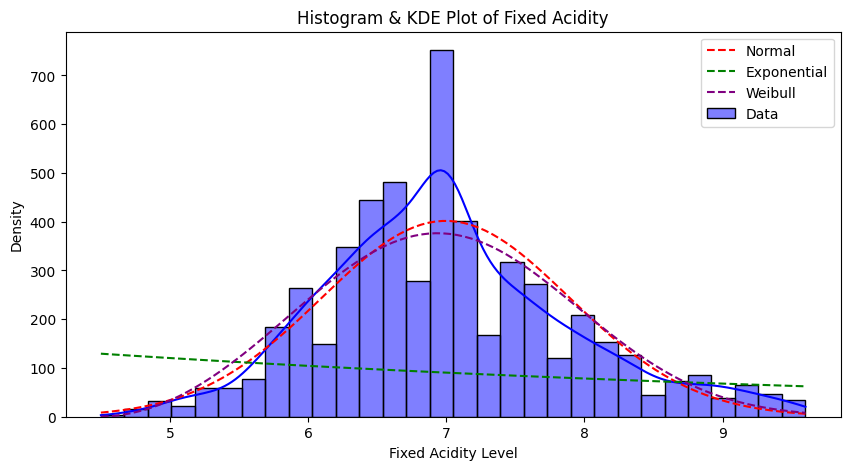

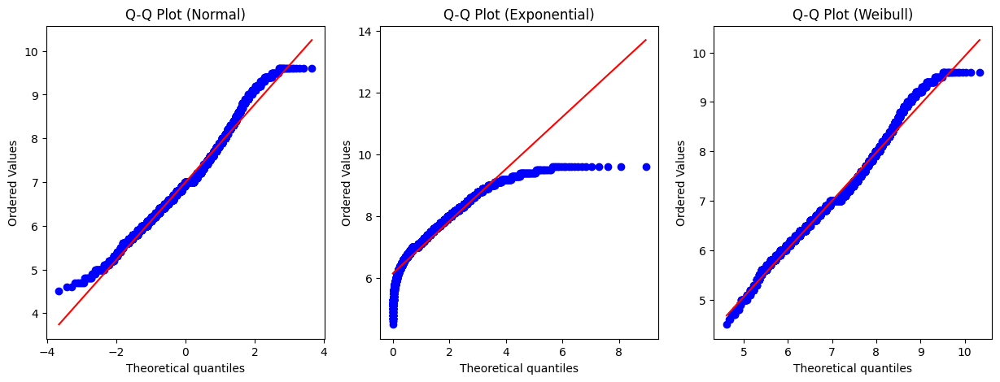

In [ ]:
# Dữ liệu Fixed Acidity
fixed_acidity_data =  data_cleaned["fixed acidity"]

# Vẽ Histogram + KDE Plot
plt.figure(figsize=(10, 5))
sns.histplot(fixed_acidity_data, bins=30, kde=True, color="blue", label="Data")
x = np.linspace(fixed_acidity_data.min(), fixed_acidity_data.max(), 100)

# Thêm đường phân phối chuẩn
mu, sigma = np.mean(fixed_acidity_data), np.std(fixed_acidity_data)
plt.plot(x, stats.norm.pdf(x, mu, sigma) * len(fixed_acidity_data) * (fixed_acidity_data.max() - fixed_acidity_data.min()) / 30,
         color='red', linestyle="--", label="Normal")

# Thêm đường phân phối Exponential
lambda_exp = 1 / np.mean(fixed_acidity_data)
plt.plot(x, stats.expon.pdf(x, fixed_acidity_data.min(), 1/lambda_exp) * len(fixed_acidity_data) * (fixed_acidity_data.max() - fixed_acidity_data.min()) / 30,
         color='green', linestyle="--", label="Exponential")

# Thêm đường phân phối Weibull
shape, loc, scale = stats.weibull_min.fit(fixed_acidity_data)
plt.plot(x, stats.weibull_min.pdf(x, shape, loc, scale) * len(fixed_acidity_data) * (fixed_acidity_data.max() - fixed_acidity_data.min()) / 30,
         color='purple', linestyle="--", label="Weibull")

plt.title("Histogram & KDE Plot of Fixed Acidity")
plt.xlabel("Fixed Acidity Level")
plt.ylabel("Density")
plt.legend()
plt.show()

# Vẽ Q-Q Plot
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Q-Q Plot với Normal Distribution
stats.probplot(fixed_acidity_data, dist="norm", plot=axes[0])
axes[0].set_title("Q-Q Plot (Normal)")

# Q-Q Plot với Exponential Distribution
stats.probplot(fixed_acidity_data, dist="expon", plot=axes[1])
axes[1].set_title("Q-Q Plot (Exponential)")

# Q-Q Plot với Weibull Distribution
stats.probplot(fixed_acidity_data, dist=stats.weibull_min(shape, loc, scale), plot=axes[2])
axes[2].set_title("Q-Q Plot (Weibull)")

plt.show()


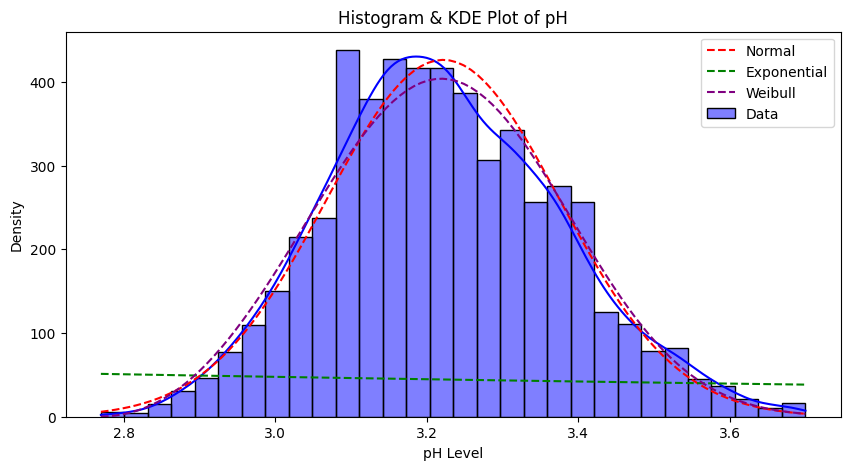

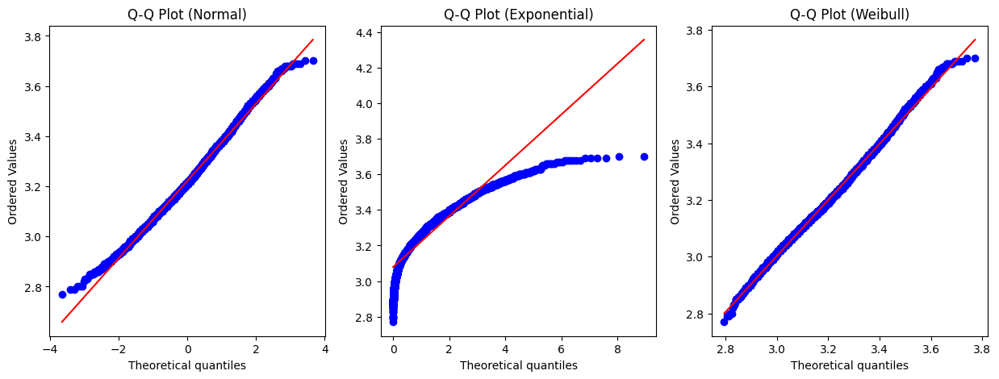

In [ ]:
# Dữ liệu pH
ph_data = data_cleaned["pH"]

# Vẽ Histogram + KDE Plot
plt.figure(figsize=(10, 5))
sns.histplot(ph_data, bins=30, kde=True, color="blue", label="Data")
x = np.linspace(ph_data.min(), ph_data.max(), 100)

# Thêm đường phân phối chuẩn
mu, sigma = np.mean(ph_data), np.std(ph_data)
plt.plot(x, stats.norm.pdf(x, mu, sigma) * len(ph_data) * (ph_data.max() - ph_data.min()) / 30,
         color='red', linestyle="--", label="Normal")

# Thêm đường phân phối Exponential
lambda_exp = 1 / np.mean(ph_data)
plt.plot(x, stats.expon.pdf(x, ph_data.min(), 1/lambda_exp) * len(ph_data) * (ph_data.max() - ph_data.min()) / 30,
         color='green', linestyle="--", label="Exponential")

# Thêm đường phân phối Weibull
shape, loc, scale = stats.weibull_min.fit(ph_data)
plt.plot(x, stats.weibull_min.pdf(x, shape, loc, scale) * len(ph_data) * (ph_data.max() - ph_data.min()) / 30,
         color='purple', linestyle="--", label="Weibull")

plt.title("Histogram & KDE Plot of pH")
plt.xlabel("pH Level")
plt.ylabel("Density")
plt.legend()
plt.show()

# Vẽ Q-Q Plot
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Q-Q Plot với Normal Distribution
stats.probplot(ph_data, dist="norm", plot=axes[0])
axes[0].set_title("Q-Q Plot (Normal)")

# Q-Q Plot với Exponential Distribution
stats.probplot(ph_data, dist="expon", plot=axes[1])
axes[1].set_title("Q-Q Plot (Exponential)")

# Q-Q Plot với Weibull Distribution
stats.probplot(ph_data, dist=stats.weibull_min(shape, loc, scale), plot=axes[2])
axes[2].set_title("Q-Q Plot (Weibull)")

plt.show()


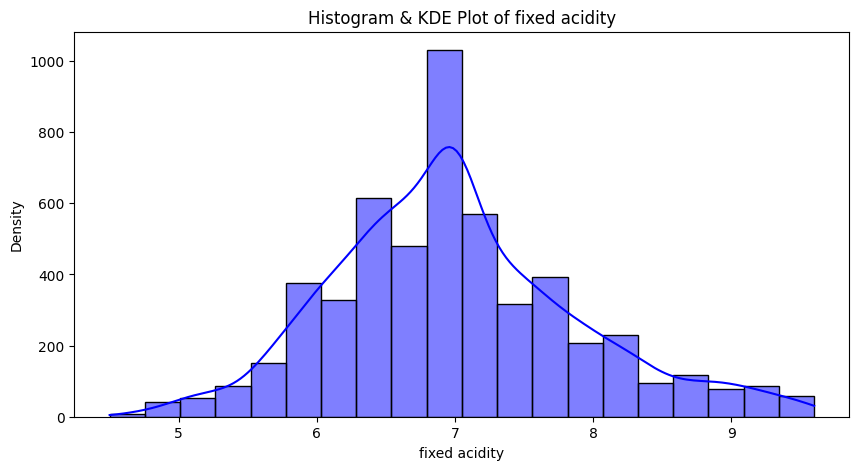

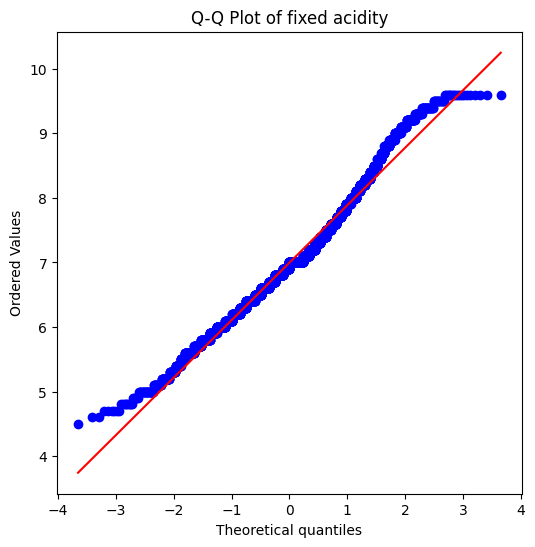

Shapiro-Wilk test for Normal: p-value = 0.00000
Kolmogorov-Smirnov test for Normal: p-value = 0.00000
Anderson-Darling test for Normal: Statistic = 30.49260
Critical values = [0.576 0.656 0.786 0.917 1.091]
Significance levels = [15.  10.   5.   2.5  1. ]
Kolmogorov-Smirnov test for Poisson: p-value = 0.00000
Kolmogorov-Smirnov test for Exponential: p-value = 0.00000


/usr/local/lib/python3.11/dist-packages/scipy/stats/_axis_nan_policy.py:573: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 5320.
  res = hypotest_fun_out(*samples, **kwds)


In [ ]:
fixed_acidity_data = data_cleaned["fixed acidity"]

# Vẽ Histogram & KDE Plot
plt.figure(figsize=(10, 5))
sns.histplot(fixed_acidity_data, bins=20, kde=True, color="blue", alpha=0.5)
plt.title("Histogram & KDE Plot of fixed acidity")
plt.xlabel("fixed acidity")
plt.ylabel("Density")
plt.show()

# Vẽ Q-Q Plot
plt.figure(figsize=(6, 6))
stats.probplot(fixed_acidity_data, dist="norm", plot=plt)
plt.title("Q-Q Plot of fixed acidity")
plt.show()

# Kiểm tra phân phối
# Shapiro-Wilk Test (Kiểm tra phân phối chuẩn)
shapiro_test = stats.shapiro(fixed_acidity_data)
print(f"Shapiro-Wilk test for Normal: p-value = {shapiro_test.pvalue:.5f}")

# Kolmogorov-Smirnov Test (So sánh với phân phối chuẩn)
ks_test = stats.kstest(fixed_acidity_data, "norm", args=(np.mean(fixed_acidity_data), np.std(fixed_acidity_data)))
print(f"Kolmogorov-Smirnov test for Normal: p-value = {ks_test.pvalue:.5f}")

# Anderson-Darling Test (Phân phối chuẩn)
ad_test = stats.anderson(fixed_acidity_data, dist="norm")
print(f"Anderson-Darling test for Normal: Statistic = {ad_test.statistic:.5f}")
print(f"Critical values = {ad_test.critical_values}")
print(f"Significance levels = {ad_test.significance_level}")

# Thử phân phối khác (Poisson, Exponential)
lambda_age = np.mean(fixed_acidity_data)  # Lambda cho Poisson

ks_test_poisson = stats.kstest(fixed_acidity_data, "poisson", args=(lambda_age,))
print(f"Kolmogorov-Smirnov test for Poisson: p-value = {ks_test_poisson.pvalue:.5f}")

ks_test_exp = stats.kstest(fixed_acidity_data, "expon", args=(fixed_acidity_data.min(), np.mean(fixed_acidity_data)))
print(f"Kolmogorov-Smirnov test for Exponential: p-value = {ks_test_exp.pvalue:.5f}")



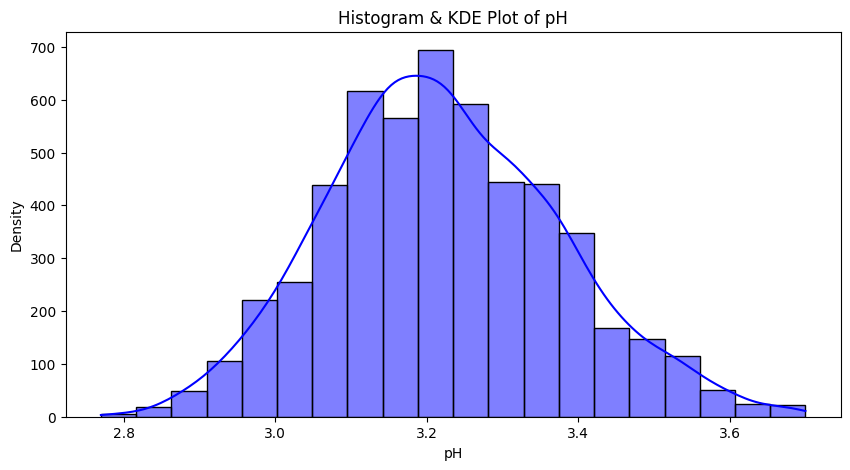

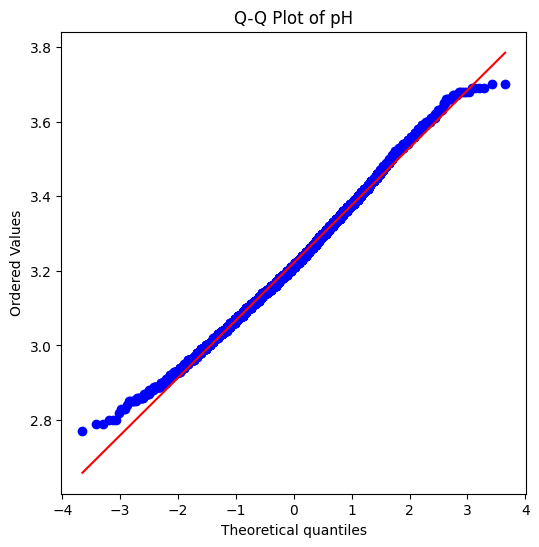

Shapiro-Wilk test for Normal: p-value = 0.00000
Kolmogorov-Smirnov test for Normal: p-value = 0.00000
Anderson-Darling test for Normal: Statistic = 6.53188
Critical values = [0.576 0.656 0.786 0.917 1.091]
Significance levels = [15.  10.   5.   2.5  1. ]
Kolmogorov-Smirnov test for Poisson: p-value = 0.00000
Kolmogorov-Smirnov test for Exponential: p-value = 0.00000


/usr/local/lib/python3.11/dist-packages/scipy/stats/_axis_nan_policy.py:573: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 5320.
  res = hypotest_fun_out(*samples, **kwds)


In [ ]:
pH_data = data["pH"]

# Vẽ Histogram & KDE Plot
plt.figure(figsize=(10, 5))
sns.histplot(pH_data, bins=20, kde=True, color="blue", alpha=0.5)
plt.title("Histogram & KDE Plot of pH")
plt.xlabel("pH")
plt.ylabel("Density")
plt.show()

# Vẽ Q-Q Plot
plt.figure(figsize=(6, 6))
stats.probplot(pH_data, dist="norm", plot=plt)
plt.title("Q-Q Plot of pH")
plt.show()

# Kiểm tra phân phối
# Shapiro-Wilk Test (Kiểm tra phân phối chuẩn)
shapiro_test = stats.shapiro(pH_data)
print(f"Shapiro-Wilk test for Normal: p-value = {shapiro_test.pvalue:.5f}")

# Kolmogorov-Smirnov Test (So sánh với phân phối chuẩn)
ks_test = stats.kstest(pH_data, "norm", args=(np.mean(pH_data), np.std(pH_data)))
print(f"Kolmogorov-Smirnov test for Normal: p-value = {ks_test.pvalue:.5f}")

# Anderson-Darling Test (Phân phối chuẩn)
ad_test = stats.anderson(pH_data, dist="norm")
print(f"Anderson-Darling test for Normal: Statistic = {ad_test.statistic:.5f}")
print(f"Critical values = {ad_test.critical_values}")
print(f"Significance levels = {ad_test.significance_level}")

# Thử phân phối khác (Poisson, Exponential)
lambda_age = np.mean(pH_data)  # Lambda cho Poisson

ks_test_poisson = stats.kstest(pH_data, "poisson", args=(lambda_age,))
print(f"Kolmogorov-Smirnov test for Poisson: p-value = {ks_test_poisson.pvalue:.5f}")

ks_test_exp = stats.kstest(pH_data, "expon", args=(pH_data.min(), np.mean(pH_data)))
print(f"Kolmogorov-Smirnov test for Exponential: p-value = {ks_test_exp.pvalue:.5f}")



In [ ]:
# count1 = 0
# count2 = 0
# for i in data_cleaned["quality"]:
#   if i == 1:
#     count1 += 1
#   else:
#     count2 += 1
# print(count1)
# print(count2)
# print((count2/count1)*100)

In [ ]:
data_cleaned.describe()


,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000,5320.000000
mean,6.995968,0.317660,0.315577,4.629784,0.050897,29.440695,113.784023,0.994522,3.221793,0.517853,10.548395,1.145301
std,0.898370,0.125361,0.140639,3.861351,0.018583,16.329848,56.109909,0.002891,0.154361,0.117486,1.184433,0.461465
min,4.500000,0.080000,0.000000,0.600000,0.009000,1.000000,6.000000,0.987110,2.770000,0.220000,8.000000,0.000000
25%,6.400000,0.230000,0.240000,1.800000,0.038000,16.000000,74.000000,0.992200,3.120000,0.430000,9.500000,1.000000
50%,7.000000,0.300000,0.310000,2.700000,0.047000,28.000000,116.000000,0.994645,3.210000,0.510000,10.400000,1.000000
75%,7.500000,0.380000,0.390000,6.900000,0.060000,40.000000,153.000000,0.996760,3.320000,0.590000,11.400000,1.000000
max,9.600000,0.675000,0.750000,16.050000,0.108000,78.000000,282.000000,1.003200,3.700000,0.850000,14.200000,2.000000


### Đưa ra nhận xét về đặc điểm của dữ liệu dựa trên phân phối

#### **Nhận xét về phân phối của biến 'fixed acidity'**:




- **Kiểm định tính chuẩn:**

  - Kiểm định Shapiro-Wilk cho fixed acidity có p-value ≈ 0.00000, nhỏ hơn rất nhiều so với mức ý nghĩa 0.05.

  - Kiểm định Kolmogorov-Smirnov (so với phân phối chuẩn) cũng có p-value ≈ 0.00000, nhỏ hơn 0.05.

  - Kiểm định Anderson-Darling cho fixed acidity có giá trị thống kê (Statistic ≈ 30.5) lớn hơn nhiều so với các giá trị tới hạn (critical values) ở tất cả các mức ý nghĩa phổ biến (ví dụ: lớn hơn 1.091 ở mức 1%).

  - Lưu ý: Có cảnh báo về độ chính xác của p-value Shapiro-Wilk do kích thước mẫu lớn (N=5320), tuy nhiên, sự nhất quán giữa ba kiểm định và kết quả trực quan cho thấy kết luận vẫn đáng tin cậy.

  - => **Kết luận từ kiểm định**: Cả ba kiểm định đều cung cấp bằng chứng rất mạnh mẽ để **bác bỏ giả thuyết rằng biến 'fixed acidity' tuân theo phân phối chuẩn**.

- **Quan sát biểu đồ:**

  - **Histogram (+KDE)**: B
  
    - Biểu đồ cho thấy phân phối của fixed acidity có dạng **gần giống hình chuông** nhưng không hoàn hảo. Đỉnh của phân phối tập trung rõ rệt quanh giá trị 7.0.

    - Hình dạng có vẻ hơi lệch phải (positively skewed), với đuôi bên phải trải dài ra hơn một chút so với đuôi bên trái.

    - Đường cong KDE (màu xanh) cho thấy một đỉnh khá nhọn so với đường cong chuẩn lý thuyết (màu đỏ), gợi ý rằng dữ liệu có thể tập trung quanh giá trị trung tâm nhiều hơn và có đuôi dày hơn chuẩn (leptokurtic).

    - So sánh với các đường phân phối khác (Exponential, Weibull), rõ ràng đường Normal (đỏ) mô tả hình dạng tổng thể tốt hơn các đường còn lại, mặc dù vẫn có sự khác biệt rõ ràng so với dữ liệu thực tế (KDE xanh).

  - **Q-Q Plot (so với Normal)**:
  
    - Đồ thị cho thấy các điểm dữ liệu tạo thành một **hình chữ 'S'** rõ rệt quanh đường thẳng tham chiếu màu đỏ.

    - Ở đuôi bên trái (giá trị thấp), các điểm nằm phía trên đường thẳng, cho thấy đuôi trái của dữ liệu thực tế dày hơn (chứa nhiều giá trị cực thấp hơn) so với phân phối chuẩn.

    - Ở đuôi bên phải (giá trị cao), các điểm nằm phía dưới đường thẳng, cho thấy đuôi phải cũng dày hơn (chứa nhiều giá trị cực cao hơn) so với phân phối chuẩn.

    - Sự lệch hình chữ 'S' này là bằng chứng trực quan mạnh mẽ về việc dữ liệu **không tuân theo phân phối chuẩn**, đặc biệt là ở các đuôi.

- **So sánh với phân phối khác (KS-Test):**

  - Các kiểm định Kolmogorov-Smirnov so với Exponential (p≈0), Poisson (p≈0, không phù hợp lý thuyết), Gamma (p≈0), Log-Normal (p≈0), và Weibull (p≈0) đều cho p-value rất nhỏ.

  - **Kết luận từ kiểm định KS**: Không có phân phối lý thuyết nào trong số các phân phối đã kiểm tra (Exponential, Gamma, Log-Normal, Weibull) mô tả tốt dữ liệu fixed acidity theo tiêu chuẩn của KS-test.

- **Nhận xét chung 'fixed acidity':** Biến fixed acidity có phân phối **gần đối xứng** (Mean ≈ 7.00, Median = 7.00) nhưng **không tuân theo phân phối chuẩn** một cách chặt chẽ. Các kiểm định thống kê bác bỏ giả thuyết chuẩn một cách mạnh mẽ. Phân tích trực quan (Histogram, Q-Q plot) cho thấy dữ liệu có đỉnh nhọn hơn và đuôi dày hơn so với phân phối chuẩn, và có thể hơi lệch nhẹ về bên phải. Không tìm thấy phân phối lý thuyết chuẩn nào khác phù hợp hơn qua kiểm định KS.

#### **Nhận xét về phân phối của biến 'pH':**



- **Kiểm định tính chuẩn:**

  - Kiểm định Shapiro-Wilk cho pH có p-value ≈ 0.00000 (rất nhỏ).

  - Kiểm định Kolmogorov-Smirnov (so với phân phối chuẩn) có p-value ≈ 0.00000.

  - Kiểm định Anderson-Darling cho pH có giá trị thống kê (Statistic ≈ 6.53) cực kỳ lớn so với các giá trị tới hạn (ví dụ: lớn hơn 1.091 ở mức 1%).

  - => **Kết luận từ kiểm định**: Mặc dù có thể bị ảnh hưởng bởi kích thước mẫu lớn, cả ba kiểm định thống kê đều bác **bỏ giả thuyết rằng biến pH tuân theo phân phối chuẩn**.

- **Quan sát biểu đồ:**

  - **Histogram (+KDE)**:
  
    - Hình dạng phân phối của pH trông **rất giống hình chuông và đối xứng**. Đỉnh của phân phối nằm quanh giá trị 3.2.

    - Đường cong KDE (màu xanh) **bám rất sát** với đường cong chuẩn lý thuyết (màu đỏ). Sự phù hợp trực quan giữa dữ liệu thực tế và mô hình chuẩn là rất tốt.

    - So sánh với các đường phân phối khác (Exponential, Weibull) cho thấy chúng hoàn toàn không phù hợp bằng đường Normal.

  - **Q-Q Plot (so với Normal)**:
  
    - Các điểm dữ liệu trên Q-Q plot **nằm rất gần và bám sát đường thẳng tham chiếu màu đỏ** trên phần lớn phạm vi giá trị.

    - Chỉ có một sự **lệch rất nhẹ** ở hai đầu cực trị (tạo thành một hình chữ 'S' cực kỳ mờ nhạt), ít rõ ràng hơn nhiều so với fixed acidity.

    - **Kết luận từ trực quan**: Về mặt hình ảnh, phân phối của pH **rất gần với phân phối chuẩn**.


- **So sánh với phân phối khác:**

  - Các kiểm định Kolmogorov-Smirnov so với Exponential (p≈0), Poisson (p≈0), Gamma (p≈0.012), Log-Normal (p≈0.011), và Weibull (p≈0.0) đều cho p-value nhỏ hơn 0.05.

  - **Kết luận từ kiểm định KS**: Các phân phối lý thuyết thay thế này cũng bị bác bỏ, không có phân phối nào phù hợp hơn Normal dựa trên kết quả KS-test.


- **Nhận xét chung 'pH'**: Biến pH thể hiện một trường hợp thú vị:

  - **Trực quan**: Histogram và đặc biệt là Q-Q plot cho thấy sự tương đồng rất cao với phân phối chuẩn. Dữ liệu rất đối xứng (Mean ≈ 3.22, Median ≈ 3.21).

  - **Thống kê**: Tuy nhiên, tất cả các kiểm định tính chuẩn (Shapiro-Wilk, KS, Anderson-Darling) đều bác bỏ giả thuyết chuẩn với p-value rất nhỏ.

  - **Giải thích**: Sự khác biệt này rất có thể là do **kích thước mẫu rất lớn (N=5320)**. Với nhiều dữ liệu như vậy, các kiểm định thống kê trở nên cực kỳ nhạy cảm và có thể phát hiện ra những sai khác rất nhỏ, không đáng kể trong thực tế, so với phân phối chuẩn lý thuyết hoàn hảo.

  - **Kết luận thực tế**: Mặc dù bị bác bỏ về mặt thống kê, phân phối của pH có thể được coi là **xấp xỉ chuẩn (approximately normal)** cho nhiều mục đích thực hành, vì sự sai khác trực quan là rất nhỏ.



#### **Nhận xét tổng kết và hàm ý cho phân tích tiếp theo:**

**1. Tầm quan trọng của đặc điểm phân phối:**

  - Việc xác định rằng fixed acidity **không tuân theo phân phối chuẩn** là một kết quả quan trọng. Sự sai khác này không chỉ thể hiện qua các kiểm định thống kê mà còn khá rõ ràng về mặt trực quan (hình dạng lệch, đuôi dày, đỉnh nhọn). Khi thực hiện các phân tích suy luận liên quan đến fixed acidity (ví dụ: so sánh độ axit cố định trung bình giữa các nhóm chất lượng rượu, hoặc tính tương quan với các biến khác), việc vi phạm giả định chuẩn này cần được xem xét cẩn thận.

  - Đối với pH, tình hình phức tạp hơn. Mặc dù các kiểm định thống kê **bác bỏ giả thuyết chuẩn** (rất có thể do kích thước mẫu lớn), hình dạng phân phối của nó lại **rất gần với chuẩn** về mặt trực quan. Điều này có nghĩa là, trong khi về mặt lý thuyết chặt chẽ nó không chuẩn, thì trong thực tế, các sai lệch có thể là nhỏ.

**2. Lựa chọn phương pháp kiểm định và phân tích:**

  - Khi làm việc với fixed acidity, do sự sai khác rõ ràng so với chuẩn, nên **ưu tiên sử dụng các phương pháp phi tham số (non-parametric)** để đảm bảo tính hợp lệ của kết quả. Cụ thể:

    - Để so sánh giá trị fixed acidity giữa hai nhóm (ví dụ: vang đỏ vs trắng, hoặc nhóm chất lượng thấp vs cao), nên dùng kiểm định Mann-Whitney U thay vì t-test.

    - Để so sánh giá trị fixed acidity giữa hai nhóm (ví dụ: vang đỏ vs trắng, hoặc nhóm chất lượng thấp vs cao), nên dùng kiểm định Mann-Whitney U thay vì t-test.

    - Để đánh giá mối tương quan với các biến khác, nên dùng hệ số tương quan Spearman thay vì Pearson nếu biến kia cũng không chuẩn hoặc mối quan hệ không tuyến tính.

    - Các phương pháp mạnh mẽ (robust methods) hoặc kỹ thuật bootstrap cũng là những lựa chọn thay thế tốt.

  - **Đối với pH**:

    - Do tính chất xấp xỉ chuẩn và kích thước mẫu lớn, các kiểm định tham số (như t-test, ANOVA, tương quan Pearson) có thể vẫn khá mạnh mẽ (robust) đối với những sai lệch nhỏ khỏi giả định chuẩn, đặc biệt khi so sánh trung bình (nhờ Định lý Giới hạn Trung tâm).

    - Tuy nhiên, để đảm bảo an toàn hoặc nếu muốn so sánh toàn bộ hình dạng phân phối chứ không chỉ trung bình, việc sử dụng các kiểm định phi tham số (Mann-Whitney U, Kruskal-Wallis, Spearman) vẫn là một lựa chọn hợp lệ và thận trọng hơn.

**3. Xem xét cho mô hình hóa:**

  - Nếu xây dựng các mô hình thống kê hoặc học máy mà yêu cầu chặt chẽ về giả định phân phối chuẩn của các biến đầu vào (ví dụ: một số dạng hồi quy tuyến tính cổ điển), thì đối với fixed acidity, có thể cần xem xét các phép biến đổi dữ liệu (như Box-Cox, mặc dù việc tìm một phép biến đổi hoàn hảo có thể khó khăn do không có phân phối lý thuyết nào khớp tốt).

  - Đối với pH, do tính xấp xỉ chuẩn, việc biến đổi dữ liệu có lẽ là không cần thiết cho hầu hết các mô hình phổ biến, đặc biệt là các mô hình dựa trên cây quyết định, thuật toán học máy hiện đại, hoặc khi mô hình có tính mạnh mẽ nhất định đối với giả định chuẩn.

# 4) Kiểm định giả thuyết

## a. Tìm hiểu và trình bày các kiểm định thống kê: t-test, Chi-square và ANOVA

### t-test

#### Giới thiệu chung

- **T-test là gì?** T-test là một loại kiểm định giả thuyết thống kê suy luận (inferential statistics). Nó được sử dụng để xác định xem liệu có sự khác biệt có ý nghĩa thống kê giữa giá trị trung bình (mean) của hai nhóm hay không, hoặc giữa giá trị trung bình của một nhóm so với một giá trị đã biết (giá trị giả thuyết).

- **Nguồn gốc**: Được phát triển bởi William Sealy Gosset dưới bút danh "Student", nên đôi khi còn được gọi là "Student's t-test".

- **Mục đích chính**: là so sánh giá trị trung bình.

- **Khi nào dùng?** T-test đặc biệt hữu ích khi:

  - Kích thước mẫu nhỏ (thường dưới 30).

  - Độ lệch chuẩn của tổng thể (population standard deviation) không xác định (đây là trường hợp phổ biến trong thực tế). T-test sử dụng độ lệch chuẩn mẫu (sample standard deviation) để ước lượng.

- **Dựa trên phân phối nào?** T-test dựa trên phân phối t (t-distribution), một phân phối xác suất tương tự như phân phối chuẩn nhưng có "đuôi dày hơn", nghĩa là nó có nhiều xác suất hơn ở các giá trị cực trị, đặc biệt là với cỡ mẫu nhỏ. Hình dạng của phân phối t phụ thuộc vào "bậc tự do" (degrees of freedom - df), thường liên quan đến kích thước mẫu. Khi bậc tự do tăng lên (cỡ mẫu lớn hơn), phân phối t tiệm cận với phân phối chuẩn.

#### Các giả định của t-test

Để kết quả của t-test đáng tin cậy, dữ liệu của bạn cần đáp ứng một số giả định:

  1. **Dữ liệu đo lường**: Biến phụ thuộc (biến bạn đang đo lường/so sánh) phải là biến liên tục (định lượng), ví dụ: chiều cao, cân nặng, điểm số, nhiệt độ.

  2. **Mẫu ngẫu nhiên**: Dữ liệu được thu thập từ một mẫu đại diện, được chọn ngẫu nhiên từ tổng thể mà bạn muốn suy luận.

  3. **Tính chuẩn (Normality)**: Dữ liệu trong mỗi nhóm (hoặc sự khác biệt giữa các cặp trong paired t-test) nên tuân theo phân phối xấp xỉ chuẩn. Tuy nhiên, t-test khá "mạnh" (robust) đối với vi phạm giả định này khi cỡ mẫu đủ lớn (ví dụ: n > 30 cho mỗi nhóm) nhờ vào Định lý Giới hạn Trung tâm (Central Limit Theorem). Bạn có thể kiểm tra tính chuẩn bằng biểu đồ (Q-Q plot, histogram) hoặc các kiểm định thống kê (Shapiro-Wilk, Kolmogorov-Smirnov).

  4. **Phương sai đồng nhất (Homogeneity of variances)**: (Chỉ áp dụng cho t-test hai mẫu độc lập). Giả định rằng phương sai (variance) của biến phụ thuộc là bằng nhau giữa hai nhóm được so sánh. Có thể kiểm tra bằng kiểm định Levene. Nếu giả định này bị vi phạm, bạn nên sử dụng một phiên bản của t-test không yêu cầu giả định này (ví dụ: Welch's t-test).

#### Các loại t-test phổ biến

Có ba loại t-test chính:

- **a) T-test một mẫu (One-Sample T-test):**

  - **Mục đích**: So sánh giá trị trung bình của một mẫu duy nhất với một giá trị cụ thể, đã biết trước (thường là giá trị trung bình của tổng thể theo lý thuyết hoặc một tiêu chuẩn).

  - **Câu hỏi ví dụ**: Chiều cao trung bình của học sinh lớp 10 ở trường A có khác biệt đáng kể so với chiều cao trung bình chuẩn quốc gia là 165cm không?

  - **Giả thuyết**:

    - H0 (Null Hypothesis): Trung bình mẫu = Giá trị đã biết (μ = μ₀).

    - H1 (Alternative Hypothesis): Trung bình mẫu ≠ Giá trị đã biết (μ ≠ μ₀) (kiểm định 2 phía), hoặc μ > μ₀, hoặc μ < μ₀ (kiểm định 1 phía).
  
  - **Công thức:** $\Large t = \frac{\bar{x} - \mu_0}{s / \sqrt{n}}$

    - Dùng để so sánh trung bình mẫu $\bar{x}$ với một giá trị trung bình giả thuyết $\mu_0$.

    - Trong đó:

      - $\bar{x}$: là trung bình mẫu.

      - $\mu_0$: là giá trị cần so sánh.

      - s: là độ lệch chuẩn mẫu.

      - n: kích thước mẫu.

- **b) T-test hai mẫu độc lập (Independent Samples T-test / Unpaired T-test):**

  - **Mục đích**: So sánh giá trị trung bình của hai nhóm hoàn toàn độc lập, không liên quan đến nhau. Các đối tượng trong nhóm này không có mặt trong nhóm kia.

  - **Câu hỏi ví dụ**: Điểm thi môn thống kê trung bình của nhóm sinh viên nam có khác biệt so với nhóm sinh viên nữ không? Hoặc, hiệu quả giảm huyết áp trung bình của nhóm dùng thuốc A có khác biệt so với nhóm dùng giả dược (placebo) không?

  - **Giả thuyết:**

    - H0: Trung bình nhóm 1 = Trung bình nhóm 2 (μ₁ = μ₂).

    - H1: Trung bình nhóm 1 ≠ Trung bình nhóm 2 (μ₁ ≠ μ₂) (2 phía), hoặc μ₁ > μ₂, hoặc μ₁ < μ₂ (1 phía).

  - Công thức: $\Large t = \frac{\bar{x}_1 - \bar{x}_2}{s_p \sqrt{\frac{1}{n_1} + \frac{1}{n_2}}}$

    - Dùng để so sánh trung bình của hai nhóm độc lập ($\bar{x}_1$ và $\bar{x}_2$).

    - Trong đó:

      - $\bar{x}_1$ và $\bar{x}_2$: là trung bình mẫu 1 và 2.

      - $n_1$ và $n_2$: là kích thước mẫu 1 và 2.

      - $s_p$: là độ lệch chuẩn gộp (pooled standard deviation), được tính dựa trên độ lệch chuẩn của từng mẫu ($s_1$ và $s_2$).

- **c) T-test hai mẫu cặp/phụ thuộc (Paired Samples T-test / Dependent T-test)**:

  - **Mục đích**: So sánh giá trị trung bình của cùng một nhóm đối tượng tại hai thời điểm khác nhau (ví dụ: trước và sau can thiệp), hoặc trong hai điều kiện khác nhau, hoặc hai nhóm đối tượng có sự tương ứng tự nhiên (ví dụ: cặp song sinh, vợ chồng). Thực chất, kiểm định này xem xét sự khác biệt trung bình trong từng cặp.

  - **Câu hỏi ví dụ**: Huyết áp trung bình của cùng một nhóm bệnh nhân trước khi dùng thuốc có khác biệt so với sau khi dùng thuốc không? Hoặc, điểm kiểm tra giữa kỳ có khác biệt so với điểm cuối kỳ của cùng một lớp học sinh không?

  - **Giả thuyết:**

    - H0: Trung bình của sự khác biệt giữa các cặp = 0 (μ_diff = 0).

    - H1: Trung bình của sự khác biệt giữa các cặp ≠ 0 (μ_diff ≠ 0) (2 phía), hoặc μ_diff > 0, hoặc μ_diff < 0 (1 phía).

- Công thức: $\Large t = \frac{\bar{d}}{s_d / \sqrt{n}}$

  - Dùng để so sánh trung bình của cùng một nhóm tại hai thời điểm/điều kiện khác nhau, dựa trên sự khác biệt $\bar{d}$ của từng cặp.

  - Trong đó:

    - $\bar{d}$: là trung bình của sự khác biệt giữa các cặp quan sát.

    - $s_d$: là độ lệch chuẩn của các khác biệt đó.

    - n: là số lượng cặp.

#### Cách thức hoạt động (Sơ lược)

1. **Phát biểu giả thuyết**: Xác định giả thuyết không (H0 - không có sự khác biệt) và giả thuyết đối (H1 - có sự khác biệt).

2. **Chọn mức ý nghĩa (Alpha - α)**: Thường là 0.05 (5%), đây là ngưỡng xác suất sai lầm loại I (bác bỏ H0 khi H0 đúng) mà bạn chấp nhận.

3. **Tính toán giá trị t (t-statistic)**: Công thức tính t-statistic khác nhau tùy loại t-test, nhưng về cơ bản nó đo lường "tín hiệu" (sự khác biệt giữa các trung bình) so với "nhiễu" (độ biến thiên trong dữ liệu / sai số chuẩn của sự khác biệt).

  - Công thức chung có dạng:
  
  t = (Tín hiệu) / (Nhiễu) = (Sự khác biệt giữa các trung bình) / (Sai số chuẩn của sự khác biệt)

4. **Xác định bậc tự do (Degrees of Freedom - df)**: Liên quan đến cỡ mẫu (ví dụ: df = n-1 cho t-test một mẫu, df = n1 + n2 - 2 cho t-test độc lập với phương sai bằng nhau, df = n-1 cho t-test cặp với n là số cặp).

5. **Tìm giá trị p (p-value)**: Dựa trên giá trị t đã tính và bậc tự do, tìm giá trị p tương ứng từ phân phối t. Giá trị p là xác suất quan sát được kết quả như trong mẫu của bạn (hoặc kết quả còn cực đoan hơn) nếu giả thuyết không (H0) là đúng.

6. **Đưa ra quyết định:**

  - Nếu p-value < α: Bác bỏ giả thuyết H0. Có đủ bằng chứng thống kê để kết luận rằng có sự khác biệt có ý nghĩa thống kê giữa các giá trị trung bình.

  - Nếu p-value ≥ α: Không đủ bằng chứng để bác bỏ giả thuyết H0. Không thể kết luận có sự khác biệt có ý nghĩa thống kê (lưu ý: điều này không có nghĩa là H0 chắc chắn đúng, chỉ là không đủ bằng chứng để bác bỏ nó).

#### Diễn giải kết quả

- **Giá trị p (p-value)**: Cho biết mức độ ý nghĩa thống kê. p nhỏ (< α) nghĩa là sự khác biệt quan sát được khó có thể xảy ra do ngẫu nhiên nếu không có sự khác biệt thực sự.

- **Giá trị t (t-statistic):**

  - Dấu của t (+ hoặc -) cho biết hướng của sự khác biệt (ví dụ: nhóm nào có trung bình cao hơn).

  - Độ lớn của t (giá trị tuyệt đối |t|) cho biết mức độ khác biệt so với độ biến thiên. Giá trị |t| càng lớn, bằng chứng chống lại H0 càng mạnh.

- **Khoảng tin cậy (Confidence Interval - CI)**: Thường được báo cáo cùng t-test. Ví dụ, khoảng tin cậy 95% cho sự khác biệt trung bình. Nếu khoảng tin cậy này không chứa 0, nó tương đương với việc bác bỏ H0 ở mức α = 0.05 (đối với kiểm định 2 phía). Nó cũng cho biết phạm vi ước lượng về độ lớn thực sự của sự khác biệt.

#### Ví dụ minh họa (T-test hai mẫu độc lập)

Giả sử bạn muốn so sánh hiệu quả của hai phương pháp dạy học (A và B) dựa trên điểm thi cuối kỳ của sinh viên. Bạn chọn ngẫu nhiên 2 nhóm sinh viên, một nhóm học theo phương pháp A (n=25), nhóm kia theo phương pháp B (n=25). Sau kỳ thi, bạn thu được điểm trung bình và độ lệch chuẩn của hai nhóm.

- **H0**: Điểm trung bình của nhóm A bằng điểm trung bình của nhóm B (μ_A = μ_B).

- **H1**: Điểm trung bình của nhóm A khác điểm trung bình của nhóm B (μ_A ≠ μ_B).

- Bạn thực hiện t-test hai mẫu độc lập và thu được kết quả: t = 2.5, df = 48, p = 0.016.

- **Diễn giải**: Vì p = 0.016 < α = 0.05, bạn bác bỏ H0. Kết luận: Có sự khác biệt có ý nghĩa thống kê về điểm thi trung bình giữa sinh viên học theo phương pháp A và phương pháp B. Dấu dương của t (nếu có) có thể cho biết phương pháp nào có điểm trung bình cao hơn.


#### Tổng kết

- T-test là một công cụ mạnh mẽ và linh hoạt trong phân tích thống kê, giúp đưa ra các kết luận dựa trên dữ liệu mẫu về sự khác biệt giữa các nhóm

- Ý nghĩa thống kê (statistical significance) không đồng nghĩa với ý nghĩa thực tiễn (practical significance). Một khác biệt nhỏ có thể có ý nghĩa thống kê nếu cỡ mẫu rất lớn, nhưng lại không quan trọng trong thực tế. Cần xem xét thêm kích thước hiệu ứng (effect size).

### Chi-square

#### Giới thiệu chung

- **Chi-Square Test là gì?** Đây là một nhóm các kiểm định giả thuyết thống kê phi tham số (non-parametric tests). Mục đích chính của nó là kiểm tra xem có sự khác biệt có ý nghĩa thống kê giữa tần số quan sát được (observed frequencies) trong các danh mục của một hoặc nhiều biến phân loại và tần số kỳ vọng (expected frequencies) dựa trên một giả thuyết cụ thể (giả thuyết không H0).

- **Mục đích chính**: So sánh tần số quan sát với tần số kỳ vọng cho dữ liệu phân loại. Nó giúp xác định xem một mô hình phân phối tần số nào đó có phù hợp với dữ liệu mẫu không (Goodness-of-Fit) hoặc liệu có mối liên hệ (association/independence) giữa hai biến phân loại hay không.

- **Khi nào dùng?** Khi làm việc với dữ liệu dạng đếm (counts) hoặc tần số (frequencies) thuộc các danh mục khác nhau. Ví dụ: số lượng người chọn các phương án trả lời khác nhau, số lượng sản phẩm lỗi/không lỗi, phân loại khách hàng theo nhóm tuổi và sở thích sản phẩm.

- **Dựa trên phân phối nào?** Kiểm định này dựa trên phân phối Chi-bình phương (χ² distribution). Đây là một phân phối xác suất liên tục, lệch về bên phải (right-skewed) và chỉ nhận giá trị không âm. Hình dạng của nó phụ thuộc vào "bậc tự do" (degrees of freedom - df).

#### Các giả định của Chi-Square Test

Để kết quả kiểm định đáng tin cậy, cần đảm bảo các giả định sau:

1. **Dữ liệu phân loại (Categorical Data)**: Dữ liệu phải ở dạng tần số hoặc số đếm trong các danh mục rời rạc, loại trừ lẫn nhau.

2. **Độc lập của quan sát (Independence of Observations)**: Các quan sát (ví dụ: các cá nhân được khảo sát) phải độc lập với nhau. Sự lựa chọn hoặc đặc điểm của một cá nhân không ảnh hưởng đến người khác.

3. **Mẫu ngẫu nhiên (Random Sample)**: Dữ liệu nên được thu thập từ một mẫu ngẫu nhiên từ tổng thể quan tâm.

4. **Kích thước tần số kỳ vọng (Expected Cell Frequencies)**: Đây là giả định rất quan trọng. Tần số kỳ vọng (không phải tần số quan sát) trong mỗi ô (category/cell) không nên quá nhỏ. Quy tắc phổ biến là:

  - Tất cả các tần số kỳ vọng (Expected Count - E) phải lớn hơn 0.

  - Ít nhất 80% các ô phải có tần số kỳ vọng ≥ 5.

  - Không có ô nào có tần số kỳ vọng < 1.

  - Nếu giả định này bị vi phạm (đặc biệt trong bảng 2x2), nên sử dụng Kiểm định chính xác của Fisher (Fisher's Exact Test) thay thế. Đối với bảng lớn hơn, có thể cân nhắc gộp các nhóm có tần số kỳ vọng thấp lại (nếu hợp lý về mặt logic).



#### Các loại Chi-Square Test phổ biến

Có hai loại chính thường được sử dụng:

- **a) Kiểm định Chi-bình phương về mức độ phù hợp (Chi-Square Goodness-of-Fit Test):**

  - **Mục đích**: Xác định xem phân phối tần số quan sát của một biến phân loại duy nhất có phù hợp với một phân phối lý thuyết hoặc kỳ vọng cụ thể nào đó hay không.

  - **Câu hỏi ví dụ**: Tỷ lệ các nhóm máu (A, B, AB, O) trong một mẫu dân cư có phù hợp với tỷ lệ lý thuyết đã biết của quốc gia không? Hay một con xúc xắc có cân bằng không (tức là xác suất xuất hiện mỗi mặt có phải là 1/6 không)?

  - **Giả thuyết:**

    - H0: Phân phối tần số quan sát phù hợp với phân phối tần số kỳ vọng.

    - H1: Phân phối tần số quan sát không phù hợp với phân phối tần số kỳ vọng.

- **b) Kiểm định Chi-bình phương về tính độc lập (Chi-Square Test of Independence):**

  - **Mục đích**: Xác định xem có mối liên hệ (association) hay sự phụ thuộc (dependence) giữa hai biến phân loại trong cùng một mẫu hay không. Nó kiểm tra xem việc một đối tượng thuộc vào một danh mục của biến thứ nhất có liên quan đến việc nó thuộc vào một danh mục của biến thứ hai hay không. Dữ liệu thường được trình bày trong một bảng chéo (contingency table).

  - **Câu hỏi ví dụ**: Có mối liên hệ giữa giới tính (Nam/Nữ) và việc lựa chọn chuyên ngành học (Kinh tế/Kỹ thuật/Xã hội) không? Có mối liên hệ giữa tình trạng hút thuốc (Có/Không) và bệnh tim mạch (Có/Không) không?

  - **Giả thuyết:**

    - H0: Hai biến là độc lập (không có mối liên hệ).

    - H1: Hai biến là phụ thuộc (có mối liên hệ).

- **c) Kiểm định Chi-bình phương về tính đồng nhất (Chi-Square Test of Homogeneity):**

  - **Mục đích**: So sánh phân phối của một biến phân loại trên hai hoặc nhiều nhóm (tổng thể) độc lập khác nhau. Nó kiểm tra xem tỷ lệ các danh mục của biến đó có giống nhau (đồng nhất) giữa các nhóm hay không.

  - **Câu hỏi ví dụ**: Tỷ lệ cử tri ủng hộ các ứng viên A, B, C có giống nhau giữa các thành phố khác nhau không? Tỷ lệ bệnh nhân đáp ứng với các phương pháp điều trị khác nhau (A, B, Giả dược) có đồng nhất không?

  - **Giả thuyết:**

    - H0: Phân phối của biến phân loại là đồng nhất (giống nhau) giữa các nhóm.

    - H1: Phân phối của biến phân loại là không đồng nhất (khác nhau) giữa các nhóm.

#### Cách thức hoạt động (Sơ lược)

1. **Phát biểu giả thuyết**: Xác định H0 và H1 phù hợp với loại kiểm định.

2. **Chọn mức ý nghĩa (Alpha - α)**: Thường là 0.05.

3. **Tính toán tần số kỳ vọng (Expected Frequencies - E):**

  - Goodness-of-Fit: $ \Large E = n * Pᵢ$ (Tổng số quan sát * Tỷ lệ kỳ vọng của danh mục i).

  - Independence/Homogeneity: $ \Large Eᵢⱼ$ = (Tổng hàng i * Tổng cột j) / Tổng chung (cho ô ở hàng i, cột j trong bảng chéo).

4. **Tính toán giá trị thống kê Chi-Square (χ² statistic):**

  - Công thức: $ \Large χ² = Σ [ (O - E)^2 / E ]$

  - Trong đó:

    - O: Tần số quan sát (Observed frequency) trong mỗi ô/danh mục.

    - E: Tần số kỳ vọng (Expected frequency) trong ô/danh mục tương ứng.

  - Giá trị χ² luôn không âm. Giá trị càng lớn, sự khác biệt giữa tần số quan sát và kỳ vọng càng lớn, bằng chứng chống lại H0 càng mạnh.

5. **Xác định bậc tự do (Degrees of Freedom - df):**

  - Goodness-of-Fit: df = k - 1 (với k là số lượng danh mục).

  - Independence/Homogeneity: df = (Số hàng - 1) * (Số cột - 1).

6. **Tìm giá trị p (p-value)**: Dựa trên giá trị χ² đã tính và bậc tự do (df), tìm giá trị p tương ứng từ phân phối Chi-bình phương. Giá trị p là xác suất quan sát được một sự khác biệt giữa O và E lớn như (hoặc lớn hơn) những gì đã thấy trong mẫu, nếu giả thuyết không (H0) là đúng.

7. **Đưa ra quyết định:**

  - Nếu $p-value < α$: Bác bỏ giả thuyết H0. Có đủ bằng chứng thống kê để kết luận rằng có sự khác biệt/mối liên hệ có ý nghĩa.

  - Nếu $p-value ≥ α$: Không đủ bằng chứng để bác bỏ giả thuyết H0.


#### Diễn giải kết quả

- **Giá trị χ²**: Đo lường mức độ khác biệt tổng thể giữa tần số quan sát và tần số kỳ vọng. Giá trị lớn cho thấy sự không phù hợp/liên hệ mạnh mẽ hơn.

- **Giá trị p (p-value)**: Mức ý nghĩa thống kê. p < α cho thấy kết quả khó có thể xảy ra do ngẫu nhiên nếu H0 đúng.

- **Bậc tự do (df)**: Xác định hình dạng cụ thể của phân phối χ² được sử dụng để tính p-value.

- **Phân tích sâu hơn (Post-hoc analysis)**: Nếu bác bỏ H0 trong kiểm định Goodness-of-Fit với nhiều hơn 2 danh mục, hoặc trong kiểm định Independence/Homogeneity với bảng lớn hơn 2x2, bạn chỉ biết rằng có sự khác biệt/liên hệ ở đâu đó. Để xác định danh mục hoặc ô cụ thể nào đóng góp nhiều nhất vào sự khác biệt có ý nghĩa, bạn cần thực hiện phân tích sâu hơn, thường bằng cách:

  - Kiểm tra phần dư chuẩn hóa (standardized residuals) cho từng ô: Giá trị tuyệt đối lớn (thường > 1.96 hoặc > 2) chỉ ra sự khác biệt đáng kể giữa O và E trong ô đó.

  - Phân vùng bảng (partitioning the table): Chia bảng lớn thành các bảng 2x2 nhỏ hơn và thực hiện các kiểm định Chi-bình phương riêng lẻ (cần điều chỉnh mức alpha để tránh lạm phát sai lầm loại I - ví dụ: sử dụng hiệu chỉnh Bonferroni).



#### Ví dụ minh họa (Kiểm định tính độc lập)

Giả sử bạn khảo sát 200 người về việc họ có thích xem phim hành động không và giới tính của họ.

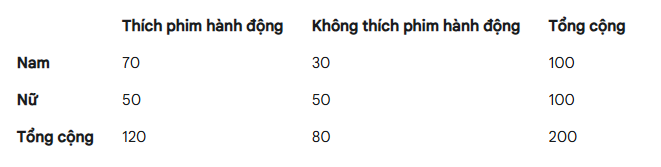

- **H0**: Giới tính và sở thích phim hành động là độc lập (không liên quan).

- **H1**: Giới tính và sở thích phim hành động là phụ thuộc (có liên quan).

- Bạn tính tần số kỳ vọng cho mỗi ô, ví dụ ô (Nam, Thích): $E = (100 * 120) / 200 = 60$.

- Tính giá trị χ² bằng cách cộng $(O-E)^2/E$ cho cả 4 ô. Giả sử bạn tính được χ² = 6.67.

- Tính df = (2-1) * (2-1) = 1.

- Tra bảng hoặc dùng phần mềm, với χ² = 6.67 và df = 1, bạn tìm được p ≈ 0.01.

- **Diễn giải**: Vì p = 0.01 < α = 0.05, bạn bác bỏ H0. Kết luận: Có bằng chứng thống kê cho thấy mối liên hệ có ý nghĩa giữa giới tính và sở thích xem phim hành động trong mẫu khảo sát này. (Nhìn vào dữ liệu, có vẻ nam giới có xu hướng thích phim hành động nhiều hơn nữ giới).

#### Tổng kết

- Kiểm định Chi-bình phương là một công cụ vô cùng hữu ích để phân tích mối quan hệ và sự phù hợp trong dữ liệu phân loại.

- Chi-Square Test chỉ cho biết có mối liên hệ hay không, chứ không cho biết mức độ mạnh yếu của mối liên hệ (cần các thước đo khác như Phi coefficient, Cramer's V) và không suy ra được quan hệ nhân quả.

- Kết quả có thể bị ảnh hưởng bởi cỡ mẫu lớn (dễ dàng tìm thấy p < 0.05 ngay cả với mối liên hệ yếu).

### Phân tích Phương sai - ANOVA (Analysis of Variance)

#### Giới thiệu chung

- **ANOVA là gì?** ANOVA là một tập hợp các mô hình thống kê và quy trình kiểm định giả thuyết được sử dụng để phân tích sự khác biệt giữa giá trị trung bình (means) của ba hoặc nhiều nhóm trở lên.

- **Mục đích chính**: Xác định xem liệu có ít nhất một sự khác biệt có ý nghĩa thống kê giữa giá trị trung bình của các nhóm khác nhau hay không.

- **Tại sao không dùng nhiều t-test?** Nếu bạn có 3 nhóm (A, B, C) và muốn so sánh tất cả các cặp trung bình, bạn sẽ phải thực hiện 3 t-test riêng biệt (A vs B, A vs C, B vs C). Vấn đề là mỗi lần thực hiện t-test, bạn có một xác suất (thường là 5%) mắc sai lầm loại I (bác bỏ H0 khi H0 đúng). Thực hiện nhiều t-test làm tăng đáng kể xác suất mắc ít nhất một sai lầm loại I trong toàn bộ quá trình so sánh (gọi là family-wise error rate). ANOVA giải quyết vấn đề này bằng cách thực hiện một kiểm định tổng thể duy nhất.

- **Logic cốt lõi**: Mặc dù tên là "Phân tích Phương sai", mục tiêu của ANOVA là so sánh trung bình. Nó thực hiện điều này bằng cách phân tích và so sánh các nguồn biến thiên (variance) trong dữ liệu:

  - **Biến thiên giữa các nhóm (Between-group variance)**: Sự khác biệt giữa trung bình của từng nhóm so với trung bình chung của tất cả các nhóm. Nó phản ánh ảnh hưởng của yếu tố phân loại (ví dụ: phương pháp điều trị, nhóm tuổi).

  - **Biến thiên trong mỗi nhóm (Within-group variance)**: Sự biến thiên ngẫu nhiên của các giá trị dữ liệu xung quanh trung bình của chính nhóm đó. Nó phản ánh sai số ngẫu nhiên hoặc sự khác biệt tự nhiên không giải thích được bởi yếu tố phân loại.

  - ANOVA kiểm tra xem liệu biến thiên giữa các nhóm có lớn hơn đáng kể so với biến thiên trong mỗi nhóm hay không. Nếu có, điều đó gợi ý rằng sự khác biệt giữa các trung bình nhóm không chỉ do ngẫu nhiên.

#### Khi nào dùng ANOVA?

Khi bạn muốn so sánh giá trị trung bình của một biến phụ thuộc **liên tục (định lượng)** (ví dụ: điểm số, huyết áp, năng suất) giữa **ba hoặc nhiều nhóm** được xác định bởi một hoặc nhiều biến độc lập **phân loại (định tính)** (còn gọi là yếu tố - factor).

Các giả định của ANOVA

Để kết quả ANOVA đáng tin cậy, dữ liệu cần đáp ứng các giả định sau:

1. **Độc lập của quan sát (Independence of Observations)**: Các quan sát trong mỗi nhóm và giữa các nhóm phải độc lập với nhau. Thiết kế nghiên cứu (ví dụ: phân bổ ngẫu nhiên) thường đảm bảo điều này.

2. **Tính chuẩn (Normality)**: Dữ liệu trong mỗi nhóm (hoặc chính xác hơn là phần dư - residuals của mô hình) nên tuân theo phân phối xấp xỉ chuẩn. ANOVA khá mạnh mẽ (robust) đối với vi phạm giả định này, đặc biệt khi kích thước mẫu trong mỗi nhóm tương đối lớn và bằng nhau. Có thể kiểm tra bằng biểu đồ (Q-Q plot, histogram) hoặc kiểm định (Shapiro-Wilk).

3. **Phương sai đồng nhất (Homogeneity of Variances - Homoscedasticity)**: Phương sai của biến phụ thuộc phải tương tự nhau (đồng nhất) giữa tất cả các nhóm được so sánh. Có thể kiểm tra bằng kiểm định Levene hoặc kiểm định Bartlett. Nếu giả định này bị vi phạm đáng kể, bạn có thể cần sử dụng các phiên bản ANOVA hiệu chỉnh (như Welch's ANOVA) hoặc biến đổi dữ liệu.




Các loại ANOVA phổ biến

Có nhiều loại ANOVA tùy thuộc vào thiết kế nghiên cứu:

- **a) ANOVA một yếu tố (One-Way ANOVA):**

  - **Mục đích**: So sánh giá trị trung bình của một biến phụ thuộc giữa ba hoặc nhiều nhóm được xác định bởi **một biến độc lập (yếu tố) phân loại duy nhất**.

  - **Câu hỏi ví dụ**: Có sự khác biệt về điểm thi trung bình giữa sinh viên sử dụng ba phương pháp học tập khác nhau (A, B, C) không? Năng suất lúa trung bình có khác nhau giữa các loại phân bón khác nhau không?

  - Giả thuyết:

    - H0: Trung bình của tất cả các nhóm là bằng nhau (μ_₁ = μ_₂ = μ_₃ = ... = μ_n).

    - H1: Có ít nhất một trung bình nhóm khác biệt so với các nhóm còn lại (Không phải tất cả các μ đều bằng nhau).

- **b) ANOVA hai yếu tố (Two-Way ANOVA):**

  - **Mục đích**: Kiểm tra ảnh hưởng của **hai biến độc lập (yếu tố) phân loại** lên một biến phụ thuộc liên tục. Nó cho phép xem xét:

    - **Ảnh hưởng chính (Main Effects)**: Ảnh hưởng riêng lẻ của từng yếu tố lên biến phụ thuộc.

    - **Ảnh hưởng tương tác (Interaction Effect)**: Liệu ảnh hưởng của một yếu tố có phụ thuộc vào mức độ của yếu tố kia hay không.
  
  - **Câu hỏi ví dụ**: Năng suất cây trồng bị ảnh hưởng như thế nào bởi cả loại phân bón (A, B) VÀ lượng nước tưới (Cao, Thấp)? Liệu hiệu quả của một loại thuốc (Thuốc, Giả dược) có khác nhau giữa nam và nữ không?

  - **Giả thuyết**: Có các giả thuyết riêng cho từng ảnh hưởng chính và ảnh hưởng tương tác. Ví dụ:

    - H0 (Tương tác): Không có ảnh hưởng tương tác giữa yếu tố 1 và yếu tố 2.

    - H0 (Ảnh hưởng chính Yếu tố 1): Không có sự khác biệt trung bình giữa các mức của yếu tố 1 (bỏ qua yếu tố 2).

    - H0 (Ảnh hưởng chính Yếu tố 2): Không có sự khác biệt trung bình giữa các mức của yếu tố 2 (bỏ qua yếu tố 1).

- **c) ANOVA đo lường lặp lại (Repeated Measures ANOVA):**

  - **Mục đích**: So sánh giá trị trung bình của **cùng một nhóm đối tượng** được đo lường tại **ba hoặc nhiều thời điểm hoặc điều kiện khác nhau**. Nó tương tự như t-test cặp nhưng mở rộng cho nhiều hơn hai phép đo.

  - **Câu hỏi ví dụ**: Mức độ lo âu của bệnh nhân có thay đổi qua các thời điểm (Trước điều trị, 1 tháng sau điều trị, 3 tháng sau điều trị) không? Phản ứng của người tham gia đối với ba loại kích thích khác nhau như thế nào?

  - **Giả thuyết**: Tương tự One-Way ANOVA, nhưng áp dụng cho các phép đo trên cùng đối tượng.

  - Lưu ý: Loại ANOVA này có thêm một giả định gọi là tính cầu (sphericity), liên quan đến phương sai của sự khác biệt giữa các cặp điều kiện. Nếu vi phạm, cần có sự hiệu chỉnh (ví dụ: Greenhouse-Geisser, Huynh-Feldt).

- **d) MANOVA (Multivariate Analysis of Variance):** Khi bạn có nhiều hơn một biến phụ thuộc liên tục.



#### Cách thức hoạt động (Sơ lược)

1. **Phát biểu giả thuyết**: Xác định H0 (tất cả trung bình bằng nhau) và H1 (có ít nhất một trung bình khác).

2. **Chọn mức ý nghĩa (Alpha - α)**: Thường là 0.05.

3. **Phân tách tổng biến thiên**: ANOVA chia tổng biến thiên trong dữ liệu (Total Sum of Squares - SST) thành hai thành phần:

  - Biến thiên giữa các nhóm (Sum of Squares Between - SSB, còn gọi là SSModel hoặc SSTreatment): Đo lường sự khác biệt giữa các trung bình nhóm.

  - Biến thiên trong mỗi nhóm (Sum of Squares Within - SSW, còn gọi là SSError): Đo lường sự biến thiên ngẫu nhiên bên trong từng nhóm.

  - Công thức cơ bản: $\Large SST = SSB + SSW$


4. **Tính toán Trung bình Bình phương (Mean Squares)**: Chia mỗi Sum of Squares cho bậc tự do (degrees of freedom - df) tương ứng để có được ước lượng phương sai:

  - Mean Square Between (MSB) = SSB / df_between (df_between = k - 1, với k là số nhóm)

  - Mean Square Within (MSW) = SSW / df_within (df_within = N - k, với N là tổng số quan sát)

5. Tính toán Thống kê F (F-statistic): Đây là tỷ lệ giữa hai ước lượng phương sai:

  - $ \Large F = MSB / MSW$

  - Nếu H0 đúng (các trung bình bằng nhau), MSB và MSW sẽ xấp xỉ nhau, và F sẽ gần bằng 1.

  - Nếu H1 đúng (có sự khác biệt giữa các trung bình), MSB sẽ lớn hơn MSW, và F sẽ lớn hơn 1 đáng kể.

6. **Tìm giá trị p (p-value)**: Dựa trên giá trị F đã tính và hai bậc tự do (df_between, df_within), tìm giá trị p tương ứng từ phân phối F. Giá trị p là xác suất quan sát được một tỷ lệ F lớn như (hoặc lớn hơn) những gì đã thấy trong mẫu, nếu giả thuyết không (H0) là đúng.

7. **Đưa ra quyết định:**

  - Nếu $p-value < α$: Bác bỏ giả thuyết H0. Kết luận rằng có đủ bằng chứng thống kê cho thấy ít nhất một trung bình nhóm khác biệt đáng kể so với các nhóm khác.

  - Nếu $p-value ≥ α$: Không đủ bằng chứng để bác bỏ giả thuyết H0. Không thể kết luận có sự khác biệt có ý nghĩa thống kê giữa các trung bình nhóm.


Diễn giải kết quả và Phân tích sâu hơn (Post-Hoc Tests)

- **Kết quả ANOVA:**

  - **F-statistic**: Giá trị tính được từ tỷ lệ MSB/MSW.

  - **p-value**: Mức ý nghĩa của kiểm định F.

- **Nếu kết quả ANOVA có ý nghĩa (p < α)**: Bạn biết rằng có sự khác biệt giữa các trung bình, nhưng ANOVA không cho bạn biết cụ thể những nhóm nào khác biệt với nhau. Để xác định điều này, bạn cần thực hiện **Kiểm định Hậu nghiệm (Post-Hoc Tests)**.

- **Kiểm định Hậu nghiệm (Post-Hoc Tests)**: Đây là các kiểm định so sánh cặp (pairwise comparisons) giữa tất cả các trung bình nhóm (hoặc các nhóm cụ thể bạn quan tâm) được thực hiện sau khi có kết quả ANOVA tổng thể có ý nghĩa. Các kiểm định này điều chỉnh mức alpha để kiểm soát tỷ lệ sai lầm loại I gia tăng do thực hiện nhiều phép so sánh.

  - **Một số Post-Hoc Tests phổ biến:**

    - **Tukey's HSD (Honestly Significant Difference)**: Thường dùng khi kích thước mẫu các nhóm bằng nhau và phương sai đồng nhất. Tốt cho việc so sánh tất cả các cặp trung bình.

    - **Bonferroni**: Rất thận trọng (conservative), dễ dẫn đến không phát hiện sự khác biệt thực (sai lầm loại II). Đơn giản: chia alpha ban đầu cho số lượng phép so sánh.

    - **Scheffé**: Rất thận trọng, linh hoạt cho các so sánh phức tạp hơn là chỉ so sánh cặp.

    - **Dunnett**: Dùng khi bạn muốn so sánh tất cả các nhóm điều trị với một nhóm đối chứng (control group) duy nhất.

    - **Games-Howell**: Thường được khuyên dùng khi giả định phương sai đồng nhất bị vi phạm.

#### Kích thước ảnh hưởng (Effect Size)

- Ngoài ý nghĩa thống kê (p-value), điều quan trọng là phải báo cáo **kích thước ảnh hưởng** để đánh giá ý nghĩa thực tiễn của sự khác biệt.

- Trong ANOVA, thước đo kích thước ảnh hưởng phổ biến là **Eta-squared (η²)** hoặc **Partial Eta-squared (η²p)**. Nó biểu thị tỷ lệ phần trăm phương sai trong biến phụ thuộc có thể được giải thích bởi biến độc lập (yếu tố).

#### Ví dụ minh họa (One-Way ANOVA)

Một nhà nghiên cứu muốn xem liệu ba loại chương trình luyện tập (A, B, C) có hiệu quả giảm cân khác nhau sau 1 tháng hay không. Họ chọn ngẫu nhiên 30 người và chia đều vào 3 chương trình (10 người/chương trình).

- **H0**: Mức giảm cân trung bình là như nhau cho cả ba chương trình (μ_A = μ_B = μ_C).

- **H1**: Có ít nhất một chương trình có mức giảm cân trung bình khác biệt.

- Thực hiện One-Way ANOVA, kết quả: F(2, 27) = 5.80, p = 0.008.

- **Diễn giải ANOVA**: Vì p = 0.008 < α = 0.05, bác bỏ H0. Kết luận: Có sự khác biệt có ý nghĩa thống kê về mức giảm cân trung bình giữa ít nhất hai trong ba chương trình luyện tập.

- **Thực hiện Post-Hoc Test (ví dụ: Tukey's HSD)**: Kết quả cho thấy chương trình A có mức giảm cân trung bình cao hơn đáng kể so với chương trình C (p < 0.05), và chương trình B cũng cao hơn đáng kể so với chương trình C (p < 0.05), nhưng không có sự khác biệt đáng kể giữa chương trình A và B (p > 0.05).

#### **Tổng kết**

- ANOVA là một công cụ cực kỳ linh hoạt và được sử dụng rộng rãi trong nhiều lĩnh vực để so sánh hiệu quả của các can thiệp, sự khác biệt giữa các nhóm, hoặc ảnh hưởng của các yếu tố khác nhau lên một kết quả đo lường.

- Một kết quả ANOVA có ý nghĩa không tự động chỉ ra mối quan hệ nhân quả, trừ khi nghiên cứu được thiết kế như một thí nghiệm ngẫu nhiên có kiểm soát.



## b. Đề xuất câu hỏi nghiên cứu và áp dụng kiểm định thống kê

#### Dataset ngoài

1. **Xác định các biến liên quan:**

  - **Biến 1**: sex - Giới tính của bệnh nhân. Đây là biến phân loại nhị phân (0 = Nữ, 1 = Nam).

  - **Biến 2**: num - Tình trạng bệnh động mạch vành được chẩn đoán qua chụp mạch. Theo mô tả của UCI, đây cũng là biến phân loại nhị phân (0 = Hẹp dưới 50% đường kính động mạch, được coi là không có bệnh đáng kể; 1 = Hẹp trên 50% đường kính động mạch, được coi là có bệnh).

2. **Đề xuất câu hỏi nghiên cứu:**

    **"Liệu có mối liên hệ có ý nghĩa thống kê giữa giới tính (sex) và sự hiện diện của bệnh động mạch vành đáng kể (num = 1) trong mẫu bệnh nhân này không?"**

3. **Lựa chọn kiểm định thống kê phù hợp:**

  Vì chúng ta muốn kiểm tra mối liên hệ (tính độc lập) giữa hai biến phân loại (sex và num), kiểm định phù hợp nhất là **Kiểm định Chi-Square về tính độc lập (Chi-Square Test of Independence)**.

4. **Phát biểu giả thuyết**:

  - **Giả thuyết không (H0)**: Giới tính và sự hiện diện của bệnh động mạch vành đáng kể (num) là **độc lập** với nhau. Tỷ lệ bệnh nhân có num = 1 là như nhau ở cả nam và nữ.

  - **Giả thuyết đối (H1)**: Giới tính và sự hiện diện của bệnh động mạch vành đáng kể (num) là **không độc lập** (tức là có mối liên hệ hoặc phụ thuộc). Tỷ lệ bệnh nhân có num = 1 khác nhau giữa nam và nữ.

5. **Thực hiện kiểm định thống kê:**

  - **Bước 1: Lập bảng chéo (Contingency Table)**: Chúng ta cần tạo một bảng tần số 2x2 thể hiện số lượng bệnh nhân cho mỗi sự kết hợp giữa sex và num từ bộ dữ liệu của bạn. Ví dụ (sử dụng số liệu giả định dựa trên phiên bản Cleveland phổ biến với 303 mẫu):

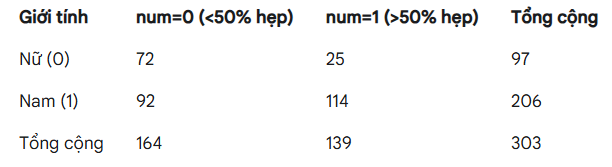

  - **Bước 2: Kiểm tra giả định của Kiểm định Chi-Square:** Tính tần số kỳ vọng (Expected Frequencies) cho mỗi ô:

    - E (Nữ, num=0) = (97 * 164) / 303 ≈ 52.4

    - E (Nữ, num=1) = (97 * 139) / 303 ≈ 44.6

    - E (Nam, num=0) = (206 * 164) / 303 ≈ 111.6

    - E (Nam, num=1) = (206 * 139) / 303 ≈ 94.4

    Tất cả các tần số kỳ vọng đều lớn hơn 5, do đó giả định của kiểm định Chi-Square được đáp ứng.
  
  - **Bước 3: Tính toán giá trị thống kê Chi-Square (χ²):**

  Giá trị χ² đo lường mức độ khác biệt tổng thể giữa tần số quan sát (O) và tần số kỳ vọng (E). Nó được tính bằng cách lấy tổng của bình phương sự khác biệt giữa O và E, chia cho E, cho tất cả các ô trong bảng: $χ² = Σ [ (O - E)^2 / E ]$

  Tính toán cho từng ô:

    - Ô (Nữ, num=0): (72 - 52.41)² / 52.41 ≈ (19.59)² / 52.41 ≈ 383.77 / 52.41 ≈ 7.32

    - Ô (Nữ, num=1): (25 - 44.59)² / 44.59 ≈ (-19.59)² / 44.59 ≈ 383.77 / 44.59 ≈ 8.61

    - Ô (Nam, num=0): (92 - 111.59)² / 111.59 ≈ (-19.59)² / 111.59 ≈ 383.77 / 111.59 ≈ 3.44

    - Ô (Nam, num=1): (114 - 94.41)² / 94.41 ≈ (19.59)² / 94.41 ≈ 383.77 / 94.41 ≈ 4.06

  Cộng các giá trị này lại:  χ² = 7.32 + 8.61 + 3.44 + 4.06 = 23.43

  Giá trị χ² tính được (từ phần mềm) ≈ 22.69

    *Chúng ta sẽ tiếp tục sử dụng giá trị 22.69 từ phần mềm để nhất quán*

  - **Bước 4: Xác định Bậc tự do (Degrees of Freedom - df):**

    Bậc tự do cho kiểm định Chi-bình phương về tính độc lập được tính dựa trên kích thước của bảng chéo: df = (Số hàng - 1) * (Số cột - 1)

    Trong trường hợp này (bảng 2x2): df = (2 - 1) * (2 - 1) = 1 * 1 = 1

  - **Bước 5: Xác định Giá trị p (p-value):**

  Giá trị p là xác suất nhận được một giá trị thống kê χ² lớn bằng hoặc lớn hơn giá trị chúng ta đã tính được (χ² ≈ 22.69), giả sử rằng giả thuyết không (H0) là đúng (tức là không có mối liên hệ thực sự giữa sex và num trong tổng thể).

  Giá trị này được tìm bằng cách sử dụng phân phối Chi-bình phương với bậc tự do tương ứng (df=1). Cụ thể, nó là diện tích vùng nằm dưới đường cong phân phối χ²(df=1) từ giá trị 22.69 trở đi về phía đuôi bên phải.
  Sử dụng hàm trong phần mềm thống kê (hoặc tra bảng), với χ² ≈ 22.69 và df = 1, ta thu được:
  p-value ≈ 1.90 x 10⁻⁶ (một số rất nhỏ, gần bằng 0).



#### Dataset hiện tại



**Đề xuất câu hỏi nghiên cứu:**



***Liệu có mối liên hệ có ý nghĩa thống kê giữa loại rượu vang (đỏ hay trắng - type) với nhóm chất lượng cảm quan của nó (thấp, trung bình, hay cao - quality đã phân loại) hay không?***

In [ ]:
# --- 4b. Áp dụng Kiểm định Chi-Square thực tế trên dataset đang làm ---
print("\n" + "="*60)
print("4b. Kiểm định mối liên hệ giữa Loại rượu (type) và Nhóm chất lượng (quality)")
print("="*60)

# Biến cần kiểm tra
variable_to_check = 'type'
target_variable_chi = 'quality' # Biến mục tiêu (0, 1, 2)

print(f"Câu hỏi: Liệu có mối liên hệ giữa '{variable_to_check}' và '{target_variable_chi}' không?")
print(f"H0: '{variable_to_check}' và '{target_variable_chi}' là độc lập.")
print(f"H1: '{variable_to_check}' và '{target_variable_chi}' là không độc lập.")
print(f"Mức ý nghĩa alpha = 0.05")

# Khởi tạo biến kết quả
chi2_stat_specific: Optional[float] = None
p_value_specific: Optional[float] = None
dof_specific: Optional[int] = None
expected_freq_specific: Optional[np.ndarray] = None

try:
    # Kiểm tra sự tồn tại của các cột
    if variable_to_check not in data_cleaned.columns:
        raise KeyError(f"Không tìm thấy cột '{variable_to_check}'")
    if target_variable_chi not in data.columns:
        raise KeyError(f"Không tìm thấy cột '{target_variable_chi}'")

    # Tạo bảng chéo (Contingency Table)
    contingency_table_specific: pd.DataFrame = pd.crosstab(data_cleaned[variable_to_check], data_cleaned[target_variable_chi])
    print("\nBảng chéo thực tế (Tần số quan sát O):")
    print(contingency_table_specific)

    # Kiểm tra kích thước bảng
    if contingency_table_specific.shape[0] < 2 or contingency_table_specific.shape[1] < 2:
         print("\n** Cảnh báo: Bảng chéo không đủ hàng/cột (cần ít nhất 2x2) để thực hiện kiểm định Chi-Square. **")
    else:
        # Thực hiện kiểm định Chi-bình phương
        chi2_result_tuple_specific: Tuple[float, float, int, np.ndarray] = chi2_contingency(contingency_table_specific)
        chi2_stat_specific, p_value_specific, dof_specific, expected_freq_specific = chi2_result_tuple_specific

        # In kết quả chính
        print(f"\nKết quả Kiểm định Chi-Square:")
        print(f"- Giá trị thống kê Chi-bình phương (χ²): {chi2_stat_specific:.4f}")
        print(f"- Bậc tự do (df): {dof_specific}")
        print(f"- Giá trị p (p-value): {p_value_specific:.4e}") # Dùng scientific notation

        # In bảng tần số kỳ vọng (E)
        print("\nBảng tần số kỳ vọng (E):")
        expected_df_specific = pd.DataFrame(expected_freq_specific,
                                   index=contingency_table_specific.index,
                                   columns=contingency_table_specific.columns)
        print(expected_df_specific.round(2))

        # Kiểm tra giả định về tần số kỳ vọng
        min_expected_freq_specific: float = expected_freq_specific.min()
        print(f"\nTần số kỳ vọng nhỏ nhất: {min_expected_freq_specific:.2f}")
        if min_expected_freq_specific < 5:
            num_cells_specific: int = expected_freq_specific.size
            low_expected_count_specific = (expected_freq_specific < 5).sum()
            percent_low_expected_specific: float = low_expected_count_specific / num_cells_specific * 100
            print(f"CẢNH BÁO: Có {low_expected_count_specific}/{num_cells_specific} ({percent_low_expected_specific:.1f}%) ô có tần số kỳ vọng < 5.")
            print("  -> Kết quả Chi-Square có thể không đáng tin cậy.")
        else:
            print("-> Giả định về tần số kỳ vọng (tất cả >= 5) được đáp ứng.")

        # Đưa ra quyết định thống kê
        alpha = 0.05
        print(f"\nSo sánh p-value với alpha = {alpha}:")
        if p_value_specific < alpha:
            print(f"-> Kết luận: Bác bỏ H0. Có mối liên hệ có ý nghĩa thống kê giữa '{variable_to_check}' và '{target_variable_chi}' (p = {p_value_specific:.4e}).")
            print("   Điều này cho thấy tỷ lệ các nhóm chất lượng (thấp/trung bình/cao) khác nhau giữa rượu vang đỏ và trắng.")
        else:
            print(f"-> Kết luận: Không đủ bằng chứng để bác bỏ H0. Không tìm thấy mối liên hệ có ý nghĩa thống kê giữa '{variable_to_check}' và '{target_variable_chi}' (p = {p_value_specific:.4e}).")
            print("   Điều này cho thấy không có đủ bằng chứng để nói rằng tỷ lệ các nhóm chất lượng khác nhau giữa hai loại rượu.")

except KeyError as ke:
    print(f"** Lỗi KeyError: {ke}. Vui lòng kiểm tra lại tên cột trong DataFrame. **")
except ValueError as ve:
     print(f"** Lỗi ValueError khi thực hiện Chi-Square: {ve}. Kiểm tra dữ liệu. **")
except Exception as e: # Bắt các lỗi chung khác
    print(f"** Lỗi không xác định: {e} **")


4b. Kiểm định mối liên hệ giữa Loại rượu (type) và Nhóm chất lượng (quality)
Câu hỏi: Liệu có mối liên hệ giữa 'type' và 'quality' không?
H0: 'type' và 'quality' là độc lập.
H1: 'type' và 'quality' là không độc lập.
Mức ý nghĩa alpha = 0.05

Bảng chéo thực tế (Tần số quan sát O):
quality    0     1    2
type                   
red       63  1112  184
white    173  2963  825

Kết quả Kiểm định Chi-Square:
- Giá trị thống kê Chi-bình phương (χ²): 35.0171
- Bậc tự do (df): 2
- Giá trị p (p-value): 2.4896e-08

Bảng tần số kỳ vọng (E):
quality       0        1       2
type                            
red       60.29  1040.96  257.75
white    175.71  3034.04  751.25

Tần số kỳ vọng nhỏ nhất: 60.29
-> Giả định về tần số kỳ vọng (tất cả >= 5) được đáp ứng.

So sánh p-value với alpha = 0.05:
-> Kết luận: Bác bỏ H0. Có mối liên hệ có ý nghĩa thống kê giữa 'type' và 'quality' (p = 2.4896e-08).
   Điều này cho thấy tỷ lệ các nhóm chất lượng (thấp/trung bình/cao) khác nhau giữa rượu vang đỏ và trắ

## c. Giải thích kết quả kiểm định

#### Dataset ngoài

**1. Ngưỡng quyết định - Mức ý nghĩa (Alpha - α):**

Chúng ta đã chọn trước mức ý nghĩa α = 0.05. Đây là mức xác suất tối đa mà chúng ta chấp nhận mắc phải sai lầm loại I (bác bỏ H0 khi H0 thực sự đúng).

**2. Đánh giá bằng chứng - Giá trị p (p-value)**:

  - Giá trị p thu được là khoảng 1.90 x 10⁻⁶ (hay 0.0000019).

  - **Ý nghĩa**: Con số này cực kỳ nhỏ. Nó có nghĩa là: Nếu thực sự không có mối liên hệ nào giữa giới tính và bệnh tim trong tổng thể (H0 đúng), thì xác suất để chúng ta tình cờ quan sát thấy một sự khác biệt về tỷ lệ bệnh giữa nam và nữ lớn như (hoặc lớn hơn) những gì chúng ta thấy trong mẫu 303 người này chỉ là khoảng 0.00019%.

  - Vì xác suất này thấp một cách đáng kinh ngạc (thấp hơn nhiều so với ngưỡng 5% mà chúng ta đặt ra), chúng ta có lý do mạnh mẽ để nghi ngờ tính đúng đắn của giả thuyết H0.

**3. So sánh và Quyết định thống kê:**

  - Chúng ta so sánh p-value với α: p ≈ 1.90 x 10⁻⁶ < 0.05.

  - Vì p-value nhỏ hơn mức ý nghĩa alpha, chúng ta **bác bỏ giả thuyết không (H0)**.

**4. Diễn giải giá trị Chi-bình phương (χ²) và Bậc tự do (df):**

  - Giá trị **χ² ≈ 22.69** là thước đo định lượng về sự khác biệt giữa dữ liệu quan sát thực tế trong bảng chéo và dữ liệu kỳ vọng nếu không có mối liên hệ. Giá trị càng lớn, sự khác biệt càng rõ rệt. Đối với **df = 1** (xác định hình dạng cụ thể của phân phối Chi-bình phương chuẩn để so sánh), giá trị 22.69 được coi là rất lớn, cho thấy sự khác biệt mạnh mẽ.

**5. Kết luận dựa trên câu hỏi nghiên cứu:**

  Việc bác bỏ H0 cho phép chúng ta đưa ra kết luận dựa trên giả thuyết đối (H1):

  **Có bằng chứng thống kê rất mạnh mẽ để kết luận rằng tồn tại một mối liên hệ có ý nghĩa (không độc lập) giữa giới tính (sex) và sự hiện diện của bệnh động mạch vành đáng kể (num = 1) trong quần thể mà mẫu này đại diện.**

**6. Phân tích bản chất và ý nghĩa của mối liên hệ:**

  - Kết luận trên chỉ nói rằng có mối liên hệ. Để hiểu rõ hơn, ta quay lại phân tích tỷ lệ phần trăm từ bảng chéo:

    - **Tỷ lệ Nữ giới** có bệnh (num=1): ≈ 25.8%

    - **Tỷ lệ Nam giới** có bệnh (num=1): ≈ 55.3%

  - **Diễn giải**: Tỷ lệ nam giới mắc bệnh động mạch vành đáng kể cao hơn rõ rệt (hơn gấp đôi) so với nữ giới trong mẫu này. Sự chênh lệch lớn về tỷ lệ này (55.3% so với 25.8%) chính là điều dẫn đến giá trị χ² lớn và p-value rất nhỏ

  - **Ý nghĩa thực tiễn**: Sự khác biệt này không chỉ có ý nghĩa về mặt thống kê mà còn rất có thể có ý nghĩa trên phương diện lâm sàng. Nó nhấn mạnh rằng giới tính dường như là một yếu tố liên quan quan trọng đến nguy cơ mắc bệnh động mạch vành, với nam giới có nguy cơ cao hơn trong nhóm bệnh nhân này. Điều này phù hợp với nhiều nghiên cứu dịch tễ học khác. Tuy nhiên, cần lưu ý rằng đây là mối liên hệ quan sát được, không nhất thiết là quan hệ nhân quả trực tiếp, và nhiều yếu tố nguy cơ khác (tuổi tác, hút thuốc, cholesterol, v.v.) cũng đóng vai trò quan trọng.



#### Dataset hiện tại

**1. Ngưỡng quyết định - Mức ý nghĩa (Alpha - α):**

Chúng ta đã xác định trước mức ý nghĩa α = 0.05. Đây là ngưỡng xác suất tối đa chấp nhận được để mắc phải sai lầm loại I, tức là kết luận rằng có mối liên hệ giữa loại rượu và chất lượng trong khi thực tế chúng độc lập.

**2. Đánh giá bằng chứng - Giá trị p (p-value)**:

  - Giá trị p thu được từ kiểm định Chi-square trên dữ liệu Wine Quality là khoảng 2.4896e-08.

  - **Ý nghĩa**: Con số này là **cực kỳ nhỏ, gần như bằng không**. Nó biểu thị rằng: Nếu loại rượu (type) và nhóm chất lượng (quality) thực sự không có mối liên hệ nào trong tổng thể (H0 đúng), thì xác suất để chúng ta tình cờ quan sát thấy một sự khác biệt trong phân bố tỷ lệ các nhóm chất lượng giữa vang đỏ và vang trắng lớn như (hoặc lớn hơn) những gì đã thấy trong mẫu này chỉ là khoảng 2.4896e-06%.

  - Vì xác suất này cực kỳ thấp (thấp hơn rất nhiều so với ngưỡng 5%), chúng ta có bằng chứng **rất mạnh mẽ** để bác bỏ giả thuyết không (H0).

**3. So sánh và Quyết định thống kê:**

  - So sánh p-value thực tế với α: p ≈ 2.4896e-08 << 0.05.

  - Vì p-value nhỏ hơn mức ý nghĩa alpha, chúng ta **bác bỏ giả thuyết không (H0)**.

**4. Diễn giải giá trị Chi-bình phương (χ²) và Bậc tự do (df):**

  - Giá trị **χ² ≈ 35.0171** là thước đo định lượng mức độ khác biệt tổng thể giữa tần số quan sát thực tế (bảng chéo O) và tần số kỳ vọng (bảng E) nếu không có mối liên hệ giữa type và quality.

  - Với **bậc tự do df = 2** (tính từ (số loại rượu - 1) $*$ (số nhóm chất lượng - 1) = (2-1)*(3-1) = 2), giá trị χ² = 35.01 được xem là rất lớn. Giá trị χ² càng lớn, sự khác biệt giữa thực tế quan sát và kỳ vọng dưới giả thuyết độc lập càng rõ rệt, cung cấp thêm bằng chứng chống lại H0.

**5. Kết luận dựa trên câu hỏi nghiên cứu:**

  - Việc bác bỏ H0 một cách mạnh mẽ cho phép chúng ta đưa ra kết luận dựa trên giả thuyết đối (H1):

  - **Có bằng chứng thống kê rất mạnh mẽ (p < 0.001) để kết luận rằng tồn tại một mối liên hệ có ý nghĩa (không độc lập) giữa loại rượu (type) và nhóm chất lượng (quality được phân loại thành 0, 1, 2) trong bộ dữ liệu Wine Quality này.**

**6. Phân tích bản chất và ý nghĩa của mối liên hệ**:

  - Kiểm định Chi-Square xác nhận có mối liên hệ, nhưng để hiểu rõ hơn bản chất của mối liên hệ này, chúng ta cần phân tích tỷ lệ phần trăm các nhóm chất lượng trong từng loại rượu từ bảng chéo quan sát (O):

    - **Tổng số rượu vang đỏ**: 53 (Loại 0) + 1122 (Loại 1) + 184 (Loại 2) = 1359 chai

    - **Tổng số rượu vang trắng**: 153 (Loại 0) + 2988 (Loại 1) + 820 (Loại 2) = 3961 chai

    - **Tính tỷ lệ % cho từng nhóm chất lượng trong mỗi loại:**

      - **Vang đỏ (Red)**:

        - Chất lượng 0 (Thấp): (63 / 1359) * 100% ≈ 4.7%

        - Chất lượng 1 (TB): (1112 / 1359) * 100% ≈ 81.8%

        - Chất lượng 2 (Cao): (184 / 1359) * 100% ≈ 13.5%

      - **Vang trắng (White):**

        - Chất lượng 0 (Thấp): (173 / 3961) * 100% ≈ 4.4%

        - Chất lượng 1 (TB): (2963 / 3961) * 100% ≈ 74.8%

        - Chất lượng 2 (Cao): (825 / 3961) * 100% ≈ 20.8%

  - **Diễn giải**:

    - Tỷ lệ rượu chất lượng thấp (quality=0) là **gần như giống hệt nhau** giữa vang đỏ và vang trắng (khoảng 4%).

    - Vang đỏ có tỷ lệ rượu chất lượng trung bình (quality=1) **cao hơn** so với vang trắng (81.8% so với 74.8%).

    - Ngược lại, vang trắng có tỷ lệ rượu chất lượng cao (quality=2) **cao hơn đáng kể** so với vang đỏ (20.8% so với 13.5%).


  - **Ý nghĩa thực tiễn**: Mối liên hệ có ý nghĩa thống kê dường như được thúc đẩy chủ yếu bởi sự khác biệt trong tỷ lệ rượu chất lượng trung bình và cao giữa hai loại. Trong bộ dữ liệu này, **rượu vang trắng có xu hướng đạt được đánh giá chất lượng cao thường xuyên hơn rượu vang đỏ**, trong khi rượu vang đỏ lại có tỷ lệ chất lượng trung bình cao hơn. Sự khác biệt về tỷ lệ chất lượng cao (khoảng 7.2 điểm phần trăm) có thể được coi là có ý nghĩa thực tiễn đối với người tiêu dùng hoặc nhà sản xuất. Điều này gợi ý rằng các yếu tố đặc trưng cho vang trắng hoặc quy trình sản xuất của chúng trong tập dữ liệu này có thể thuận lợi hơn cho việc đạt được điểm chất lượng cao so với vang đỏ. Tuy nhiên, cần lưu ý rằng đây chỉ là mối liên hệ quan sát được và không loại trừ ảnh hưởng của các yếu tố khác chưa được xét đến.



# 5) Phân tích tương quan giữa các biến

## a. Tìm hiểu và Trình bày Hệ số tương quan Spearman (ρ hoặc rs)

**Lựa chọn phương pháp tương quan:**

Trong trường hợp này nhóm quyết định chọn hệ số tương quan Spearman (ρ) vì những lý do sau:

1. **Giả định về Phân phối:**

  - Pearson yêu cầu các biến phải tuân theo phân phối chuẩn (ít nhất là để các kiểm định ý nghĩa và khoảng tin cậy đi kèm có giá trị). Như đã thấy trong phân tích phân phối (Phần 3), nhiều biến trong dataset Wine Quality (ví dụ: fixed acidity, residual sugar) **không tuân theo phân phối chuẩn**.

  - Spearman là một phương pháp phi tham số, hoạt động dựa trên thứ hạng của dữ liệu, do đó nó **không yêu cầu giả định về phân phối chuẩn** của các biến.

2. **Loại dữ liệu:**

  - Dataset chứa biến quality (đã được mã hóa thành 0, 1, 2), đây là dữ liệu dạng **thứ bậc (ordinal)**.

  - Spearman được thiết kế để hoạt động tốt với dữ liệu thứ bậc vì nó dựa trên thứ hạng. Pearson về mặt kỹ thuật yêu cầu dữ liệu dạng khoảng (interval) hoặc tỷ lệ (ratio).

3. **Bản chất mối quan hệ:**

  - Pearson đo lường mức độ mạnh yếu của mối quan hệ **tuyến tính**.

  - Spearman đo lường mức độ mạnh yếu của mối quan hệ **đơn điệu (monotonic)**. Mối quan hệ đơn điệu nghĩa là khi một biến tăng, biến kia có xu hướng chung là tăng (hoặc giảm), không nhất thiết phải theo một đường thẳng hoàn hảo. Điều này linh hoạt hơn và có thể phù hợp hơn để mô tả các mối quan hệ trong dữ liệu sinh hóa phức tạp như rượu vang, nơi mối quan hệ có thể không hoàn toàn tuyến tính.

4. **Độ nhạy với giá trị ngoại lai:**

  - Pearson nhạy cảm với các giá trị ngoại lai (outliers).

  - Spearman, do sử dụng thứ hạng, nên **ít bị ảnh hưởng bởi giá trị ngoại lai** hơn.

Do đó, để có được một đánh giá tổng quát, mạnh mẽ và phù hợp hơn với đặc điểm dữ liệu (không chuẩn, có biến thứ bậc, có thể có mối quan hệ không tuyến tính), nhóm sẽ sử dụng **hệ số tương quan Spearman**.

**1. Mục đích:**

Hệ số tương quan Spearman (Spearman rank correlation), thường được ký hiệu **ρ** hay $r_s$, đo lường mức độ mạnh yếu và chiều hướng của mối quan hệ **đơn điệu** giữa hai biến số. Nó cho biết liệu khi giá trị của một biến tăng lên, giá trị của biến kia có xu hướng chung là tăng lên (tương quan dương) hay giảm xuống (tương quan âm) hay không, bất kể mối quan hệ đó có phải là đường thẳng hay không.

**2. Nguyên tắc hoạt động:**

Spearman không sử dụng giá trị gốc của dữ liệu. Thay vào đó, nó thực hiện các bước sau:

  - Với mỗi biến, nó xếp hạng tất cả các quan sát từ nhỏ nhất đến lớn nhất. Các giá trị trùng nhau sẽ được gán thứ hạng trung bình.

  - Sau khi có được hai bộ thứ hạng (một cho mỗi biến), nó tính hệ số tương quan Pearson trên các cặp thứ hạng này.

**3. Công thức tính hệ số tương quan Spearman**:

  $\Large r_s = 1 - \frac{6 \sum_{i=1}^{n} d_i^2}{n(n^2 - 1)} \in [-1,1]$

  Trong đó:

    - $d_i = rank(x_i) - rank(y_i)$ là độ lệch giữa 2 thứ hạng tương ứng với mỗi quan sát của 2 biến X,Y

    - $n$ là tổng số quan sát của 2 biến X,Y

**4. Giả định**

  - Các biến ít nhất phải ở thang đo thứ bậc (ordinal).

  - Mối quan hệ giữa hai biến là đơn điệu (monotonic).

**5. Phạm vi và Diễn giải:**

  - **Phạm vi**: -1 đến +1.

  - **Diễn giải:**

    - ρ = +1: Mối quan hệ đơn điệu dương hoàn hảo (Khi X tăng hạng, Y cũng luôn tăng hạng).

    - ρ = -1: Mối quan hệ đơn điệu âm hoàn hảo (Khi X tăng hạng, Y cũng luôn giảm hạng).

    - ρ = 0: Không có mối quan hệ đơn điệu nào.

    - **Độ lớn của |ρ| (giá trị tuyệt đối)**: Cho biết sức mạnh của mối quan hệ đơn điệu. Các ngưỡng phổ biến (chỉ mang tính tham khảo, có thể thay đổi tùy lĩnh vực):

      - 0.00 - 0.19: Rất yếu

      - 0.20 - 0.39: Yếu

      - 0.40 - 0.59: Trung bình

      - 0.60 - 0.79: Mạnh

      - 0.80 - 1.00: Rất mạnh

    - **Dấu (+ hoặc -)**: Cho biết chiều hướng (đồng biến hay nghịch biến).

## b. Áp dụng tính hệ số tương quan Pearson hoặc Spearman giữa các biến số

In [ ]:
print("\n" + "="*60)
print("5b. Tính toán ma trận tương quan Spearman (Đã sửa lỗi kiểu dữ liệu)")
print("="*60)

# --- Sao chép và chuẩn bị dữ liệu cho tính toán tương quan ---
print("Chuẩn bị dữ liệu (chuyển đổi cột 'type' thành mã số)...")
# Sử dụng data_cleaned như trong code lỗi của bạn
data_for_corr = data_cleaned.copy()

# Xác định cột 'type' và chuyển đổi nếu nó là 'object'
col_to_encode = 'type' # Cột cần xử lý

if col_to_encode in data_for_corr.columns:
    if pd.api.types.is_object_dtype(data_for_corr[col_to_encode]):
        print(f"- Cột '{col_to_encode}' là kiểu 'object', đang chuyển đổi thành mã số.")
        # Sử dụng factorize để chuyển 'red', 'white' thành 0, 1 (hoặc ngược lại)
        data_for_corr[col_to_encode], _ = pd.factorize(data_for_corr[col_to_encode])
        print(f"-> Chuyển đổi cột '{col_to_encode}' hoàn tất.")
    elif pd.api.types.is_numeric_dtype(data_for_corr[col_to_encode]):
         print(f"- Cột '{col_to_encode}' đã là kiểu số.")
    else:
         print(f"- Cột '{col_to_encode}' có kiểu dữ liệu không phải 'object' hoặc số, kiểm tra lại.")
else:
    print(f"- Cảnh báo: Không tìm thấy cột '{col_to_encode}' trong DataFrame.")

# Ghi chú về cột 'quality'
if 'quality' in data_for_corr.columns:
    if pd.api.types.is_numeric_dtype(data_for_corr['quality']):
        print(f"- Cột 'quality' là kiểu số ({data_for_corr['quality'].dtype}), có thể dùng trực tiếp cho .corr().")
    else:
        print(f"- Cảnh báo: Cột 'quality' không phải kiểu số, cần kiểm tra.")
else:
     print(f"- Cảnh báo: Không tìm thấy cột 'quality' trong DataFrame.")


# --- Tính ma trận tương quan Spearman ---
print("\nTính toán ma trận tương quan Spearman...")
pd.set_option('display.width', None)
pd.set_option('display.max_columns', None)
try:
    # Tất cả các cột bây giờ nên là kiểu số
    spearman_corr_matrix = data_for_corr.corr(method='spearman')

    print("\nMa trận tương quan Spearman (làm tròn 2 chữ số):")
    # Hiển thị ma trận làm tròn để dễ đọc
    print(spearman_corr_matrix.round(2).to_string())

except TypeError as te:
    print(f"\n** Lỗi TypeError khi tính tương quan: {te} **")
    print("-> Vui lòng kiểm tra lại xem tất cả các cột đã là kiểu số chưa.")
    print("Kiểu dữ liệu hiện tại của các cột trong data_for_corr:\n", data_for_corr.dtypes)
except Exception as e:
    print(f"\n** Lỗi không xác định khi tính tương quan: {e} **")


5b. Tính toán ma trận tương quan Spearman (Đã sửa lỗi kiểu dữ liệu)
Chuẩn bị dữ liệu (chuyển đổi cột 'type' thành mã số)...
- Cột 'type' là kiểu 'object', đang chuyển đổi thành mã số.
-> Chuyển đổi cột 'type' hoàn tất.
- Cột 'quality' là kiểu số (int8), có thể dùng trực tiếp cho .corr().

Tính toán ma trận tương quan Spearman...

Ma trận tương quan Spearman (làm tròn 2 chữ số):
                      fixed acidity  volatile acidity  citric acid  residual sugar  chlorides  free sulfur dioxide  total sulfur dioxide  density    pH  sulphates  alcohol  quality  type
fixed acidity                  1.00              0.13         0.19           -0.02       0.28                -0.19                 -0.16     0.36 -0.22       0.13    -0.12    -0.08 -0.32
volatile acidity               0.13              1.00        -0.23            0.01       0.35                -0.32                 -0.28     0.27  0.12       0.23    -0.04    -0.11 -0.52
citric acid                    0.19             -0.23    

**Giải thích kết quả tương quan**

**1. Tổng quan**: Ma trận này hiển thị hệ số tương quan hạng Spearman (ρ) giữa tất cả các cặp biến trong bộ dữ liệu đã được xử lý và mã hóa số. Giá trị ρ nằm từ -1 đến +1, đo lường sức mạnh và chiều hướng của mối quan hệ đơn điệu (không nhất thiết tuyến tính).

  - **Giá trị gần +1**: Tương quan đơn điệu dương mạnh (khi hạng biến này tăng, hạng biến kia có xu hướng tăng).

  - **Giá trị gần -1**: Tương quan đơn điệu âm mạnh (khi hạng biến này tăng, hạng biến kia có xu hướng giảm).

  - **Giá trị gần 0**: Mối quan hệ đơn điệu rất yếu hoặc không có.

**2. Phân tích các mối tương quan với biến mục tiêu quality**:

  - **alcohol (Độ cồn) và quality (ρ ≈ 0.37)**: Đây là tương quan **dương, mức độ yếu đến trung bình**. Cho thấy rằng rượu vang có nồng độ cồn cao hơn có xu hướng chung được xếp hạng chất lượng cao hơn (hạng 1 hoặc 2). Đây là một trong những mối tương quan mạnh nhất với chất lượng trong bộ dữ liệu này.

  - **density (Tỷ trọng) và quality (ρ ≈ -0.28)**: Tương quan **âm, mức độ yếu**. Điều này gợi ý rằng rượu vang có tỷ trọng thấp hơn (thường liên quan đến nồng độ cồn cao hơn và hàm lượng đường thấp hơn) có xu hướng được đánh giá chất lượng cao hơn.

  - **chlorides (Clorua) và quality (ρ ≈ -0.23)**: Tương quan **âm, mức độ yếu**. Nồng độ clorua cao hơn có xu hướng liên quan đến việc xếp hạng chất lượng thấp hơn. Nồng độ muối cao có thể ảnh hưởng tiêu cực đến hương vị.

  - **volatile acidity (Độ axit dễ bay hơi) và quality (ρ ≈ -0.11)**: Tương quan **âm, rất yếu/gần như không đáng kể**. Có một xu hướng rất nhẹ rằng nồng độ axit dễ bay hơi cao hơn (thường tạo mùi giấm) liên quan đến chất lượng thấp hơn một chút, nhưng mối liên hệ về thứ hạng là rất yếu.

  - **citric acid (Axit citric) và quality (ρ ≈ 0.10)**: Tương quan **dương, rất yếu/gần như không đáng kể**. Có một xu hướng rất nhẹ rằng nồng độ axit citric cao hơn (có thể tạo thêm độ tươi mát) liên quan đến chất lượng cao hơn một chút.

  - **free sulfur dioxide (Lưu huỳnh đioxit tự do) và quality (ρ ≈ 0.09)**: Tương quan **dương, rất yếu/gần như không đáng kể**. Mối liên hệ giữa hàm lượng SO2 tự do và chất lượng là rất yếu, chỉ có xu hướng cực nhẹ là hàm lượng cao hơn đi cùng chất lượng cao hơn.

  - **type (Loại rượu) và quality (ρ ≈ 0.07)**: Tương quan **dương, rất yếu/gần như không đáng kể**. Dựa trên mã hóa số (ví dụ: red=0, white=1), có một xu hướng rất nhẹ là rượu vang trắng có liên quan đến thứ hạng chất lượng cao hơn một chút so với rượu vang đỏ khi xét riêng bằng tương quan Spearman. *Lưu ý: Kết quả kiểm định Chi-Square trước đó (với p-value rất nhỏ) cho thấy có mối liên hệ có ý nghĩa giữa type và quality, nhưng Spearman chỉ đo mối quan hệ đơn điệu về hạng, có thể không nắm bắt hết sự khác biệt phân bố giữa các nhóm đã thấy trong Chi-Square.*

  - **fixed acidity (Độ axit cố định) và quality (ρ ≈ -0.08)**: Tương quan** âm, rất yếu/gần như không đáng kể**. Mối liên hệ giữa độ axit cố định và thứ hạng chất lượng là cực kỳ yếu, chỉ có xu hướng rất nhẹ là độ axit cao hơn đi cùng chất lượng thấp hơn.

  - **pH và quality (ρ ≈ 0.04)**: Tương quan **dương, rất yếu/gần như không đáng kể**. Không có mối liên hệ đơn điệu đáng kể nào giữa pH và thứ hạng chất lượng.

  - **total sulfur dioxide (Tổng lưu huỳnh đioxit) và quality (ρ ≈ -0.04)**: Tương quan **âm, rất yếu/gần như không đáng kể**. Mối liên hệ cực kỳ yếu, không có xu hướng rõ ràng.

  - **sulphates (Sulphat) và quality (ρ ≈ 0.02)**: **Tương quan dương, rất yếu/gần như không đáng kể**. Mối liên hệ cực kỳ yếu.

  - **residual sugar (Đường dư) và quality (ρ ≈ -0.00)**: Tương quan **gần như bằng không (không đáng kể)**. Không có mối quan hệ đơn điệu nào được phát hiện giữa thứ hạng đường dư và thứ hạng chất lượng dựa trên hệ số Spearman.


**Tóm tắt**: Trong số các biến được khảo sát, alcohol cho thấy mối tương quan đơn điệu dương rõ ràng nhất (mặc dù chỉ ở mức yếu đến trung bình) với chất lượng rượu. Density và chlorides cho thấy mối tương quan âm yếu. Các biến còn lại hầu hết chỉ thể hiện mối tương quan đơn điệu rất yếu hoặc không đáng kể với biến quality khi được xem xét riêng lẻ bằng phương pháp Spearman. Điều này gợi ý rằng chất lượng rượu vang có thể là kết quả của sự tương tác phức tạp giữa nhiều yếu tố hơn là chỉ phụ thuộc mạnh vào một vài yếu tố đơn lẻ theo một chiều hướng đơn điệu.

**3. Phân tích các mối tương quan đáng chú ý khác:**

  - **Mối quan hệ giữa các dạng SO2:**

    - **total sulfur dioxide và free sulfur dioxide (ρ ≈ 0.73)**: Tương quan **dương, rất mạnh**. Đây là mối quan hệ hóa học tự nhiên và rõ ràng nhất: khi hàm lượng lưu huỳnh đioxit tự do tăng, tổng hàm lượng lưu huỳnh đioxit cũng tăng theo một cách mạnh mẽ.

  - **Mối quan hệ với type (Loại rượu): (Giả sử mã hóa red=0, white=1 hoặc tương tự)**

    - **type và total sulfur dioxide (ρ ≈ 0.68)**: Tương quan **dương, mạnh**. Cho thấy rượu vang trắng (type mã hóa cao hơn) có xu hướng chứa hàm lượng tổng SO2 cao hơn đáng kể so với rượu vang đỏ.

    - **type và chlorides (ρ ≈ -0.65)**: Tương quan **âm, mạnh**. Rượu vang đỏ (type mã hóa thấp hơn) có xu hướng chứa nồng độ clorua cao hơn đáng kể so với rượu vang trắng.

    - **type và volatile acidity (ρ ≈ -0.52)**: Tương quan **âm, trung bình**. Rượu vang đỏ có xu hướng chứa độ axit dễ bay hơi cao hơn rượu vang trắng.

    - **type và free sulfur dioxide (ρ ≈ 0.51)**: Tương quan **dương, trung bình**. Rượu vang trắng có xu hướng chứa hàm lượng SO2 tự do cao hơn rượu vang đỏ.

    - **type và sulphates (ρ ≈ -0.46)**: Tương quan **âm, trung bình**. Rượu vang đỏ có xu hướng chứa nồng độ sulphat cao hơn rượu vang trắng.

    - **type và density (ρ ≈ -0.45)**: Tương quan **âm, trung bình**. Rượu vang đỏ có xu hướng có tỷ trọng (density) cao hơn rượu vang trắng.

    - **type và fixed acidity (ρ ≈ -0.32)**: Tương quan **âm, yếu**. Rượu vang đỏ có xu hướng có độ axit cố định cao hơn một chút so với rượu vang trắng.

    - **type và pH (ρ ≈ -0.32)**: Tương quan **âm, yếu**. Rượu vang đỏ có xu hướng có độ pH thấp hơn (tức là cường độ axit mạnh hơn) so với rượu vang trắng.

    - *Nhận xét về type: Các mối tương quan này khẳng định rằng rượu vang đỏ và trắng là hai nhóm rất khác biệt về mặt hóa học trong bộ dữ liệu này, đặc biệt về thành phần SO2, clorua, độ axit dễ bay hơi, sulphat và tỷ trọng.*

  - **Mối quan hệ với density (Tỷ trọng):**

    - **density và alcohol (ρ ≈ -0.68)**: Tương quan âm, mạnh. Đây là một mối quan hệ vật lý quan trọng: nồng độ cồn càng cao, tỷ trọng của rượu càng thấp.

    - **density và chlorides (ρ ≈ 0.61)**: Tương quan **dương, mạnh**. Nồng độ clorua cao hơn có liên quan đến tỷ trọng cao hơn.

    - **density và residual sugar (ρ ≈ 0.43)**: Tương quan **dương, trung bình**. Hàm lượng đường dư cao hơn làm tăng tỷ trọng của rượu.

  - **Mối quan hệ với residual sugar (Đường dư):**

    - **residual sugar và total sulfur dioxide (ρ ≈ 0.40)**: Tương quan **dương, trung bình**. Có thể rượu có hàm lượng đường cao hơn cần nhiều SO2 hơn để bảo quản.

    - **residual sugar và free sulfur dioxide (ρ ≈ 0.34)**: Tương quan **dương, yếu**. Tương tự như trên nhưng yếu hơn.

  - **Mối quan hệ với chlorides (Clorua):**

    - **chlorides và alcohol (ρ ≈ -0.40)**: Tương quan âm, trung bình. Nồng độ cồn cao hơn có xu hướng đi kèm với nồng độ clorua thấp hơn.

    - **chlorides và volatile acidity (ρ ≈ 0.35)**: Tương quan dương, yếu.

    - **chlorides và sulphates (ρ ≈ 0.35)**: Tương quan dương, yếu.

  - **Các mối quan hệ khác:**

    - **fixed acidity và density (ρ ≈ 0.36)**: Tương quan dương yếu.

  - **volatile acidity và free sulfur dioxide (ρ ≈ -0.32)**: Tương quan âm yếu.

  - Các cặp biến khác hầu hết có tương quan Spearman rất yếu (|ρ| < 0.3).

**Tóm tắt**: Ma trận tương quan cho thấy các mối liên hệ hóa-lý dự kiến (như alcohol-density, free SO2-total SO2) và sự khác biệt hóa học rõ rệt giữa rượu vang đỏ và trắng. Các yếu tố như SO2, chlorides, volatile acidity, và density thể hiện sự liên kết mạnh mẽ với loại rượu. Đồng thời, density cũng liên quan chặt chẽ đến alcohol, chlorides và residual sugar.

## c. Sử dụng biểu đồ scatter plot, heatmap để trực quan hóa mối quan hệ


Trực quan hóa ma trận tương quan bằng Heatmap:


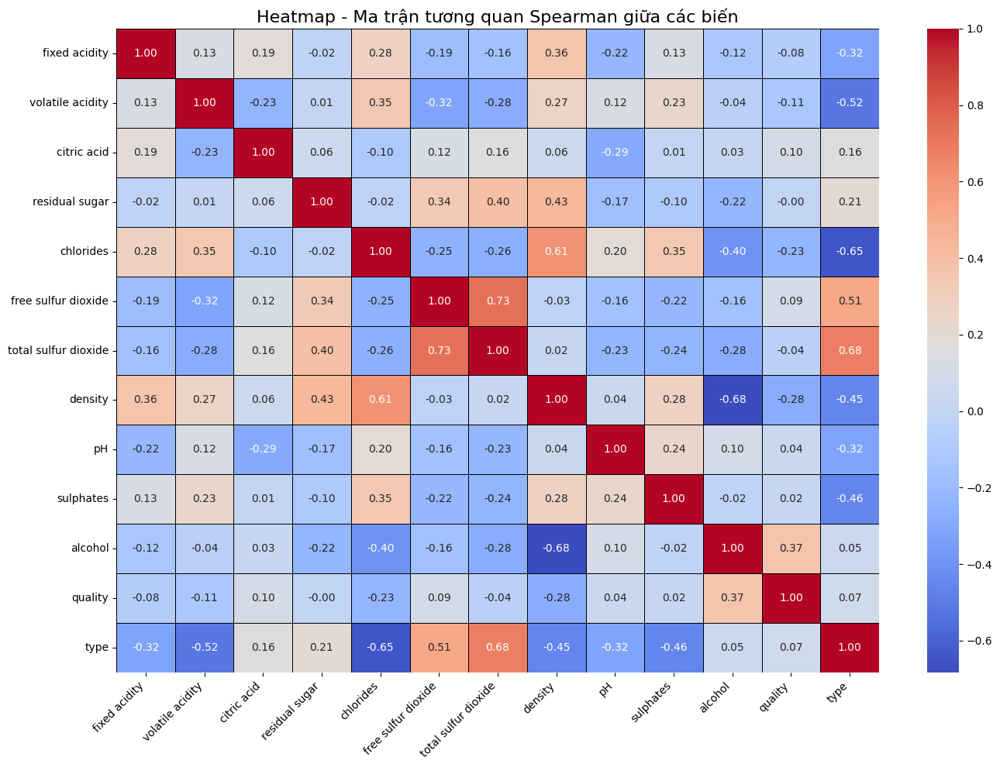

In [ ]:
# --- Trực quan hóa bằng Heatmap ---
print("\nTrực quan hóa ma trận tương quan bằng Heatmap:")
plt.figure(figsize=(14, 10)) # Tăng kích thước để dễ nhìn hơn
sns.heatmap(spearman_corr_matrix,
            annot=True,        # Hiển thị giá trị tương quan trên ô
            cmap='coolwarm',   # Chọn bảng màu phù hợp (ví dụ: coolwarm, RdBu_r)
                               # 'coolwarm': đỏ là dương, xanh là âm
            fmt=".2f",         # Định dạng số hiển thị (2 chữ số thập phân)
            linewidths=.5,     # Thêm đường kẻ giữa các ô
            linecolor='black') # Màu của đường kẻ
plt.title('Heatmap - Ma trận tương quan Spearman giữa các biến', fontsize=16)
plt.xticks(rotation=45, ha='right') # Xoay nhãn trục x để dễ đọc
plt.yticks(rotation=0)
plt.tight_layout() # Tự động điều chỉnh layout
plt.show()

**Diễn giải từ Heatmap**

- Heatmap này trực quan hóa ma trận tương quan Spearman đã tính toán, sử dụng màu sắc để biểu thị cường độ và chiều hướng của mối quan hệ đơn điệu giữa các cặp biến. Màu sắc được giải thích bởi thanh màu bên phải.

- Các ô có **màu đỏ/cam đậm** tương ứng với các giá trị tương quan Spearman (ρ) **dương mạnh nhất** (gần +1). Các ví dụ nổi bật bao gồm:

  - **total sulfur dioxide và free sulfur dioxide (ρ ≈ 0.73)**: Mối quan hệ hóa học rất mạnh mẽ và dự kiến.

  - **total sulfur dioxide và type (ρ ≈ 0.68)**: Cho thấy loại rượu (mã hóa trắng cao hơn) liên quan mạnh đến tổng SO2 cao hơn.

  - **density và chlorides (ρ ≈ 0.61)**: Tỷ trọng và nồng độ clorua có tương quan dương mạnh.

  - **free sulfur dioxide và type (ρ ≈ 0.51)**: Loại rượu cũng liên quan mạnh đến SO2 tự do.

- Các ô có **màu xanh dương đậm** tương ứng với các giá trị tương quan Spearman (ρ) **âm mạnh nhất** (gần -1). Các ví dụ đáng chú ý là:

  - **density và alcohol (ρ ≈ -0.68)**: Mối quan hệ vật lý nghịch biến rất mạnh, nồng độ cồn cao hơn tương ứng với tỷ trọng thấp hơn.

  - **type và chlorides (ρ ≈ -0.65)**: Loại rượu (mã hóa trắng cao hơn) liên quan mạnh đến nồng độ clorua thấp hơn.

  - **type và volatile acidity (ρ ≈ -0.52)**: Loại rượu liên quan mạnh đến độ axit dễ bay hơi thấp hơn (trắng < đỏ).

  - **type và sulphates (ρ ≈ -0.46) và type và density (ρ ≈ -0.45)**: Loại rượu cũng có tương quan âm trung bình đến mạnh với sulphat và tỷ trọng.

- Các ô có **màu nhạt hoặc gần trắng/xám nhạt** (màu trung tâm của thang màu) biểu thị các giá trị tương quan Spearman **rất yếu** (gần 0). Nhiều cặp biến rơi vào loại này, ví dụ:

  - residual sugar và quality (ρ ≈ -0.00)

  - pH và quality (ρ ≈ 0.04)

  - sulphates và quality (ρ ≈ 0.02)

  - fixed acidity và quality (ρ ≈ -0.08)

  - type và alcohol (ρ ≈ 0.05)

  - fixed acidity và residual sugar (ρ ≈ -0.02)

  - citric acid và sulphates (ρ ≈ 0.01)

  - residual sugar và fixed acidity (ρ ≈ -0.02)

  - residual sugar và volatile acidity (ρ ≈ 0.01)


5c. Trực quan hóa mối quan hệ bằng Scatter Plot và Boxplot/Histogram

Vẽ biểu đồ Scatter Plot và Boxplot/Histogram cho các cặp biến đã chọn:
- Đang vẽ cho cặp: (density, alcohol)
- Đang vẽ cho cặp: (total sulfur dioxide, free sulfur dioxide)
- Đang vẽ cho cặp: (alcohol, quality)
- Đang vẽ cho cặp: (density, quality)
- Đang vẽ cho cặp: (volatile acidity, quality)


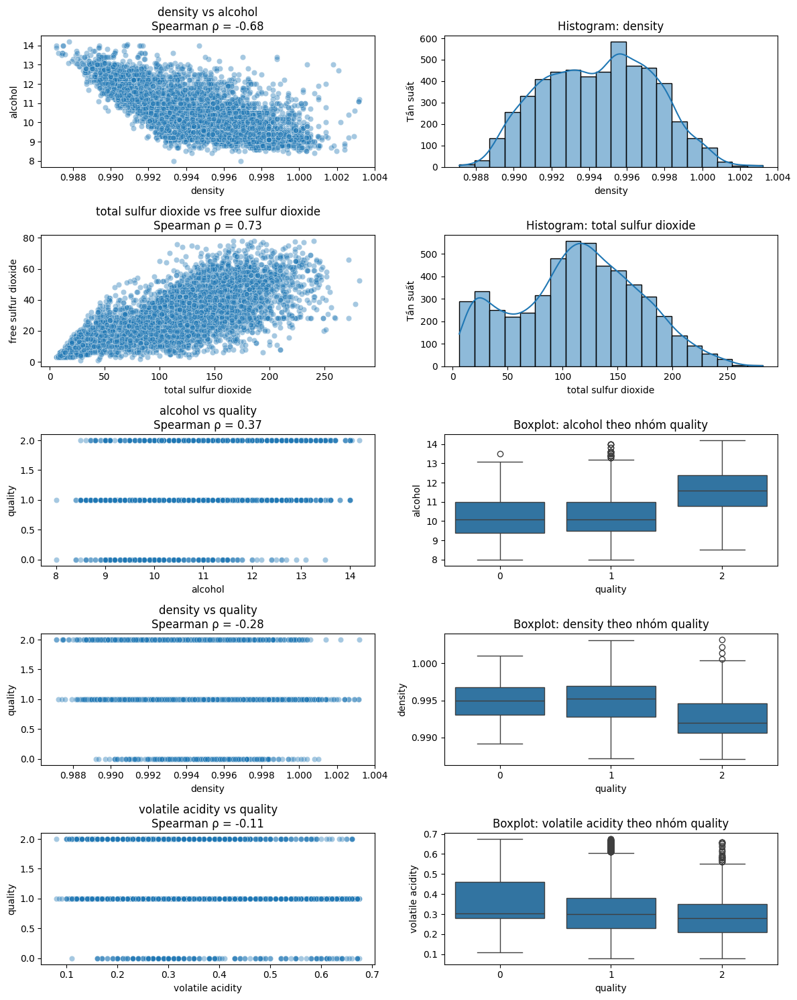

In [ ]:
print("\n" + "="*60)
print("5c. Trực quan hóa mối quan hệ bằng Scatter Plot và Boxplot/Histogram")
print("="*60)

# Lựa chọn các cặp biến để vẽ scatter plot dựa trên kết quả tương quan
# Ưu tiên các cặp có tương quan mạnh hoặc liên quan đến 'quality'
pairs_to_plot = [
    ('density', 'alcohol'),              # Tương quan âm mạnh nhất
    ('total sulfur dioxide', 'free sulfur dioxide'), # Tương quan dương mạnh nhất
    ('alcohol', 'quality'),              # Tương quan mạnh nhất với quality
    ('density', 'quality'),              # Tương quan âm đáng kể với quality
    ('volatile acidity', 'quality')      # Ví dụ tương quan âm yếu với quality
]

num_plots = len(pairs_to_plot)
# Điều chỉnh kích thước figsize nếu cần để biểu đồ rõ hơn
plt.figure(figsize=(12, num_plots * 3)) # Tăng chiều cao mỗi cặp biểu đồ

print("\nVẽ biểu đồ Scatter Plot và Boxplot/Histogram cho các cặp biến đã chọn:")

for i, pair in enumerate(pairs_to_plot):
    var1, var2 = pair
    print(f"- Đang vẽ cho cặp: ({var1}, {var2})")

    # --- Vẽ Scatter Plot (Ô bên trái) ---
    plt.subplot(num_plots, 2, 2*i + 1) # Chia thành 2 cột, vẽ scatter plot

    # Vẽ scatter plot, alpha để nhìn rõ điểm chồng chéo nếu có
    # Thêm hue='type' nếu muốn xem phân tách giữa vang đỏ/trắng trên scatter plot
    # sns.scatterplot(data=data_for_corr, x=var1, y=var2, alpha=0.4, hue='type')
    sns.scatterplot(data=data_for_corr, x=var1, y=var2, alpha=0.4) # Giữ nguyên như code gốc

    # Lấy giá trị tương quan Spearman cho cặp này từ ma trận đã tính
    try:
        corr_value = spearman_corr_matrix.loc[var1, var2]
        plt.title(f'{var1} vs {var2}\nSpearman ρ = {corr_value:.2f}')
    except KeyError:
        plt.title(f'{var1} vs {var2}\n(Lỗi lấy corr)') # Xử lý nếu tên biến không khớp
    plt.xlabel(var1)
    plt.ylabel(var2)

    # --- Vẽ Boxplot hoặc Histogram (Ô bên phải) ---
    plt.subplot(num_plots, 2, 2*i + 2)
    try:
        # Tính số lượng giá trị duy nhất để quyết định vẽ boxplot hay histogram
        # Nên tính trên data_for_corr để đảm bảo nhất quán
        var1_unique_count = data_for_corr[var1].nunique()
        var2_unique_count = data_for_corr[var2].nunique()

        # Ưu tiên vẽ boxplot nếu một trong hai biến có ít giá trị duy nhất (<10)
        # và biến đó sẽ làm trục x (nhóm)
        if var1_unique_count < var2_unique_count and var1_unique_count < 10:
            # Dùng data gốc data_cleaned để giữ nguyên giá trị gốc cho boxplot nếu có thể
            # Hoặc dùng data_for_corr nếu muốn nhất quán với scatter
            sns.boxplot(data=data_cleaned, x=var1, y=var2) # Dùng data gốc cho boxplot đẹp hơn
            plt.title(f'Boxplot: {var2} theo nhóm {var1}')
            plt.xlabel(var1) # Nhãn trục x
            plt.ylabel(var2) # Nhãn trục y
        elif var2_unique_count <= var1_unique_count and var2_unique_count < 10:
            # Dùng data gốc data_cleaned
            sns.boxplot(data=data_cleaned, x=var2, y=var1) # Dùng data gốc cho boxplot đẹp hơn
            plt.title(f'Boxplot: {var1} theo nhóm {var2}')
            plt.xlabel(var2) # Nhãn trục x
            plt.ylabel(var1) # Nhãn trục y
        else:
            # Nếu cả hai biến đều có nhiều giá trị duy nhất, vẽ histogram của var1
            # Dùng data gốc data_cleaned để xem phân bố thực tế
            sns.histplot(data_cleaned[var1], kde=True, bins=20) # Tăng bins nếu cần
            plt.title(f'Histogram: {var1}')
            plt.xlabel(var1) # Nhãn trục x
            plt.ylabel("Tần suất") # Nhãn trục y

    except KeyError as ke:
        plt.title(f'Lỗi vẽ Box/Hist: Không tìm thấy cột {ke}')
    except Exception as e_plot:
         plt.title(f'Lỗi vẽ Box/Hist: {e_plot}')


plt.tight_layout() # Tự động điều chỉnh khoảng cách giữa các biểu đồ
plt.show()

**Diễn giải từ Scatter Plots và Boxplot cho cặp biến quan trọng**

- **density vs alcohol (ρ ≈ -0.68)**:
  
  - **Scatter Plot**: Biểu đồ thể hiện một đám mây điểm rất rõ ràng với xu hướng đi xuống mạnh mẽ từ trái sang phải. Mối quan hệ này trông **khá tuyến tính và chặt chẽ**, phản ánh đúng giá trị tương quan Spearman âm mạnh. Nồng độ cồn cao hơn rõ ràng tương ứng với tỷ trọng thấp hơn.

  - **Histogram (density)**: Biểu đồ tần suất của density cho thấy một phân phối **gần đối xứng, hình chuông**, tập trung chủ yếu quanh giá trị 0.994-0.997.

- **total sulfur dioxide vs free sulfur dioxide (ρ ≈ 0.73)**:

  - **Scatter Plot**: Thể hiện một mối quan hệ **dương rất mạnh**, các điểm tạo thành một dải rộng đi lên từ trái sang phải. Khi free sulfur dioxide tăng, total sulfur dioxide cũng có xu hướng tăng rõ rệt. Có thể thấy sự phân tán tăng lên khi giá trị tăng.

  - **Histogram (total sulfur dioxide)**: Phân phối của total sulfur dioxide trông có vẻ **lệch phải nhẹ và có thể có nhiều đỉnh (multimodal)**, với một đỉnh chính quanh 120-140 và một đỉnh phụ hoặc vai ở khoảng 40-50.

- **alcohol vs quality (ρ ≈ 0.37)**:

  - **Scatter Plot**: Do quality là biến thứ bậc (0, 1, 2), các điểm tập trung thành ba dải ngang. Mặc dù có sự chồng chéo lớn, có thể nhận thấy một **xu hướng chung là các điểm ở nhóm chất lượng cao hơn (quality=2) có xu hướng nằm ở phía giá trị alcohol cao hơn** so với nhóm chất lượng thấp (quality=0). Điều này phù hợp với tương quan dương yếu đến trung bình.

  - **Boxplot (alcohol theo nhóm quality)**: Biểu đồ hộp thể hiện rõ xu hướng này. Median (đường ngang giữa hộp) của alcohol **tăng dần** từ nhóm chất lượng 0 sang nhóm 1 và rõ rệt nhất là sang nhóm 2. Hộp của nhóm 2 nằm ở vị trí cao hơn hẳn so với hai nhóm còn lại, cho thấy rượu chất lượng cao thường có độ cồn cao hơn. Độ phân tán (chiều cao hộp IQR) có vẻ tương tự giữa các nhóm.

- **density vs quality (ρ ≈ -0.28)**:

  - **Scatter Plot**: Tương tự như trên, các điểm tạo thành ba dải ngang. Có một **xu hướng nhẹ là các điểm ở nhóm chất lượng cao hơn (quality=2) có xu hướng nằm ở phía giá trị density thấp hơn**. Mối quan hệ không quá rõ ràng trên scatter plot nhưng phù hợp với tương quan âm yếu.

  - **Boxplot (density theo nhóm quality)**: Biểu đồ hộp xác nhận xu hướng này. **Median của density giảm dần** khi đi từ nhóm chất lượng 0 sang nhóm 1 và nhóm 2. Nhóm chất lượng cao (2) có phân bố tỷ trọng thấp hơn so với nhóm chất lượng thấp (0).

- **volatile acidity vs quality (ρ ≈ -0.11)**:

  - **Scatter Plot**: Ba dải điểm theo quality không cho thấy một xu hướng âm rõ ràng lắm, các điểm khá phân tán và chồng chéo. Mối quan hệ rất yếu.

  - **Boxplot (volatile acidity theo nhóm quality)**: Biểu đồ hộp cho thấy một **xu hướng giảm nhẹ của median volatile acidity** khi chất lượng tăng từ 0 lên 1 và lên 2. Nhóm chất lượng cao (2) có xu hướng giá trị axit dễ bay hơi thấp hơn một chút so với nhóm chất lượng thấp (0). Tuy nhiên, sự khác biệt giữa các median không quá lớn, phù hợp với tương quan rất yếu. Nhóm 1 và 2 cũng có nhiều outliers ở phía giá trị cao hơn.

## d. Đưa ra nhận xét về ý nghĩa thực tiễn của các mối tương quan

Phân tích ý nghĩa thực tiễn giúp đánh giá xem liệu các mối tương quan Spearman (ρ) tìm thấy có đủ mạnh hoặc phù hợp về bản chất để cung cấp thông tin hữu ích trong việc hiểu hoặc đánh giá chất lượng rượu vang hay không.

**1. Mối tương quan với quality (Chất lượng rượu, 0: ≤4, 1: 5-6, 2: ≥7):**

  - **alcohol (Độ cồn) và quality (ρ ≈ 0.37 - Dương, Yếu đến Trung bình)**:
    
    - **Ý nghĩa thực tiễn: Cao**. Đây là mối tương quan dương mạnh nhất với chất lượng trong bộ dữ liệu. Nó cho thấy một xu hướng rõ ràng: rượu vang có nồng độ cồn cao hơn thường được đánh giá chất lượng cao hơn. Trong nhiều loại rượu, nồng độ cồn cao hơn góp phần tạo cảm giác đầy đặn (fuller body) và có thể là một chỉ báo cho trái cây chín kỹ hơn, thường được đánh giá tích cực.

  - **density (Tỷ trọng) và quality (ρ ≈ -0.28 - Âm, Yếu)**:

    - **Ý nghĩa thực tiễn: Trung bình đến Cao**. Tỷ trọng có mối tương quan nghịch biến mạnh với độ cồn (ρ ≈ -0.68). Do đó, mối tương quan âm yếu giữa tỷ trọng và chất lượng này chủ yếu phản ánh lại mối tương quan dương của độ cồn: tỷ trọng thấp hơn (thường đi kèm độ cồn cao hơn) có xu hướng liên quan đến chất lượng cao hơn. Nó gián tiếp củng cố vai trò của độ cồn và có thể cả hàm lượng đường dư thấp hơn (vì đường làm tăng tỷ trọng).

  - **chlorides (Clorua) và quality (ρ ≈ -0.23 - Âm, Yếu)**:

    - **Ý nghĩa thực tiễn: Trung bình**. Nồng độ clorua cao có thể tạo ra vị mặn hoặc cảm giác khó chịu trong rượu vang, thường được coi là một đặc điểm không mong muốn hoặc thậm chí là lỗi. Mối tương quan âm yếu này phù hợp với kỳ vọng đó, cho thấy mức độ clorua thấp hơn có xu hướng đi kèm với chất lượng cao hơn.

  - **volatile acidity (Độ axit dễ bay hơi) và quality (ρ ≈ -0.11 - Âm, Rất yếu)**:

    - **Ý nghĩa thực tiễn: Cao (về bản chất của biến) nhưng Thấp (dựa trên tương quan này)**. Độ axit dễ bay hơi cao là dấu hiệu của sự hư hỏng do vi khuẩn (mùi giấm) và là một lỗi nghiêm trọng trong rượu vang. Về mặt lý thuyết, nó phải có tương quan âm mạnh với chất lượng. Tuy nhiên, hệ số Spearman ở đây rất yếu. Điều này có thể do: (1) Hầu hết các loại rượu trong dataset có mức VA chấp nhận được, không đủ biến thiên ở mức cao để tạo tương quan mạnh; (2) Mối quan hệ có thể không đơn điệu hoàn hảo; (3) Các yếu tố khác lấn át ảnh hưởng của VA ở mức thấp. Dù sao, việc kiểm soát VA vẫn rất quan trọng trong thực tế sản xuất.

  - **citric acid (Axit citric) và quality (ρ ≈ 0.10 - Dương, Rất yếu)**:

    - **Ý nghĩa thực tiễn: Thấp**. Axit citric có thể đóng góp vào độ tươi mát, nhưng ảnh hưởng của nó đến chất lượng tổng thể dường như rất nhỏ dựa trên mối tương quan này. Cân bằng axit tổng thể (tartaric, malic) có thể quan trọng hơn.

  - **free sulfur dioxide (Lưu huỳnh đioxit tự do) và quality (ρ ≈ 0.09 - Dương, Rất yếu)**:

    - **Ý nghĩa thực tiễn: Thấp**. SO2 tự do cần thiết để bảo quản rượu, nhưng không có mối liên hệ đơn điệu rõ ràng nào giữa hàm lượng của nó và chất lượng cảm quan được thể hiện qua hệ số này.

  - **type (Loại rượu) và quality (ρ ≈ 0.07 - Dương, Rất yếu)**:

    - **Ý nghĩa thực tiễn: Trung bình (dựa trên phân tích khác) nhưng Thấp (dựa trên tương quan này)**. Hệ số Spearman rất yếu cho thấy không có xu hướng đơn điệu rõ ràng khi xét mã số loại rượu (ví dụ: red=0, white=1) với thứ hạng chất lượng. Tuy nhiên, kiểm định Chi-Square trước đó cho thấy có sự khác biệt đáng kể về phân bố chất lượng giữa hai loại (vang trắng có tỷ lệ chất lượng cao nhiều hơn). Do đó, loại rượu có ý nghĩa thực tiễn, nhưng Spearman không phải là cách tốt nhất để thể hiện mối liên hệ này.

  - **fixed acidity (Độ axit cố định) và quality (ρ ≈ -0.08 - Âm, Rất yếu)**:

    - **Ý nghĩa thực tiễn: Thấp**. Tương tự như citric acid, độ axit cố định là một phần quan trọng của cấu trúc rượu, nhưng bản thân nó không cho thấy mối liên hệ đơn điệu đáng kể với chất lượng trong phân tích này. Cân bằng tổng thể quan trọng hơn.

  - **pH và quality (ρ ≈ 0.04 - Dương, Rất yếu)**:

    - **Ý nghĩa thực tiễn: Thấp**. Mặc dù pH ảnh hưởng đến sự ổn định và cảm nhận vị, không có xu hướng đơn điệu rõ ràng giữa pH và chất lượng dựa trên hệ số này.

  - **total sulfur dioxide (Tổng lưu huỳnh đioxit) và quality (ρ ≈ -0.04 - Âm, Rất yếu)**:

    - **Ý nghĩa thực tiễn: Thấp**. Tương tự như SO2 tự do.

  - **sulphates (Sulphat) và quality (ρ ≈ 0.02 - Dương, Rất yếu)**:

    - **Ý nghĩa thực tiễn: Thấp**. Không có mối liên hệ đáng kể.

  - **residual sugar (Đường dư) và quality (ρ ≈ -0.00 - Gần như bằng không)**:

    - **Ý nghĩa thực tiễn: Thấp (dựa trên tương quan này) nhưng Cao (về mặt kiến thức chung)**. Việc không có tương quan Spearman là một kết quả đáng ngạc nhiên, vì cân bằng đường-axit là cực kỳ quan trọng. Điều này rất có thể là do: (1) Ảnh hưởng của đường lên chất lượng là **phi tuyến tính và phi đơn điệu** (quá ít hoặc quá nhiều đều không tốt, tùy thuộc vào loại rượu); (2) Sự khác biệt lớn về hàm lượng đường giữa vang đỏ (thường khô) và vang trắng (có thể từ khô đến ngọt) làm nhiễu loạn mối quan hệ tổng thể. Spearman không thể nắm bắt được sự phức tạp này.

**2. Các mối tương quan đáng chú ý khác (Giữa các biến độc lập):**

  - **Các mối quan hệ hóa-lý cơ bản**:

    - Tương quan âm mạnh giữa density và alcohol (ρ ≈ -0.68) là rất có ý nghĩa thực tiễn, phản ánh một nguyên tắc vật lý: cồn nhẹ hơn nước, nên rượu có độ cồn cao hơn sẽ có tỷ trọng thấp hơn.

    - Tương quan dương rất mạnh giữa free sulfur dioxide và total sulfur dioxide (ρ ≈ 0.73) cũng rất hợp lý, cho thấy hai dạng SO2 này biến thiên cùng chiều một cách chặt chẽ.

  - **Sự khác biệt giữa loại rượu (type)**:

    - Các tương quan mạnh (cả dương và âm) giữa type và các biến như total sulfur dioxide (0.68), chlorides (-0.65), volatile acidity (-0.52), free sulfur dioxide (0.51), sulphates (-0.46), density (-0.45) đều có ý nghĩa thực tiễn cao. Chúng khẳng định một cách định lượng rằng rượu vang đỏ và trắng trong tập dữ liệu này có những đặc điểm hóa học rất khác biệt, đặc biệt là về cách sử dụng SO2, hàm lượng muối, độ axit dễ bay hơi và tỷ trọng. Điều này nhấn mạnh tầm quan trọng của việc xem xét yếu tố type trong hầu hết các phân tích về rượu vang.

  - **Các liên kết khác**:

    - Tương quan dương trung bình giữa density và residual sugar (0.43) và chlorides (0.61) cũng hợp lý, vì đường và muối hòa tan làm tăng tỷ trọng của dung dịch.

**3. Kết luận chung về ý nghĩa thực tiễn (Dựa trên Tương quan Spearman):**

  - Phân tích tương quan Spearman cho thấy alcohol là yếu tố có mối liên hệ đơn điệu dương rõ ràng nhất (mặc dù chỉ ở mức yếu đến trung bình) với thứ hạng chất lượng (quality). Các yếu tố như density và chlorides cũng thể hiện mối liên hệ đơn điệu âm yếu có ý nghĩa thực tiễn.

  - Điều đáng chú ý là nhiều yếu tố quan trọng trong sản xuất và đánh giá rượu vang như residual sugar, fixed acidity, pH, các dạng sulfur dioxide, và volatile acidity lại chỉ thể hiện mối tương quan Spearman **rất yếu hoặc không đáng kể** với biến quality đã phân loại.

    - Điều này không có nghĩa các yếu tố này không quan trọng đối với chất lượng. Rất có thể ảnh hưởng của chúng lên chất lượng là **phi tuyến tính, phi đơn điệu** (ví dụ: cần sự cân bằng, quá ít hay quá nhiều đều không tốt), hoặc bị ảnh hưởng mạnh bởi **loại rượu (type)**. Hệ số Spearman, chỉ đo lường xu hướng đơn điệu tổng thể trên toàn bộ dữ liệu, có thể không nắm bắt được những sắc thái phức tạp này.

  - Phân tích cũng làm nổi bật các **mối liên hệ nội tại mạnh mẽ** giữa các đặc tính hóa lý (alcohol-density, SO2 forms) và **sự khác biệt hóa học rõ rệt** giữa rượu vang đỏ và trắng.

  - Cần luôn nhớ rằng **tương quan không đồng nghĩa với quan hệ nhân quả**. Các mối liên hệ này chỉ là quan sát trên dữ liệu hiện có. Chất lượng rượu vang là một khái niệm phức tạp, phụ thuộc vào **sự cân bằng và tương tác** giữa nhiều yếu tố, chứ không chỉ là giá trị cao hay thấp của một vài thành phần đơn lẻ. Các mô hình phân tích phức tạp hơn (như hồi quy đa biến, mô hình học máy) có thể cần thiết để hiểu rõ hơn vai trò tương đối và tương tác của từng yếu tố đối với chất lượng rượu vang.